# Controlling Freddie Mercury 
**5 parameters**

**1.01.2024**

Author **Paweł Kruczkiewicz**

----------



## 0. Introduction

*aka Comments, comments, comments...*

### Changing the dataset creating script

I have changed script for creating the dataset. Previously it has only deviated with given parameters one by one, which in turn made the GAN vulnerable to mode collapse. Now the script produces all the possible combinations of parameters (*Kartezian cross*) with a given step. This vastly enhances the number of possible combinations and makes the GAN more robust. Unfortunatelly there is no free lunch - the number of all possible combinations is too big to be produced in a reasonable amount of time. Therefore I have decided to step with each parameter that can range from 0 to 255 not by 1 but 32. This way we have 256/32 = 8 possible values for each parameter. For 5 parameters it gives us...

In [1]:
 8**5

 


32768

...possible combinations. It is still a lot but it is doable. For the script it took about 4-5 hours to produce them all. Probably the script could be optimized but this is not a priority now. 

### The dataset on the aforementioned script

The dataset takes about ...


In [2]:
from pathlib import Path

FOLDER = "/media/pawel/DATA/tmp/freddie_mercuries/many_genes_at_a_time"
print(Path(FOLDER).exists())
png_paths = list(Path(FOLDER).rglob("**/*.png"))

number_of_pngs = len(png_paths)
one_png_size = Path(png_paths[0]).stat().st_size
total_size = sum([Path(png).stat().st_size for png in png_paths])

print(f"Number of png images: {number_of_pngs}")
print(f"One png image size: {one_png_size / 10**6 :.2f} MB")

print(f"Total size of all png images: {total_size / 10**6 :.2f} MB")


True


Number of png images: 32768
One png image size: 0.03 MB
Total size of all png images: 866.64 MB


The dataset is not the best in the world and is still has bugs (for some reason the names of the items are offset by one). But it is good enough for the model to train,

The model this time is Freddie Mercury since the face similarity models were working best for him (according to the results of Pracownia Problemowa). 


![Freddie Mercury CK III](img/from_dataset/perfect_mercury.png)


In [3]:
import matplotlib.pyplot as plt

def plot_min_and_max_image(min_img_path: str, max_img_path: str, save_path=None, title="") -> None:
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    fig.suptitle(title)
    for ax, img_path, name in zip(axes, [min_img_path, max_img_path], ["min", "max"]):
        img = plt.imread(img_path)
        ax.imshow(img)
        ax.set_title(name)
        ax.set_axis_off()
    if save_path:
        plt.savefig(save_path, bbox_inches="tight")
    plt.show()
    




I've picked 5 parameters that I think are easily recognizable both by a person and a face recognition algorithm. These are:
1. Eye distance.
2. Eye hight.
3. Eye angle.
4. Jaw width.
5. Jaw height.

The most extreme values for each parameter (when all the others are in the middle 228) look as follows:

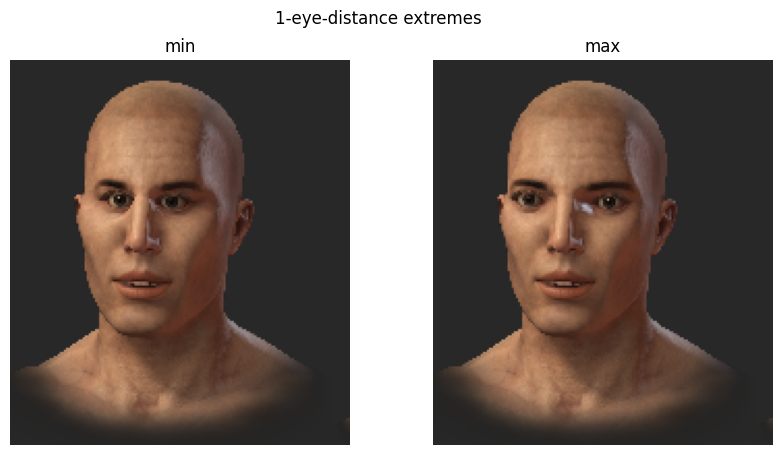

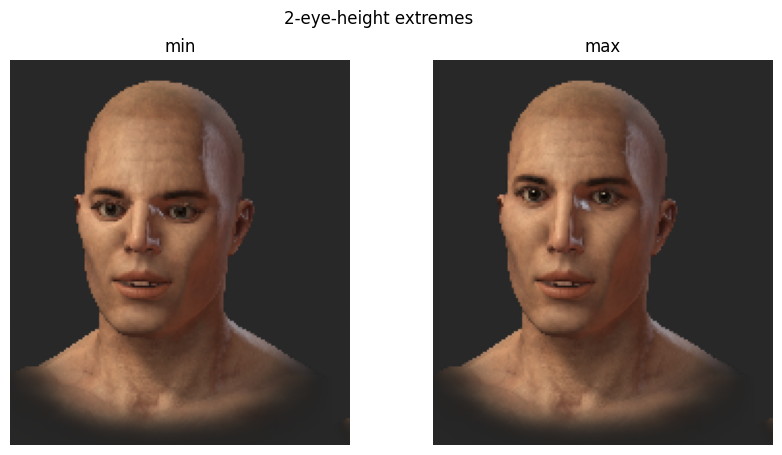

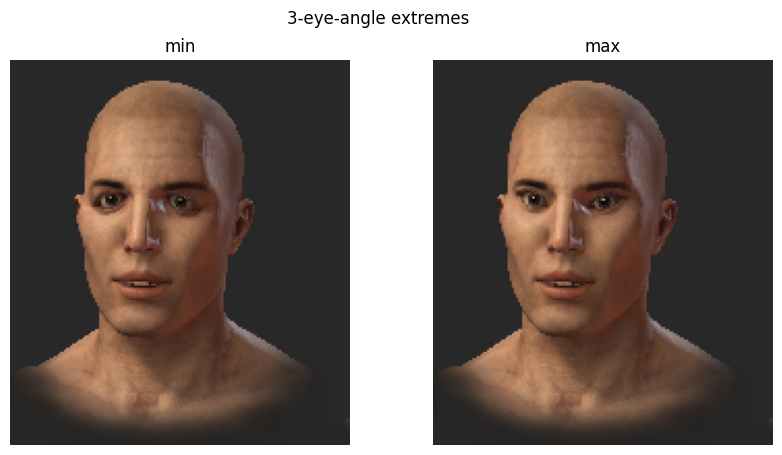

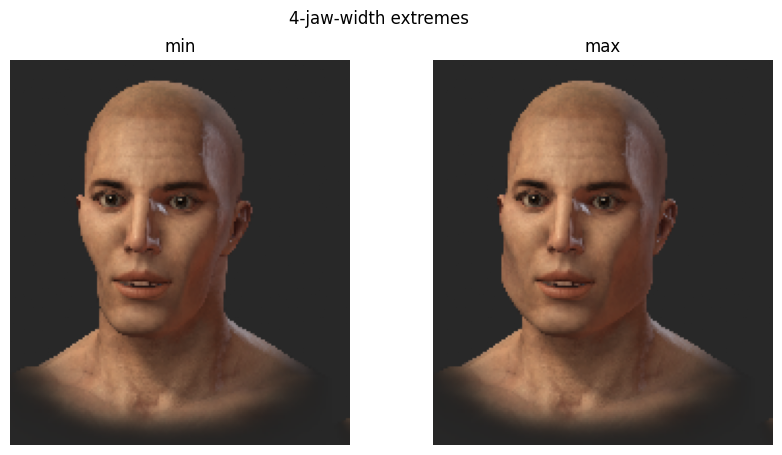

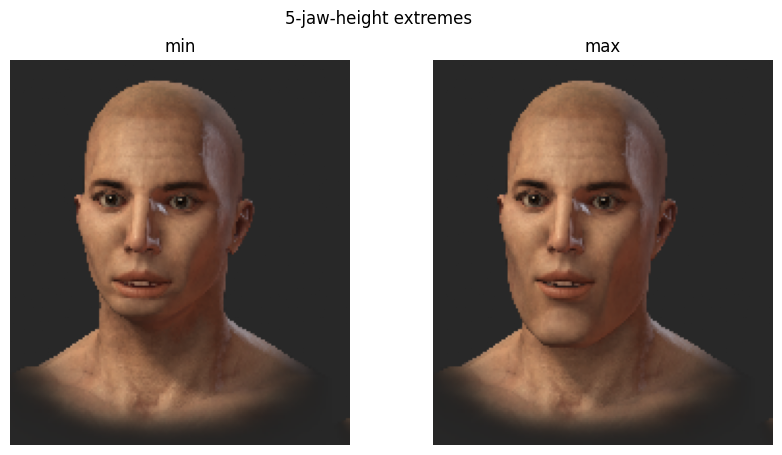

In [4]:
from pathlib import Path

ROOT_PARAMETERS_FOLDER = "img/from_dataset/parameters"
parameter_subfolders = sorted([folder for folder in Path(ROOT_PARAMETERS_FOLDER).glob("*") if folder.is_dir()])

for subfolder in parameter_subfolders:
    min_image_path = subfolder / "min.png"
    max_image_path = subfolder / "max.png"
    title = f"{subfolder.name} extremes"
    save_image_path = subfolder / "both.png"
    
    plot_min_and_max_image(min_image_path, max_image_path, save_image_path, title)

### And the model trained on the aforementioned dataset:)

After about 13 h of training (only 7000 iterations -- I have a relatively slow GPU) the model has produced some interesting results. Here is a sample:

![Generated Freddie Mercuries](img/generated/mercury_sample.jpg)


The shape of the face was pretty easy for the generator to mimic. After about few hundred of iterations possible jaw width and hights were visible in the samples. The biggest problem was wih the eyes which were hard to train by the GAN. I connect it with a fact that it is very detailed and varies greatly among the models in the dataset. Althought different eye hights and distances can be spotted on the sample the eye angle is not. Based on that I hypothesize the latter parameter may be hard to control. The results are not perfect but they are good enough for now.


### Loading the model

Loaded model can yield a random Freddie Mercury image. Example below.

In [5]:
from lightweight_gan import LightweightGAN
import torch
import numpy as np

MODEL_PATH = Path("model/model_mercury_5_param.pt")
LATENT_DIM = 256
IMG_SIZE = 256

def import_generator(model_filepath: Path) -> torch.nn.Module:
    model = torch.load(model_filepath)
    
    gan = LightweightGAN(latent_dim=LATENT_DIM,
                         image_size=IMG_SIZE, 
                         attn_res_layers=[32],
                         freq_chan_attn=False)
    gan.load_state_dict(model["GAN"], strict=False)
    gan.eval()

    return gan.G

def prep_tensor_to_show(tensor):
    return tensor.permute(1, 2, 0).detach().to('cpu').numpy()

def show_tensor_picture(tensor, title=""):
    im_arr = prep_tensor_to_show(tensor)
    plt.title(title)
    plt.axis("off")
    plt.imshow((im_arr*255).astype(np.uint8))


generator = import_generator(MODEL_PATH)
# print(generator)   In case of emergency diff check with the original evaluation
## TODO save only the generator, not the whole model

random_latent_vectors = torch.randn( (1, LATENT_DIM) ).cuda(0)
generated_images = generator(random_latent_vectors)
show_tensor_picture(generated_images[0], title="Random Freddie Mercury")

/home/pawel/Documents/studia/magisterka/CKTinderator/venv/lib/python3.11/site-packages/torch/cuda/__init__.py:138: UserWarning: CUDA initialization: CUDA unknown error - this may be due to an incorrectly set up environment, e.g. changing env variable CUDA_VISIBLE_DEVICES after program start. Setting the available devices to be zero. (Triggered internally at ../c10/cuda/CUDAFunctions.cpp:108.)
  return torch._C._cuda_getDeviceCount() > 0


AssertionError: You need to have an Nvidia GPU with CUDA installed.

## 1. Can I control the parameters?

### Middle values

First I have found tried with a face with all the parameters having the middle value (128). The original looks like this:

![Freddie Mercury CK III](img/from_dataset/middle_mercury.png)



In [ ]:
from PIL import Image
from torchvision.transforms import v2

def prep_image(filename)-> torch.tensor:
    image = Image.open(filename).convert("RGB")
    image_min_size = min(image.size)
    transforms = v2.Compose([
        v2.ToImage(),
        v2.CenterCrop(image_min_size),
        v2.Resize((IMG_SIZE, IMG_SIZE), antialias=True),
        v2.ToDtype(torch.float32, scale=True)
    ])
    return transforms(image).cuda(0)


def plot_images(images, labels, nrows, ncols, step=1, title="", figsize=[8, 4]):
    """Plot nrows x ncols images from images and set labels as titles."""
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
    for i, ax in enumerate(axes.flat):
        idx = i * step
        if images[i].shape[-1] == 1:
            ax.imshow((255*images[i]).reshape(images[idx].shape[0], images[idx].shape[1]).astype(np.uint8))
        else:
            ax.imshow((255*images[idx]).astype(np.uint8))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(labels[idx])
    fig.suptitle(title)
    plt.tight_layout()
    plt.show()


In [ ]:
def find_z(exemplary_photo,  generator, iterations=100, lr=5, checkpoint_step=10, z_init=None):
    z = torch.randn( (1, LATENT_DIM), requires_grad=True, device="cuda") \
        if z_init is None else z_init
    y_target = exemplary_photo

    criterion = torch.nn.MSELoss()
    optimizer = torch.optim.SGD([z], lr=lr, momentum=0.9)

    checkpoints = []
    losses = []
    for i in range(iterations):
        y_pred = generator(z)[0]
        loss = criterion(y_target, y_pred)

        if i % checkpoint_step == 0:
            checkpoints.append((i, y_pred.detach().permute((1,2,0)).cpu().numpy()))
            losses.append(loss.item())
            print(f"Iteration: {i}, loss: {loss.item():.2E}")
            
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    return z, checkpoints, losses



In [ ]:
middle_image = prep_image("img/from_dataset/middle_mercury.png")

middle_z, middle_checkpoints, middle_losses = find_z(middle_image, generator, iterations=1000, lr=1, checkpoint_step=100)


Iteration: 0, loss: 1.37E-03
Iteration: 100, loss: 8.34E-04
Iteration: 200, loss: 7.31E-04
Iteration: 300, loss: 5.58E-04
Iteration: 400, loss: 5.21E-04
Iteration: 500, loss: 5.17E-04
Iteration: 600, loss: 5.15E-04
Iteration: 700, loss: 5.14E-04
Iteration: 800, loss: 5.14E-04
Iteration: 900, loss: 5.14E-04


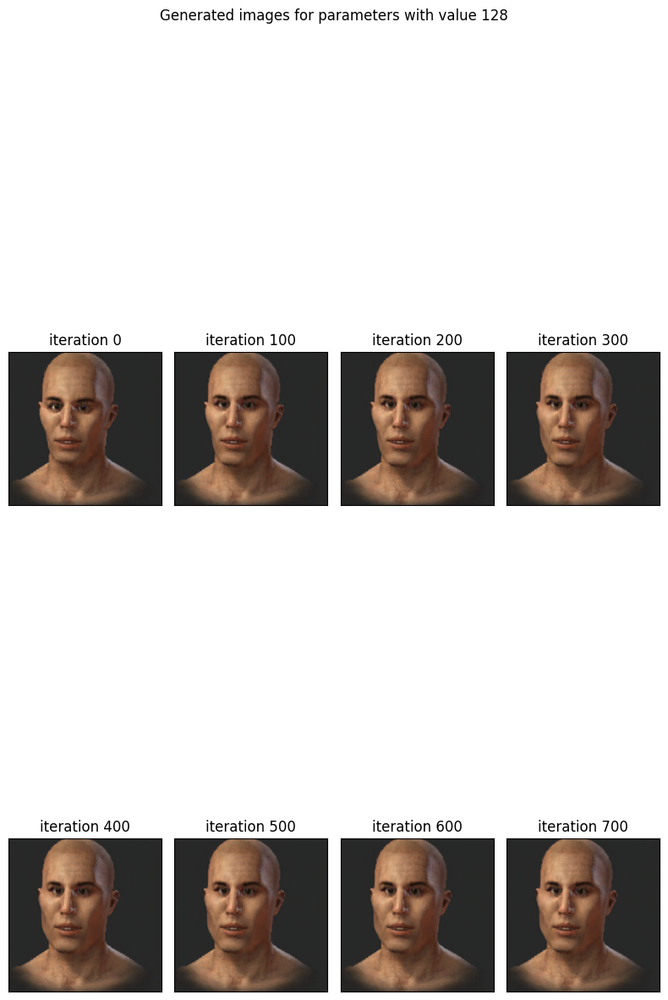

In [ ]:
plot_images([checkpoint for _, checkpoint in middle_checkpoints],
            [f"iteration {checkpoint_n}" for checkpoint_n, _ in middle_checkpoints],
            nrows=len(middle_checkpoints)//4, ncols=4,
            title="Generated images for parameters with value 128", figsize=[8, 16])

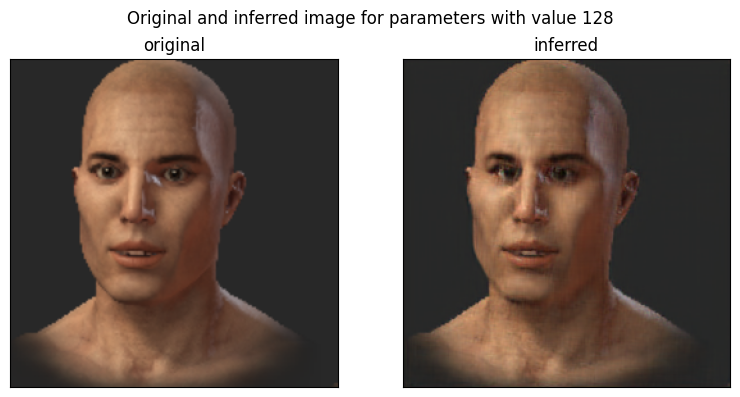

In [ ]:
original_middle_image = prep_tensor_to_show(prep_image("img/from_dataset/middle_mercury.png"))
inffered_middle_image = prep_tensor_to_show(generator(middle_z)[0])

plot_images([original_middle_image, inffered_middle_image], ["original", "inferred"], nrows=1, ncols=2, title="Original and inferred image for parameters with value 128", figsize=[8, 4])



In [ ]:
def plot_loss(losses, iterations, title=""):
    plt.plot(iterations, losses)
    plt.title(title)
    plt.xlabel("Iteration")
    plt.ylabel("Loss")
    plt.ylim(bottom=0, top=1.1*max(losses))
    plt.show()
    


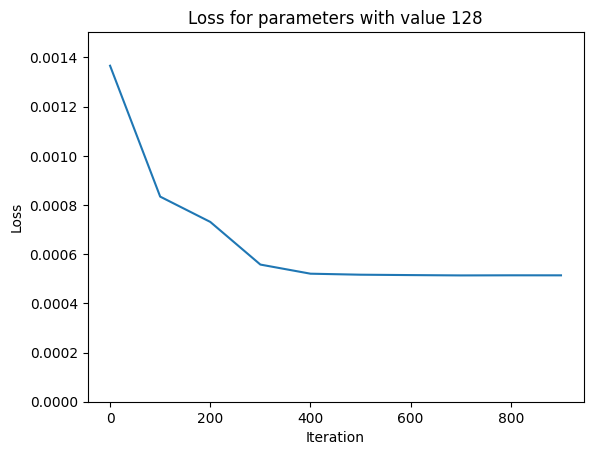

In [ ]:
plot_loss(middle_losses, [i for i, _ in middle_checkpoints], title="Loss for parameters with value 128")

### Parameters one by one

Now we will use the found *middle_z* as a starting point for finding all the different *extreme* values of parameters. We will change one parameter at a time and leave the others at the middle value. The results are presented below.

In [ ]:

def prepare_plots_per_param(param_name, real_image_tensor, generator=generator, z_init=None, lr=1, iterations=2000, checkpoint_step=100):
    print(f"Parameter: {param_name}")
    show_tensor_picture(real_image_tensor, title=f"Original image for {param_name}")
    print("Searching for z...")
    z, checkpoints, losses = find_z(real_image_tensor, generator, z_init=z_init,
                                    lr=lr, iterations=iterations, checkpoint_step=checkpoint_step)
    
    print("Plotting results...")
    plot_images([checkpoint for _, checkpoint in checkpoints], 
                [f"iteration {checkpoint_n}" for checkpoint_n, _ in checkpoints], 
                nrows=2, ncols=len(checkpoints)//2, title=f"Generated images for {param_name}", figsize=[16, 4])

    original_image = prep_tensor_to_show(real_image_tensor)
    inffered_image = prep_tensor_to_show(generator(z)[0])
    plot_images([original_image, inffered_image], ["original", "inferred"], nrows=1, ncols=2, 
                title=f"Original and inferred image for {param_name}", figsize=[8, 4])
    
    plot_loss(losses[:], [i for i, _ in checkpoints], title=f"Loss for {param_name}")
    print("-----------------------------------")
    
    return z, checkpoints, losses


In [ ]:

parameter_subfolders = sorted([folder for folder in Path(ROOT_PARAMETERS_FOLDER).glob("*") if folder.is_dir()])

param_names = [f"{subfolder.name} {type}" for subfolder in parameter_subfolders for type in ("min", "max")]
min_and_max_image_tensors = [prep_image(subfolder / f"{type}.png") for subfolder in parameter_subfolders for type in ("min", "max")]
min_and_max_images = [prep_tensor_to_show(tensor) for tensor in min_and_max_image_tensors]

z_init = middle_z.detach().clone()

# plot_images(min_and_max_images, param_names, nrows=5, ncols=2, title="Min and max real images", figsize=[4, 8])


#### Eye distance



Parameter: 1-eye-distance min
Searching for z...
Iteration: 0, loss: 5.87E-04


Iteration: 100, loss: 5.86E-04
Iteration: 200, loss: 5.87E-04
Iteration: 300, loss: 5.86E-04
Iteration: 400, loss: 5.87E-04
Iteration: 500, loss: 5.86E-04
Iteration: 600, loss: 5.86E-04
Iteration: 700, loss: 5.87E-04
Iteration: 800, loss: 5.86E-04
Iteration: 900, loss: 5.86E-04
Plotting results...


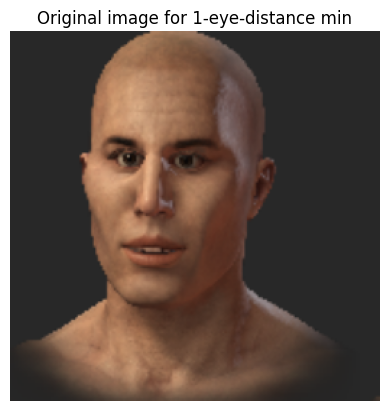

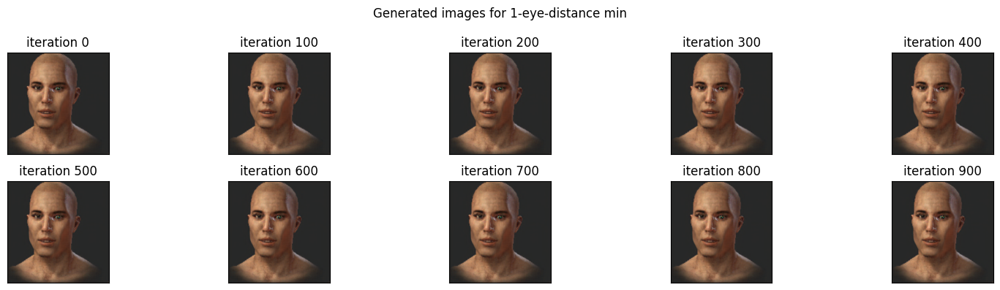

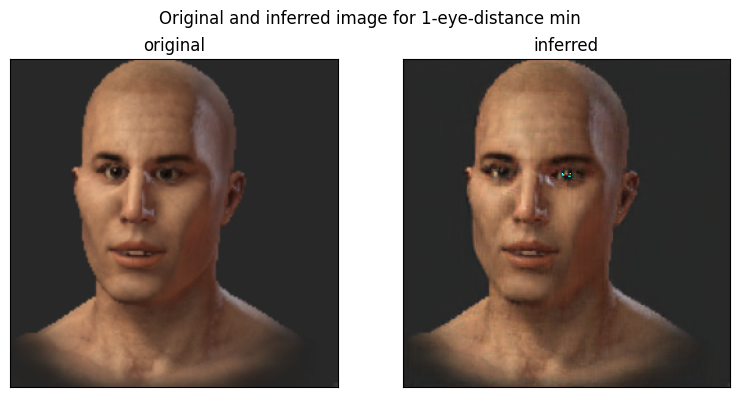

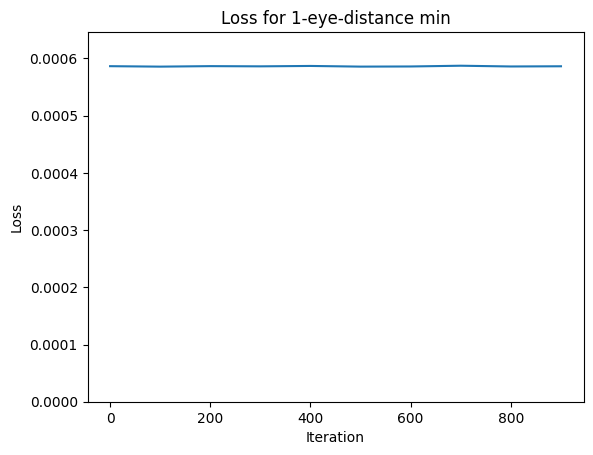

-----------------------------------


(tensor([[-3.4651e-01, -1.8610e+00, -3.6883e-01, -2.1845e-03, -1.8308e-01,
          -4.8795e-02,  6.9290e-01, -9.2188e-01,  1.1443e+00,  6.8912e-01,
          -3.2256e-01,  1.9447e+00,  1.7723e+00,  6.8802e-01, -2.0691e+00,
           1.0704e+00, -4.4615e-01, -4.0849e-01, -4.0204e-01, -8.7545e-01,
           8.5396e-01, -5.4908e-01,  2.3717e-01, -2.1771e-01,  2.6005e-01,
          -7.4699e-01,  2.8021e-02,  1.0770e-01, -4.7663e-01, -5.5307e-01,
           1.1053e+00, -7.3717e-03, -2.2625e+00,  1.1042e+00, -5.3702e-02,
          -7.0914e-01, -2.5311e-01, -9.8863e-01,  1.2841e+00, -2.7455e-01,
          -1.6597e+00, -8.6879e-01,  5.6336e-02, -1.0202e+00,  1.2505e+00,
          -1.7718e-01, -7.6437e-01, -8.5182e-01, -2.5340e-01, -5.5074e-01,
          -6.6475e-01, -6.5588e-01, -9.9575e-01, -7.0786e-01,  2.1303e-01,
          -1.7712e-01, -1.0141e+00,  5.2202e-01,  2.0735e-01, -5.4124e-01,
           2.8727e-01, -5.7002e-01, -3.7280e-01,  1.8376e+00, -4.8038e-01,
          -3.6423e-01, -2

In [ ]:
prepare_plots_per_param(param_names[0], min_and_max_image_tensors[0], z_init,  iterations=1000)

Parameter: 1-eye-distance max
Searching for z...
Iteration: 0, loss: 4.78E-04
Iteration: 100, loss: 4.78E-04
Iteration: 200, loss: 4.78E-04
Iteration: 300, loss: 4.78E-04
Iteration: 400, loss: 4.78E-04
Iteration: 500, loss: 4.77E-04
Iteration: 600, loss: 4.77E-04
Iteration: 700, loss: 4.78E-04
Iteration: 800, loss: 4.78E-04
Iteration: 900, loss: 4.78E-04
Plotting results...


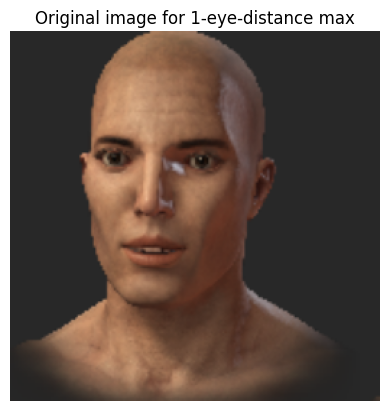

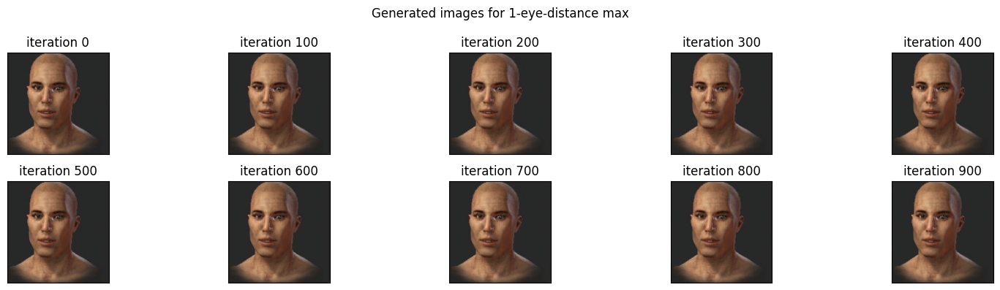

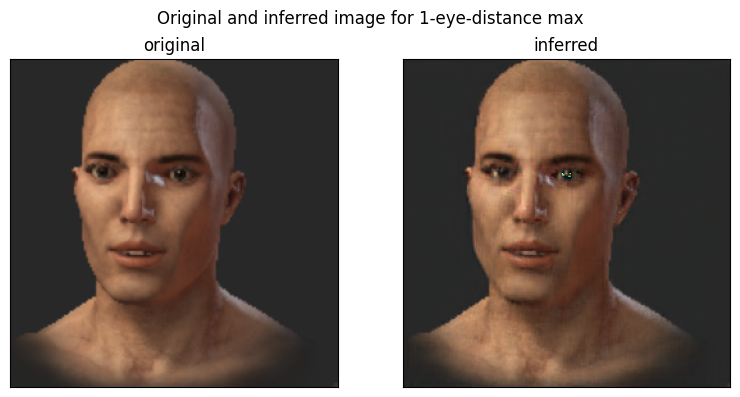

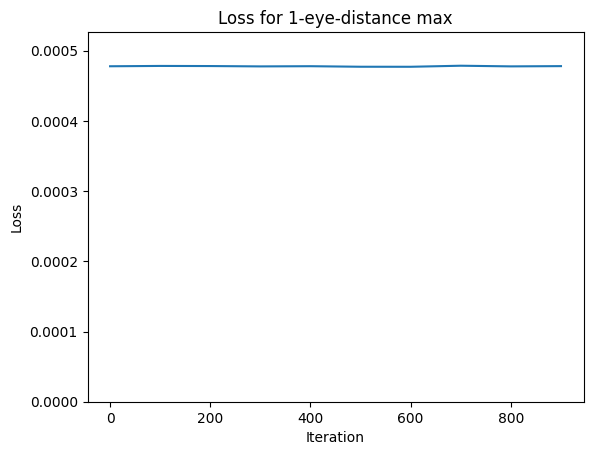

-----------------------------------


(tensor([[-3.4651e-01, -1.8610e+00, -3.6883e-01, -2.1845e-03, -1.8308e-01,
          -4.8795e-02,  6.9290e-01, -9.2188e-01,  1.1443e+00,  6.8912e-01,
          -3.2256e-01,  1.9447e+00,  1.7723e+00,  6.8802e-01, -2.0691e+00,
           1.0704e+00, -4.4615e-01, -4.0849e-01, -4.0204e-01, -8.7545e-01,
           8.5396e-01, -5.4908e-01,  2.3717e-01, -2.1771e-01,  2.6005e-01,
          -7.4699e-01,  2.8021e-02,  1.0770e-01, -4.7663e-01, -5.5307e-01,
           1.1053e+00, -7.3717e-03, -2.2625e+00,  1.1042e+00, -5.3702e-02,
          -7.0914e-01, -2.5311e-01, -9.8863e-01,  1.2841e+00, -2.7455e-01,
          -1.6597e+00, -8.6879e-01,  5.6336e-02, -1.0202e+00,  1.2505e+00,
          -1.7718e-01, -7.6437e-01, -8.5182e-01, -2.5340e-01, -5.5074e-01,
          -6.6475e-01, -6.5588e-01, -9.9575e-01, -7.0786e-01,  2.1303e-01,
          -1.7712e-01, -1.0141e+00,  5.2202e-01,  2.0735e-01, -5.4124e-01,
           2.8727e-01, -5.7002e-01, -3.7280e-01,  1.8376e+00, -4.8038e-01,
          -3.6423e-01, -2

In [ ]:
prepare_plots_per_param(param_names[1], min_and_max_image_tensors[1], z_init,  iterations=1000)

#### Eye height



Parameter: 2-eye-hight min
Searching for z...
Iteration: 0, loss: 1.49E-03
Iteration: 100, loss: 1.49E-03
Iteration: 200, loss: 1.49E-03
Iteration: 300, loss: 1.49E-03
Iteration: 400, loss: 1.49E-03
Iteration: 500, loss: 1.49E-03
Iteration: 600, loss: 1.49E-03
Iteration: 700, loss: 1.49E-03
Iteration: 800, loss: 1.49E-03
Iteration: 900, loss: 1.48E-03
Plotting results...


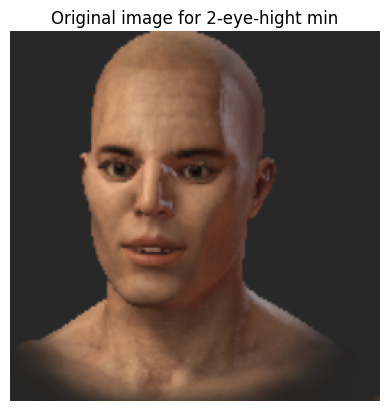

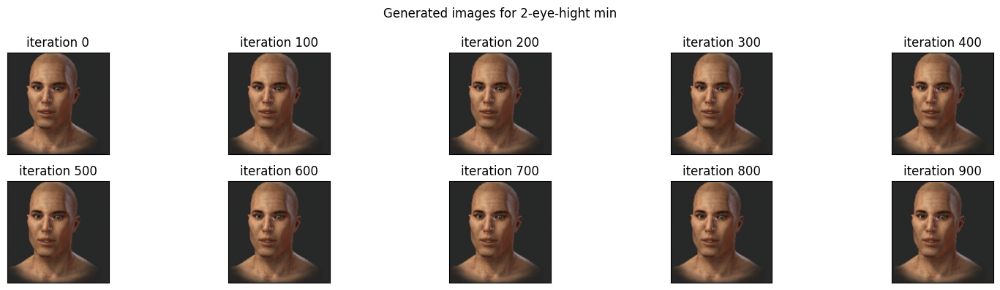

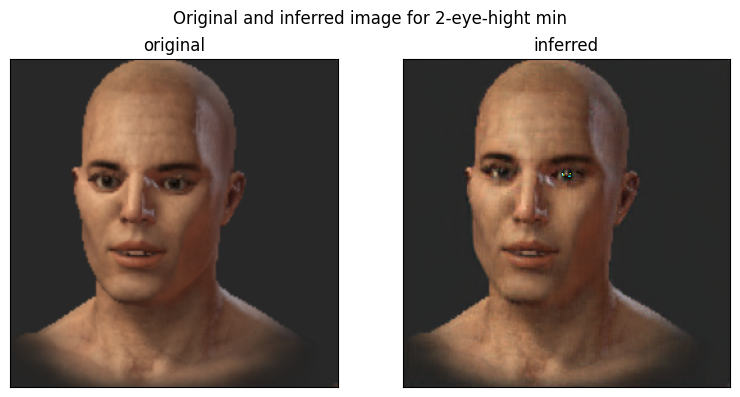

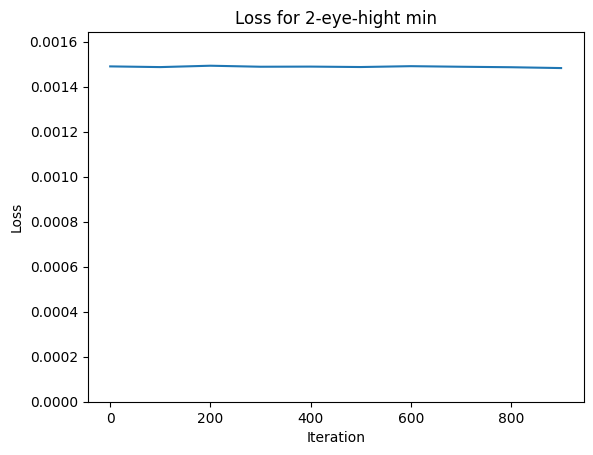

-----------------------------------
Parameter: 2-eye-hight max
Searching for z...
Iteration: 0, loss: 8.92E-04
Iteration: 100, loss: 8.99E-04
Iteration: 200, loss: 8.90E-04
Iteration: 300, loss: 8.87E-04
Iteration: 400, loss: 8.88E-04
Iteration: 500, loss: 8.88E-04
Iteration: 600, loss: 8.88E-04
Iteration: 700, loss: 8.87E-04
Iteration: 800, loss: 8.90E-04
Iteration: 900, loss: 8.92E-04
Plotting results...


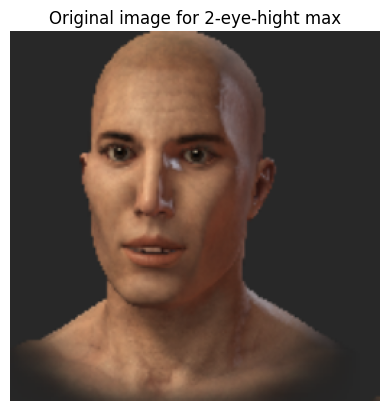

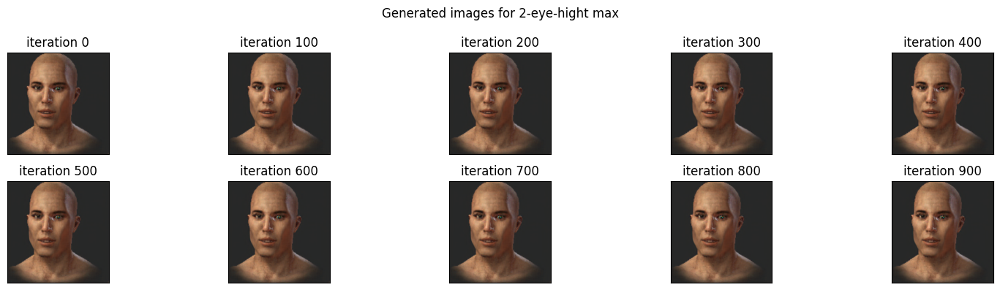

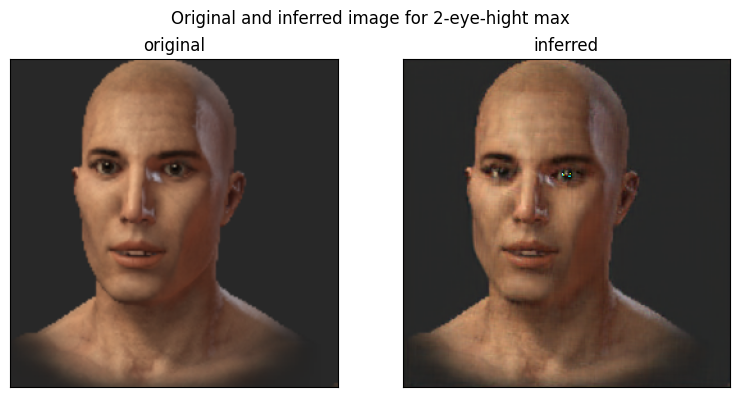

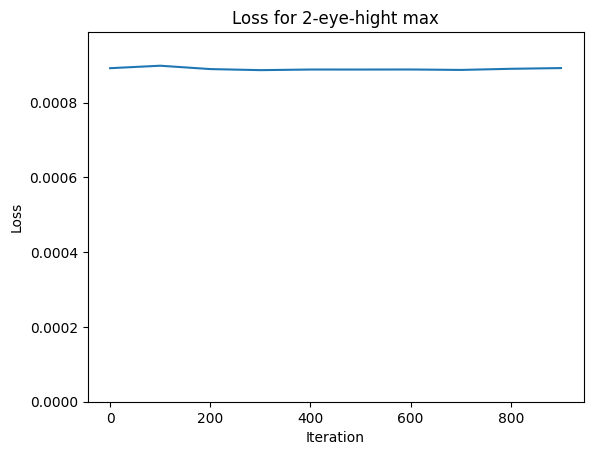

-----------------------------------


(tensor([[-3.4651e-01, -1.8610e+00, -3.6883e-01, -2.1845e-03, -1.8308e-01,
          -4.8795e-02,  6.9290e-01, -9.2188e-01,  1.1443e+00,  6.8912e-01,
          -3.2256e-01,  1.9447e+00,  1.7723e+00,  6.8802e-01, -2.0691e+00,
           1.0704e+00, -4.4615e-01, -4.0849e-01, -4.0204e-01, -8.7545e-01,
           8.5396e-01, -5.4908e-01,  2.3717e-01, -2.1771e-01,  2.6005e-01,
          -7.4699e-01,  2.8021e-02,  1.0770e-01, -4.7663e-01, -5.5307e-01,
           1.1053e+00, -7.3717e-03, -2.2625e+00,  1.1042e+00, -5.3702e-02,
          -7.0914e-01, -2.5311e-01, -9.8863e-01,  1.2841e+00, -2.7455e-01,
          -1.6597e+00, -8.6879e-01,  5.6336e-02, -1.0202e+00,  1.2505e+00,
          -1.7718e-01, -7.6437e-01, -8.5182e-01, -2.5340e-01, -5.5074e-01,
          -6.6475e-01, -6.5588e-01, -9.9575e-01, -7.0786e-01,  2.1303e-01,
          -1.7712e-01, -1.0141e+00,  5.2202e-01,  2.0735e-01, -5.4124e-01,
           2.8727e-01, -5.7002e-01, -3.7280e-01,  1.8376e+00, -4.8038e-01,
          -3.6423e-01, -2

In [ ]:
prepare_plots_per_param(param_names[2], min_and_max_image_tensors[2], z_init,  iterations=1000)
prepare_plots_per_param(param_names[3], min_and_max_image_tensors[3], z_init,  iterations=1000)


#### Eye angle

Parameter: 3-eye-angle min
Searching for z...
Iteration: 0, loss: 3.99E-04
Iteration: 100, loss: 3.99E-04
Iteration: 200, loss: 4.00E-04
Iteration: 300, loss: 4.01E-04
Iteration: 400, loss: 3.99E-04
Iteration: 500, loss: 4.00E-04
Iteration: 600, loss: 3.98E-04
Iteration: 700, loss: 3.99E-04
Iteration: 800, loss: 3.97E-04
Iteration: 900, loss: 3.98E-04
Plotting results...


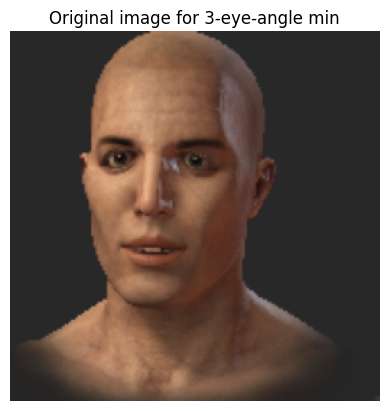

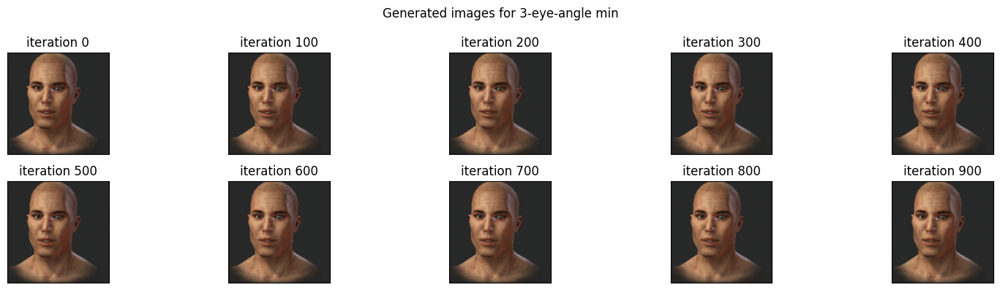

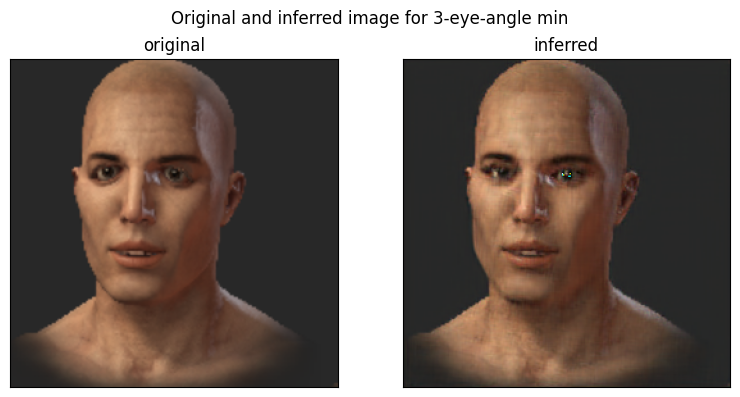

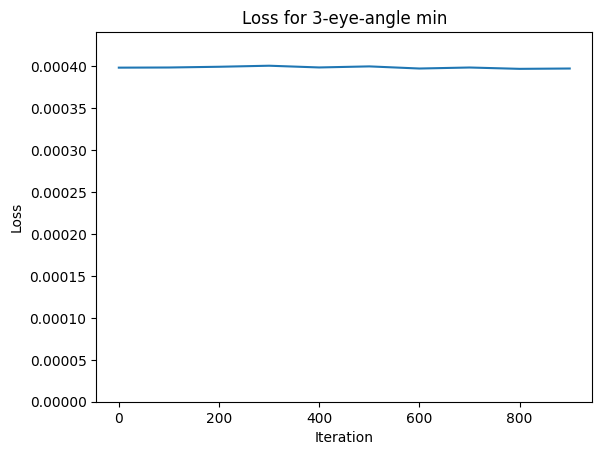

-----------------------------------
Parameter: 3-eye-angle max
Searching for z...
Iteration: 0, loss: 3.74E-04
Iteration: 100, loss: 3.74E-04
Iteration: 200, loss: 3.73E-04
Iteration: 300, loss: 3.74E-04
Iteration: 400, loss: 3.72E-04
Iteration: 500, loss: 3.74E-04
Iteration: 600, loss: 3.74E-04
Iteration: 700, loss: 3.73E-04
Iteration: 800, loss: 3.73E-04
Iteration: 900, loss: 3.74E-04
Plotting results...


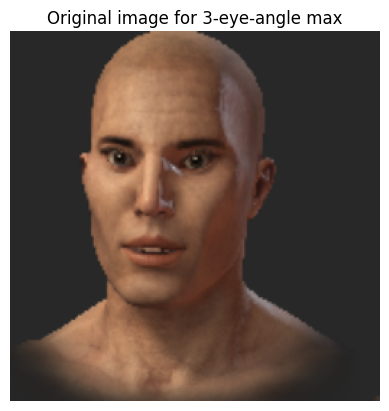

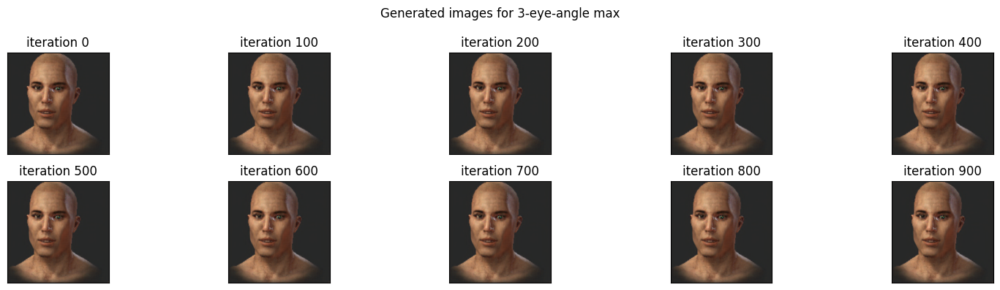

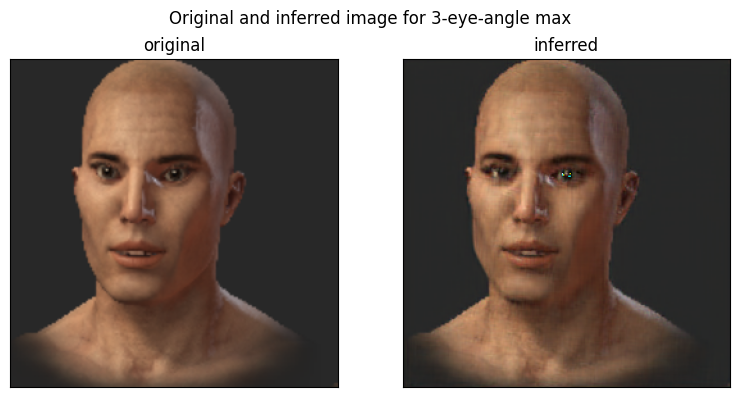

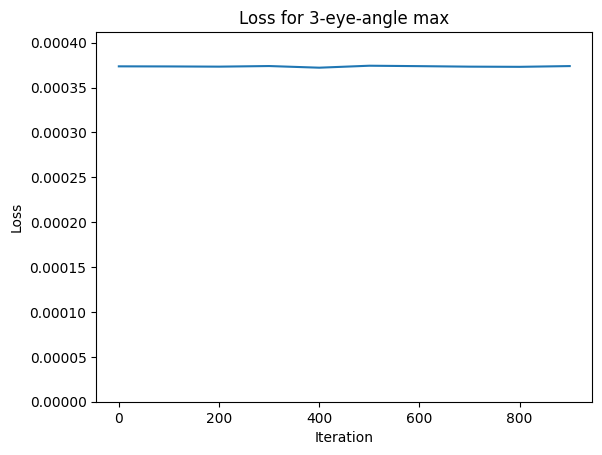

-----------------------------------


(tensor([[-3.4651e-01, -1.8610e+00, -3.6883e-01, -2.1845e-03, -1.8308e-01,
          -4.8795e-02,  6.9290e-01, -9.2188e-01,  1.1443e+00,  6.8912e-01,
          -3.2256e-01,  1.9447e+00,  1.7723e+00,  6.8802e-01, -2.0691e+00,
           1.0704e+00, -4.4615e-01, -4.0849e-01, -4.0204e-01, -8.7545e-01,
           8.5396e-01, -5.4908e-01,  2.3717e-01, -2.1771e-01,  2.6005e-01,
          -7.4699e-01,  2.8021e-02,  1.0770e-01, -4.7663e-01, -5.5307e-01,
           1.1053e+00, -7.3717e-03, -2.2625e+00,  1.1042e+00, -5.3702e-02,
          -7.0914e-01, -2.5311e-01, -9.8863e-01,  1.2841e+00, -2.7455e-01,
          -1.6597e+00, -8.6879e-01,  5.6336e-02, -1.0202e+00,  1.2505e+00,
          -1.7718e-01, -7.6437e-01, -8.5182e-01, -2.5340e-01, -5.5074e-01,
          -6.6475e-01, -6.5588e-01, -9.9575e-01, -7.0786e-01,  2.1303e-01,
          -1.7712e-01, -1.0141e+00,  5.2202e-01,  2.0735e-01, -5.4124e-01,
           2.8727e-01, -5.7002e-01, -3.7280e-01,  1.8376e+00, -4.8038e-01,
          -3.6423e-01, -2

In [ ]:

prepare_plots_per_param(param_names[4], min_and_max_image_tensors[4], z_init,  iterations=1000)
prepare_plots_per_param(param_names[5], min_and_max_image_tensors[5], z_init,  iterations=1000)


#### Jaw width

Parameter: 4-jaw-width min
Searching for z...
Iteration: 0, loss: 6.07E-04
Iteration: 100, loss: 6.06E-04
Iteration: 200, loss: 6.07E-04
Iteration: 300, loss: 6.06E-04
Iteration: 400, loss: 6.07E-04
Iteration: 500, loss: 6.07E-04
Iteration: 600, loss: 6.07E-04
Iteration: 700, loss: 6.07E-04
Iteration: 800, loss: 6.07E-04
Iteration: 900, loss: 6.06E-04
Plotting results...


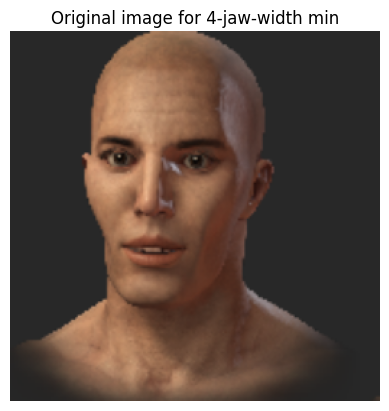

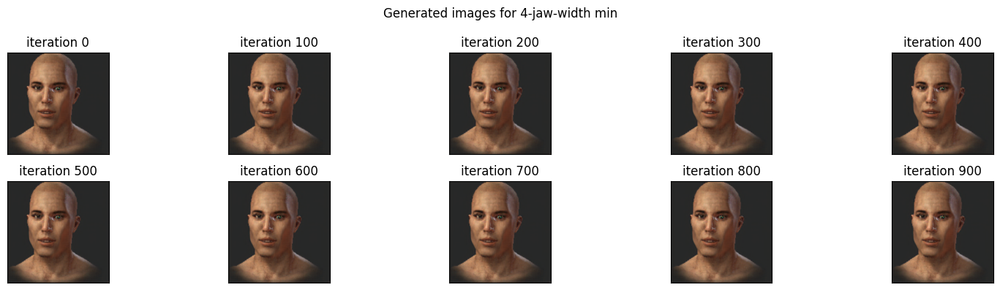

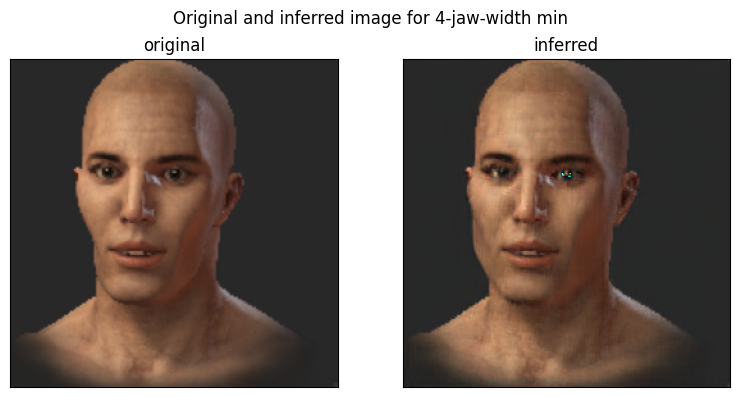

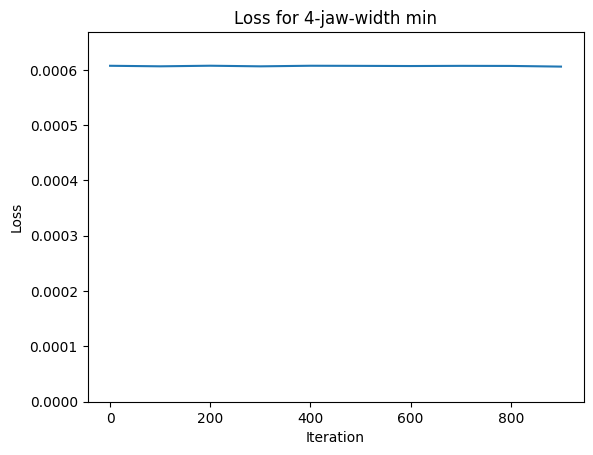

-----------------------------------
Parameter: 4-jaw-width max
Searching for z...
Iteration: 0, loss: 4.31E-04
Iteration: 100, loss: 4.32E-04
Iteration: 200, loss: 4.31E-04
Iteration: 300, loss: 4.32E-04
Iteration: 400, loss: 4.31E-04
Iteration: 500, loss: 4.31E-04
Iteration: 600, loss: 4.32E-04
Iteration: 700, loss: 4.32E-04
Iteration: 800, loss: 4.31E-04
Iteration: 900, loss: 4.33E-04
Plotting results...


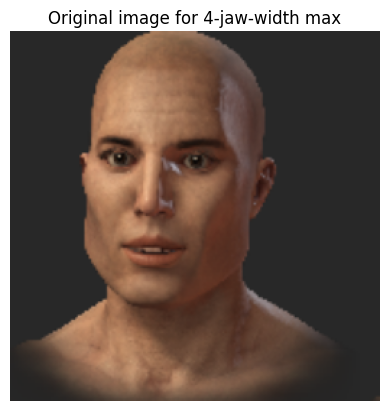

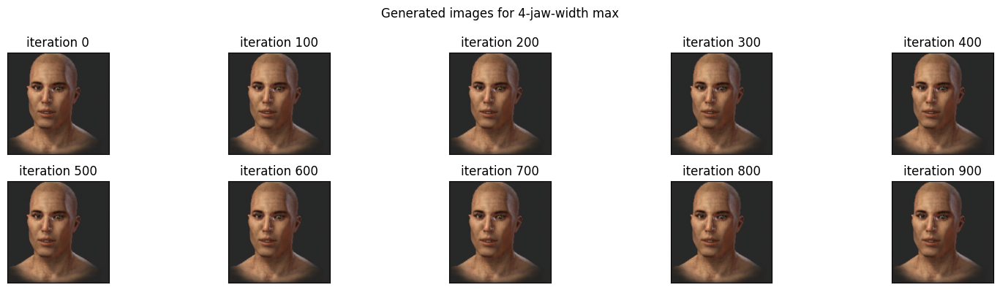

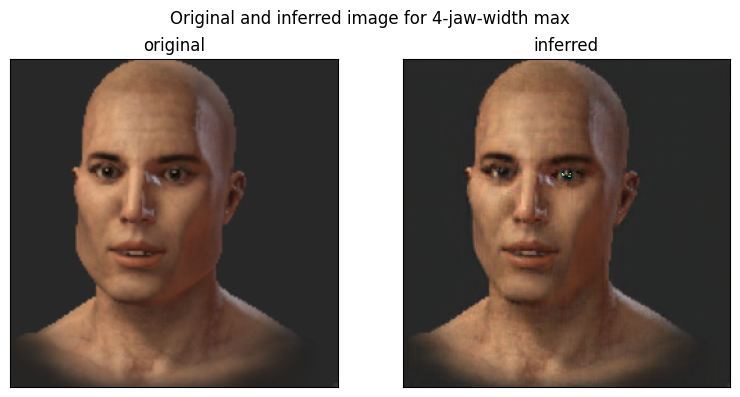

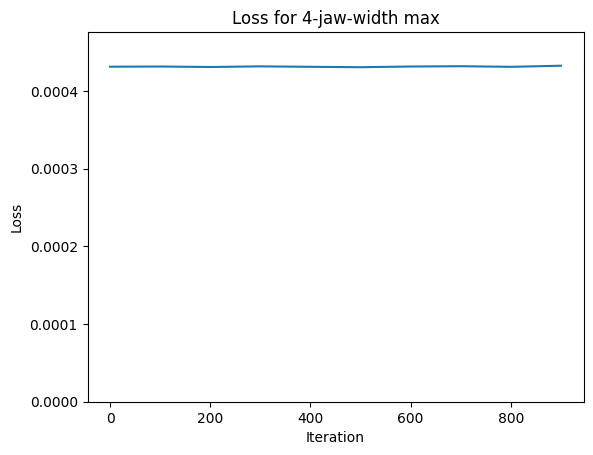

-----------------------------------


(tensor([[-3.4651e-01, -1.8610e+00, -3.6883e-01, -2.1845e-03, -1.8308e-01,
          -4.8795e-02,  6.9290e-01, -9.2188e-01,  1.1443e+00,  6.8912e-01,
          -3.2256e-01,  1.9447e+00,  1.7723e+00,  6.8802e-01, -2.0691e+00,
           1.0704e+00, -4.4615e-01, -4.0849e-01, -4.0204e-01, -8.7545e-01,
           8.5396e-01, -5.4908e-01,  2.3717e-01, -2.1771e-01,  2.6005e-01,
          -7.4699e-01,  2.8021e-02,  1.0770e-01, -4.7663e-01, -5.5307e-01,
           1.1053e+00, -7.3717e-03, -2.2625e+00,  1.1042e+00, -5.3702e-02,
          -7.0914e-01, -2.5311e-01, -9.8863e-01,  1.2841e+00, -2.7455e-01,
          -1.6597e+00, -8.6879e-01,  5.6336e-02, -1.0202e+00,  1.2505e+00,
          -1.7718e-01, -7.6437e-01, -8.5182e-01, -2.5340e-01, -5.5074e-01,
          -6.6475e-01, -6.5588e-01, -9.9575e-01, -7.0786e-01,  2.1303e-01,
          -1.7712e-01, -1.0141e+00,  5.2202e-01,  2.0735e-01, -5.4124e-01,
           2.8727e-01, -5.7002e-01, -3.7280e-01,  1.8376e+00, -4.8038e-01,
          -3.6423e-01, -2

In [ ]:

prepare_plots_per_param(param_names[6], min_and_max_image_tensors[6], z_init,  iterations=1000)
prepare_plots_per_param(param_names[7], min_and_max_image_tensors[7], z_init,  iterations=1000)


#### Jaw height



Parameter: 5-jaw-height min
Searching for z...
Iteration: 0, loss: 1.02E-03
Iteration: 100, loss: 1.02E-03
Iteration: 200, loss: 1.02E-03
Iteration: 300, loss: 1.02E-03
Iteration: 400, loss: 1.02E-03
Iteration: 500, loss: 1.02E-03
Iteration: 600, loss: 1.02E-03
Iteration: 700, loss: 1.02E-03
Iteration: 800, loss: 1.02E-03
Iteration: 900, loss: 1.02E-03
Plotting results...


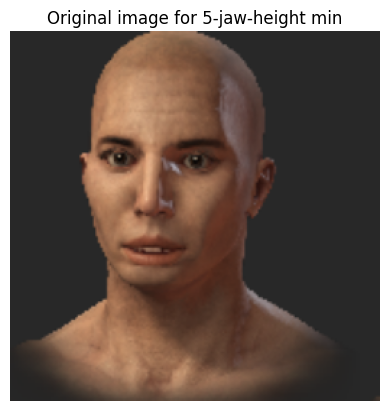

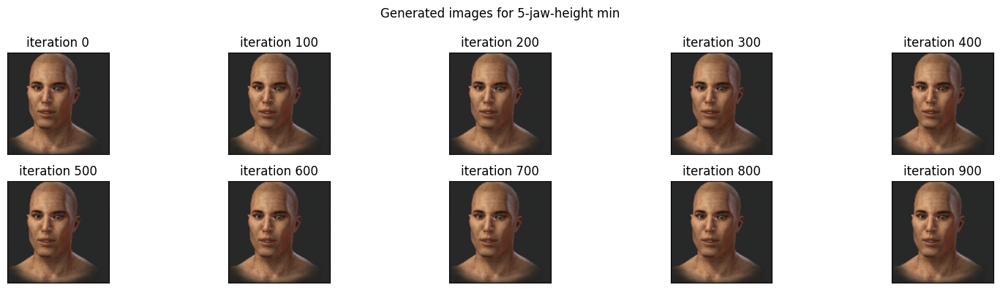

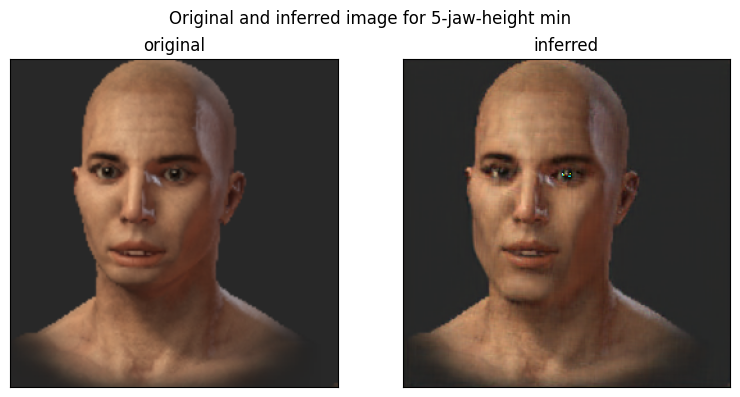

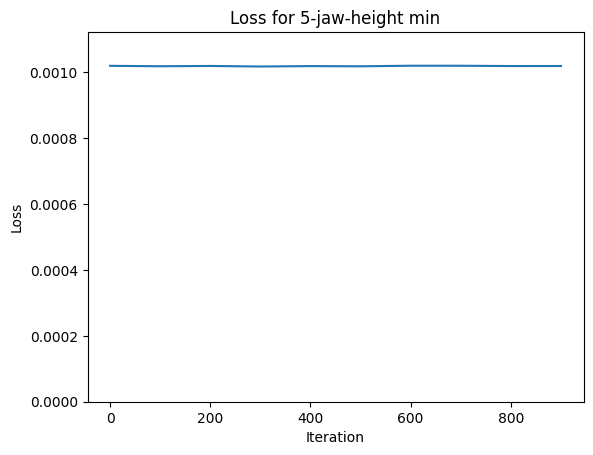

-----------------------------------


(tensor([[-3.4651e-01, -1.8610e+00, -3.6883e-01, -2.1845e-03, -1.8308e-01,
          -4.8795e-02,  6.9290e-01, -9.2188e-01,  1.1443e+00,  6.8912e-01,
          -3.2256e-01,  1.9447e+00,  1.7723e+00,  6.8802e-01, -2.0691e+00,
           1.0704e+00, -4.4615e-01, -4.0849e-01, -4.0204e-01, -8.7545e-01,
           8.5396e-01, -5.4908e-01,  2.3717e-01, -2.1771e-01,  2.6005e-01,
          -7.4699e-01,  2.8021e-02,  1.0770e-01, -4.7663e-01, -5.5307e-01,
           1.1053e+00, -7.3717e-03, -2.2625e+00,  1.1042e+00, -5.3702e-02,
          -7.0914e-01, -2.5311e-01, -9.8863e-01,  1.2841e+00, -2.7455e-01,
          -1.6597e+00, -8.6879e-01,  5.6336e-02, -1.0202e+00,  1.2505e+00,
          -1.7718e-01, -7.6437e-01, -8.5182e-01, -2.5340e-01, -5.5074e-01,
          -6.6475e-01, -6.5588e-01, -9.9575e-01, -7.0786e-01,  2.1303e-01,
          -1.7712e-01, -1.0141e+00,  5.2202e-01,  2.0735e-01, -5.4124e-01,
           2.8727e-01, -5.7002e-01, -3.7280e-01,  1.8376e+00, -4.8038e-01,
          -3.6423e-01, -2

In [ ]:
prepare_plots_per_param(param_names[8], min_and_max_image_tensors[8], z_init,  iterations=1000)

Parameter: 5-jaw-height max
Searching for z...
Iteration: 0, loss: 5.76E-04
Iteration: 100, loss: 5.77E-04
Iteration: 200, loss: 5.75E-04
Iteration: 300, loss: 5.76E-04
Iteration: 400, loss: 5.77E-04
Iteration: 500, loss: 5.75E-04
Iteration: 600, loss: 5.75E-04
Iteration: 700, loss: 5.75E-04
Iteration: 800, loss: 5.75E-04
Iteration: 900, loss: 5.77E-04
Plotting results...


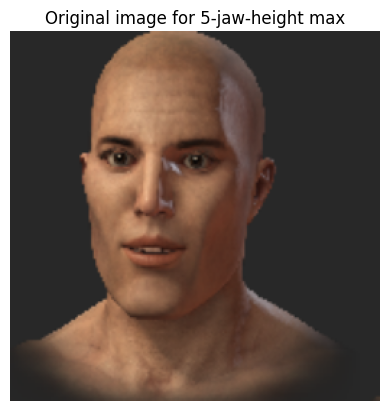

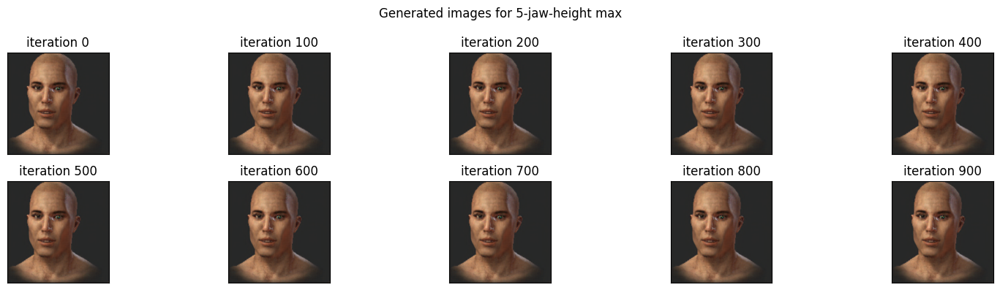

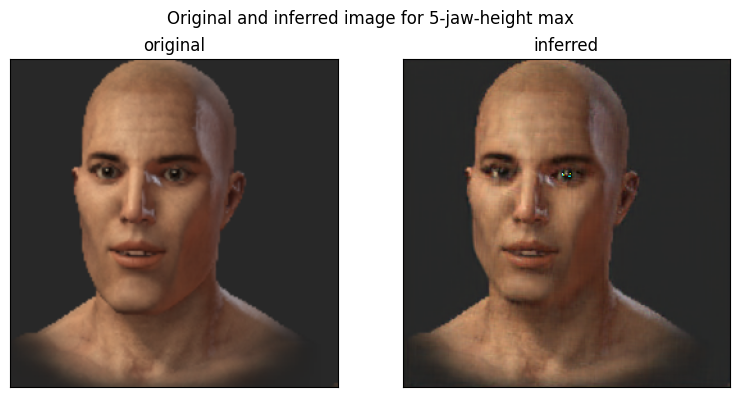

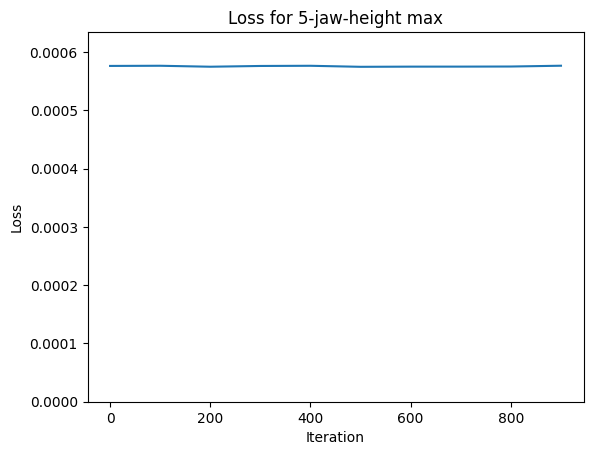

-----------------------------------


(tensor([[-3.4651e-01, -1.8610e+00, -3.6883e-01, -2.1845e-03, -1.8308e-01,
          -4.8795e-02,  6.9290e-01, -9.2188e-01,  1.1443e+00,  6.8912e-01,
          -3.2256e-01,  1.9447e+00,  1.7723e+00,  6.8802e-01, -2.0691e+00,
           1.0704e+00, -4.4615e-01, -4.0849e-01, -4.0204e-01, -8.7545e-01,
           8.5396e-01, -5.4908e-01,  2.3717e-01, -2.1771e-01,  2.6005e-01,
          -7.4699e-01,  2.8021e-02,  1.0770e-01, -4.7663e-01, -5.5307e-01,
           1.1053e+00, -7.3717e-03, -2.2625e+00,  1.1042e+00, -5.3702e-02,
          -7.0914e-01, -2.5311e-01, -9.8863e-01,  1.2841e+00, -2.7455e-01,
          -1.6597e+00, -8.6879e-01,  5.6336e-02, -1.0202e+00,  1.2505e+00,
          -1.7718e-01, -7.6437e-01, -8.5182e-01, -2.5340e-01, -5.5074e-01,
          -6.6475e-01, -6.5588e-01, -9.9575e-01, -7.0786e-01,  2.1303e-01,
          -1.7712e-01, -1.0141e+00,  5.2202e-01,  2.0735e-01, -5.4124e-01,
           2.8727e-01, -5.7002e-01, -3.7280e-01,  1.8376e+00, -4.8038e-01,
          -3.6423e-01, -2

In [ ]:
prepare_plots_per_param(param_names[9], min_and_max_image_tensors[9], z_init,  iterations=1000)

#### All but with bigger learning rate

Parameter: 1-eye-distance min
Searching for z...
Iteration: 0, loss: 5.86E-04
Iteration: 100, loss: 5.87E-04
Iteration: 200, loss: 5.86E-04
Iteration: 300, loss: 5.87E-04
Iteration: 400, loss: 5.86E-04
Iteration: 500, loss: 5.87E-04
Iteration: 600, loss: 5.86E-04
Iteration: 700, loss: 5.87E-04
Iteration: 800, loss: 5.87E-04
Iteration: 900, loss: 5.86E-04
Plotting results...


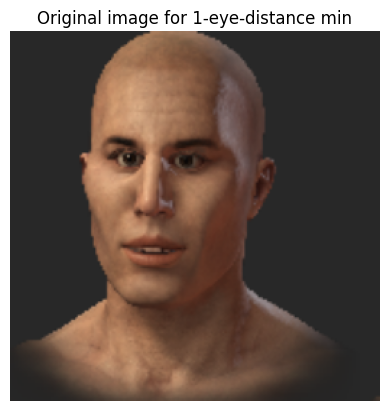

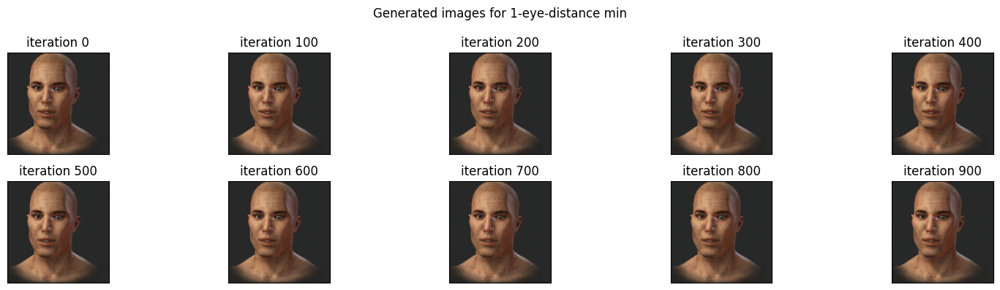

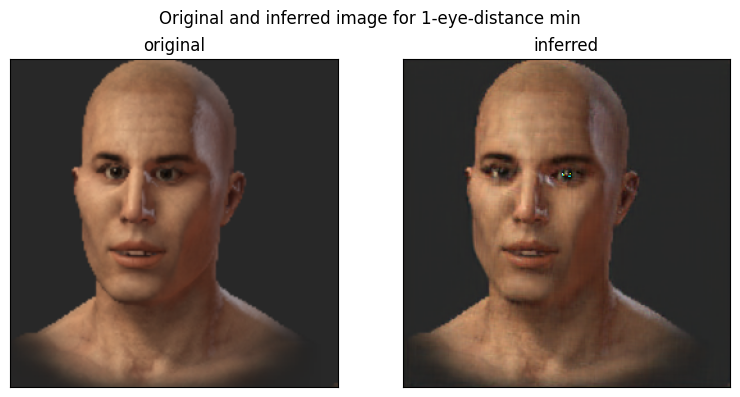

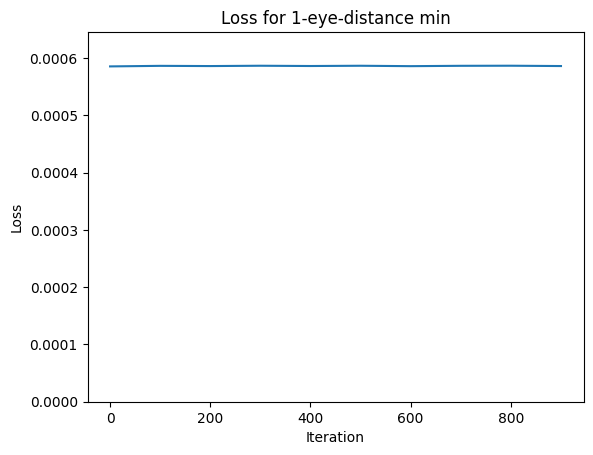

-----------------------------------
Parameter: 1-eye-distance max
Searching for z...
Iteration: 0, loss: 4.77E-04
Iteration: 100, loss: 4.78E-04
Iteration: 200, loss: 4.78E-04
Iteration: 300, loss: 4.78E-04
Iteration: 400, loss: 4.79E-04
Iteration: 500, loss: 4.77E-04
Iteration: 600, loss: 4.78E-04
Iteration: 700, loss: 4.78E-04
Iteration: 800, loss: 4.78E-04
Iteration: 900, loss: 4.77E-04
Plotting results...


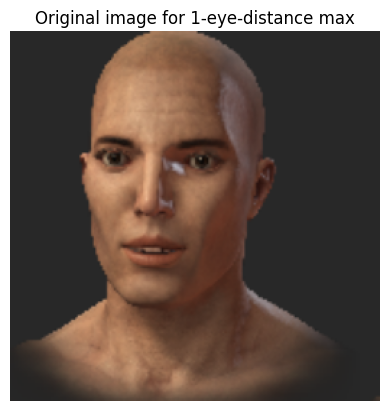

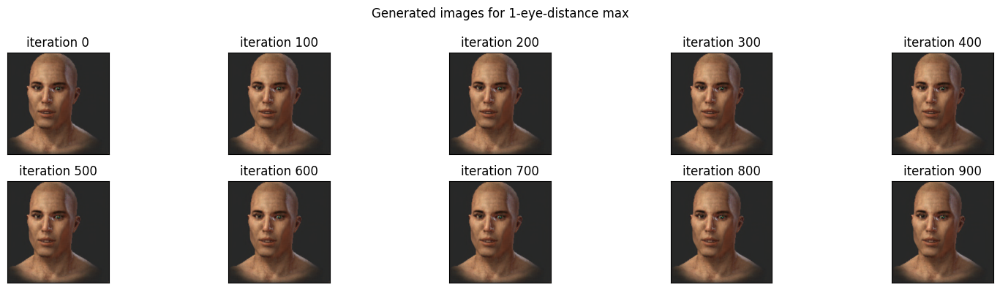

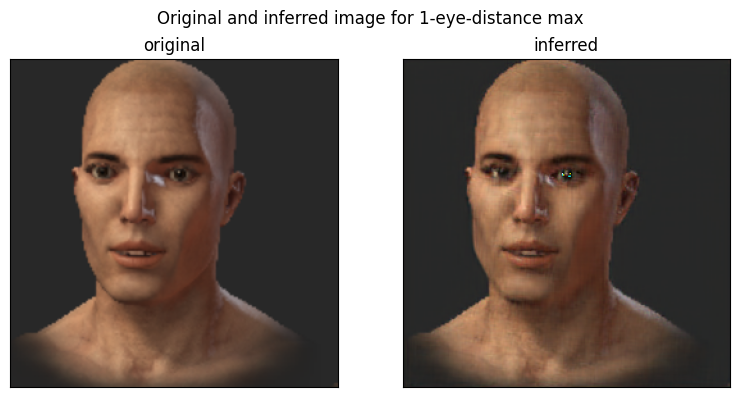

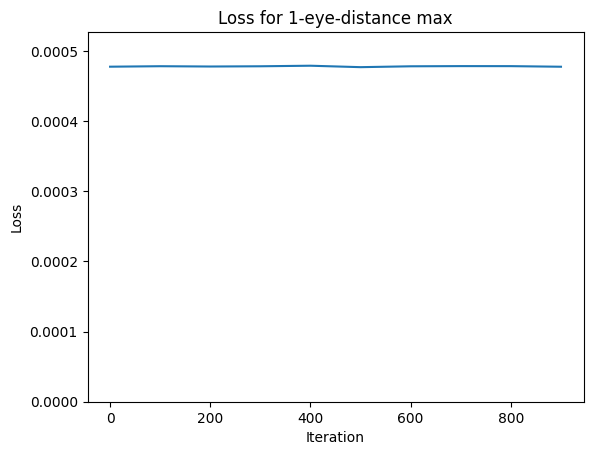

-----------------------------------
Parameter: 2-eye-hight min
Searching for z...
Iteration: 0, loss: 1.49E-03
Iteration: 100, loss: 1.49E-03
Iteration: 200, loss: 1.49E-03
Iteration: 300, loss: 1.48E-03
Iteration: 400, loss: 1.48E-03
Iteration: 500, loss: 1.49E-03
Iteration: 600, loss: 1.49E-03
Iteration: 700, loss: 1.48E-03
Iteration: 800, loss: 1.48E-03
Iteration: 900, loss: 1.49E-03
Plotting results...


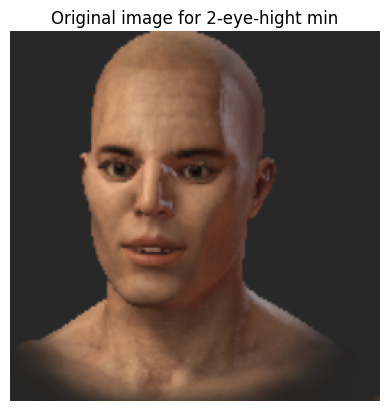

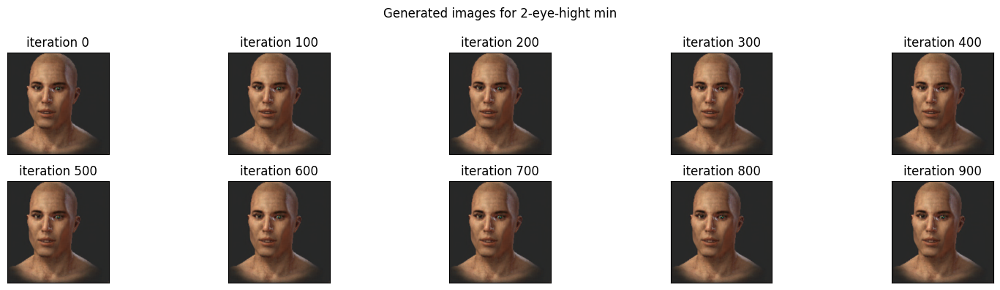

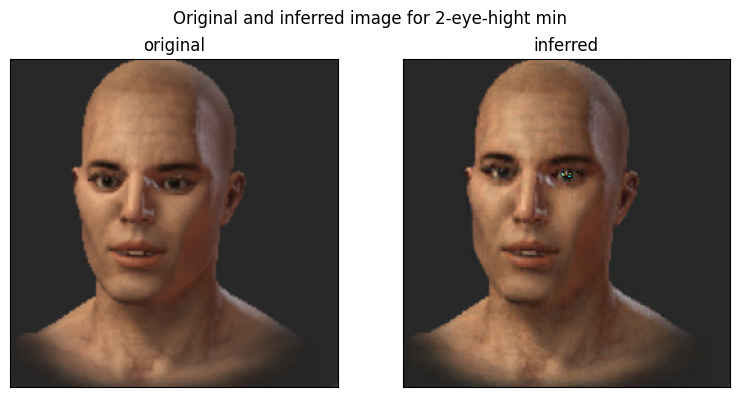

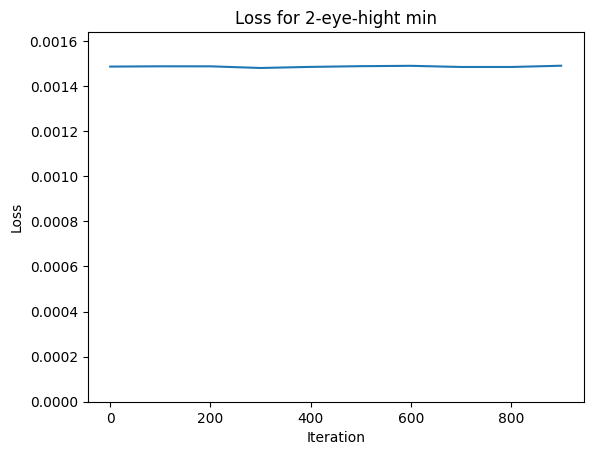

-----------------------------------
Parameter: 2-eye-hight max
Searching for z...
Iteration: 0, loss: 8.92E-04
Iteration: 100, loss: 8.92E-04
Iteration: 200, loss: 8.94E-04
Iteration: 300, loss: 8.89E-04
Iteration: 400, loss: 8.93E-04
Iteration: 500, loss: 8.91E-04
Iteration: 600, loss: 8.90E-04
Iteration: 700, loss: 8.94E-04
Iteration: 800, loss: 8.94E-04
Iteration: 900, loss: 8.94E-04
Plotting results...


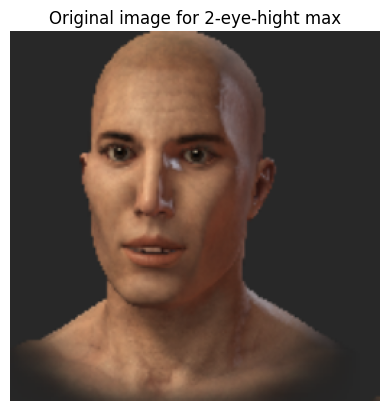

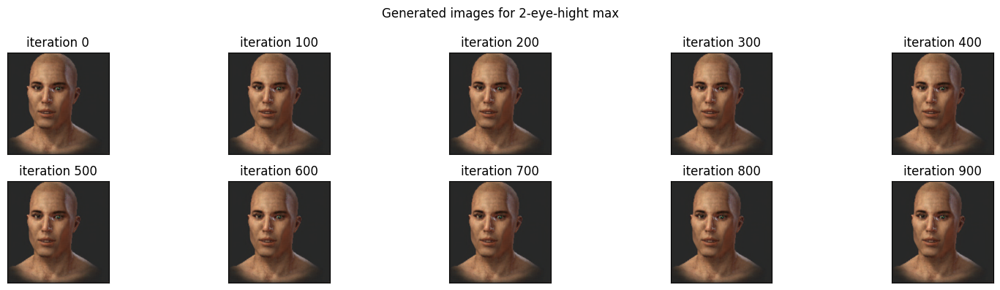

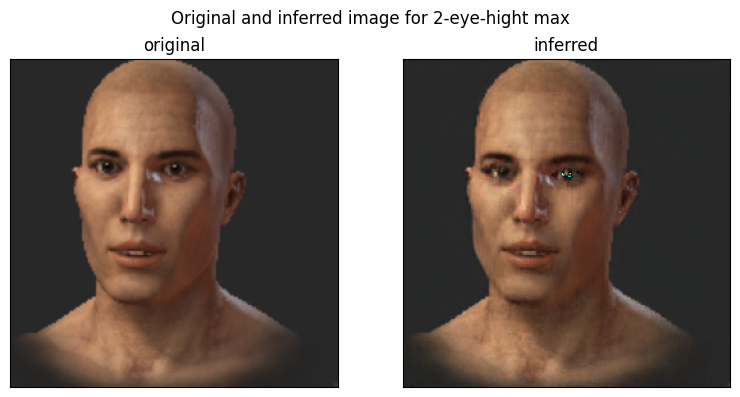

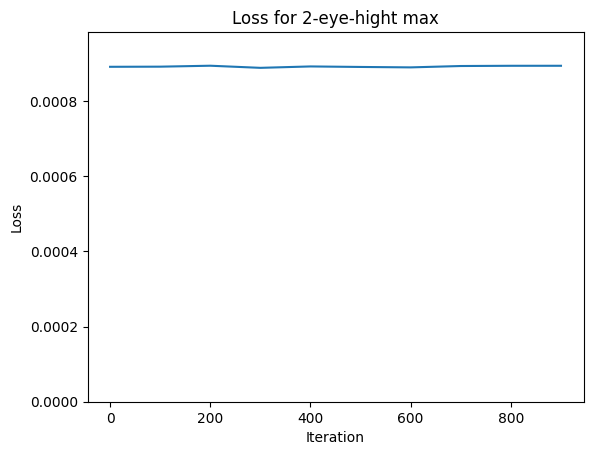

-----------------------------------
Parameter: 3-eye-angle min
Searching for z...
Iteration: 0, loss: 3.99E-04
Iteration: 100, loss: 3.99E-04
Iteration: 200, loss: 4.00E-04
Iteration: 300, loss: 4.01E-04
Iteration: 400, loss: 3.99E-04
Iteration: 500, loss: 3.99E-04
Iteration: 600, loss: 3.99E-04
Iteration: 700, loss: 4.00E-04
Iteration: 800, loss: 3.98E-04
Iteration: 900, loss: 4.00E-04
Plotting results...


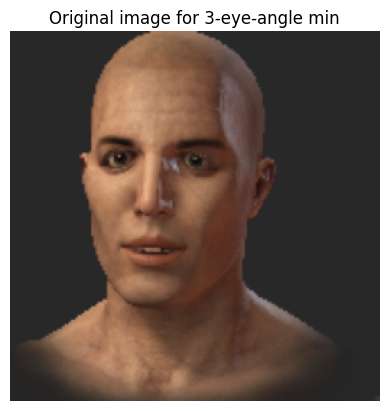

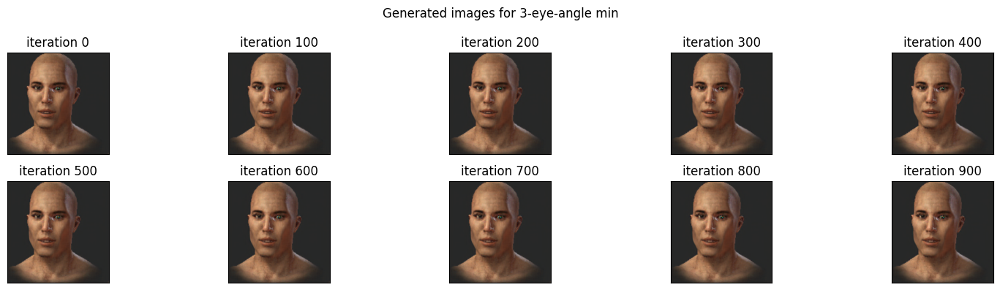

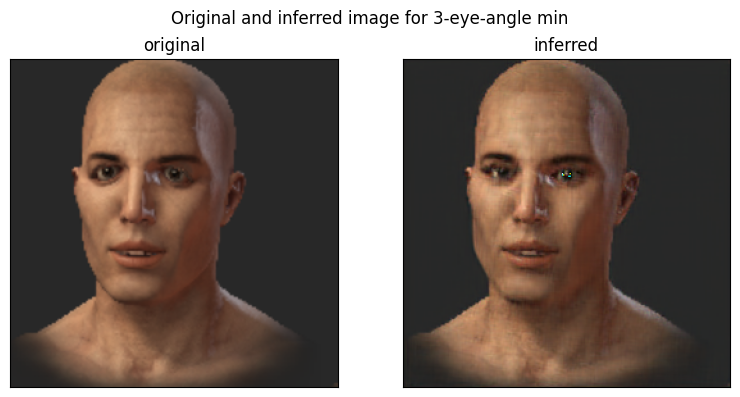

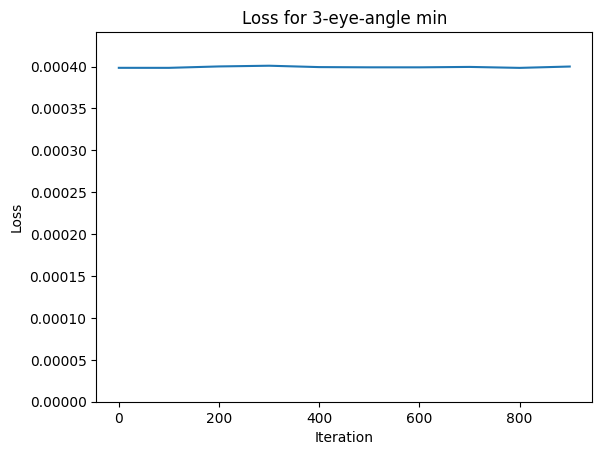

-----------------------------------
Parameter: 3-eye-angle max
Searching for z...
Iteration: 0, loss: 3.74E-04
Iteration: 100, loss: 3.74E-04
Iteration: 200, loss: 3.73E-04
Iteration: 300, loss: 3.74E-04
Iteration: 400, loss: 3.73E-04
Iteration: 500, loss: 3.73E-04
Iteration: 600, loss: 3.72E-04
Iteration: 700, loss: 3.74E-04
Iteration: 800, loss: 3.74E-04
Iteration: 900, loss: 3.74E-04
Plotting results...


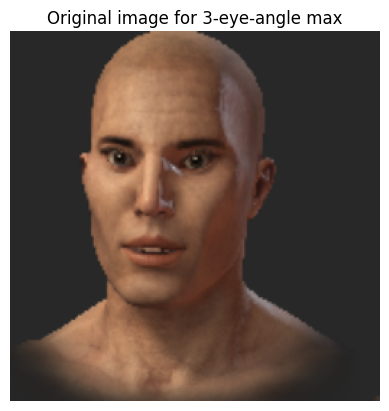

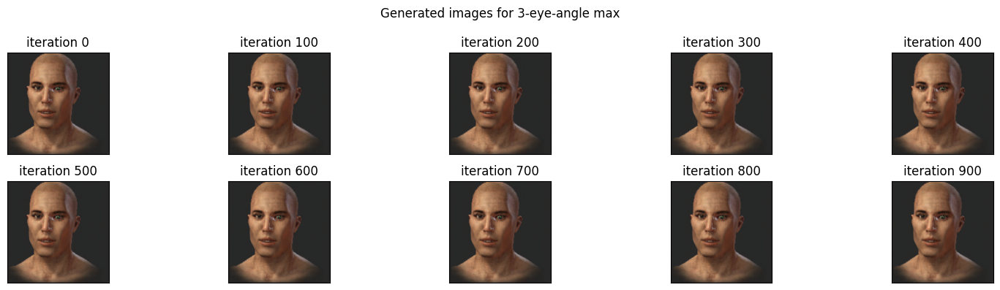

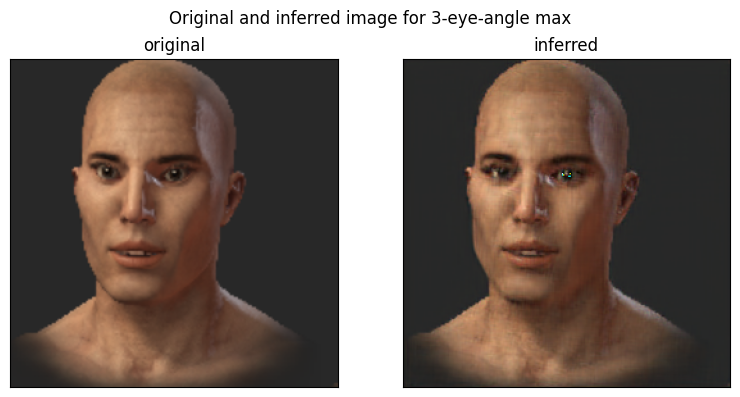

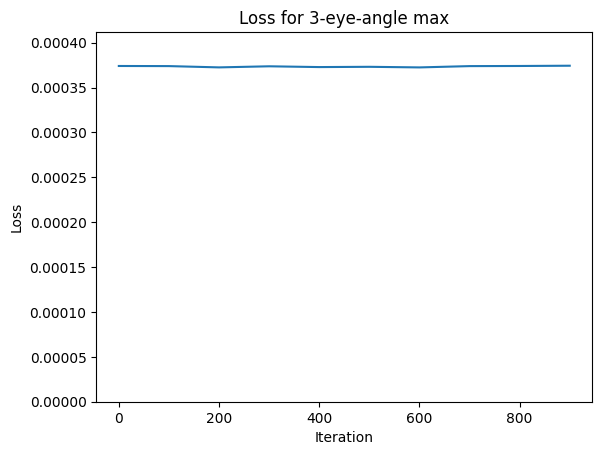

-----------------------------------
Parameter: 4-jaw-width min
Searching for z...
Iteration: 0, loss: 6.08E-04
Iteration: 100, loss: 6.07E-04
Iteration: 200, loss: 6.07E-04
Iteration: 300, loss: 6.07E-04
Iteration: 400, loss: 6.07E-04
Iteration: 500, loss: 6.07E-04
Iteration: 600, loss: 6.07E-04
Iteration: 700, loss: 6.07E-04
Iteration: 800, loss: 6.08E-04
Iteration: 900, loss: 6.08E-04
Plotting results...


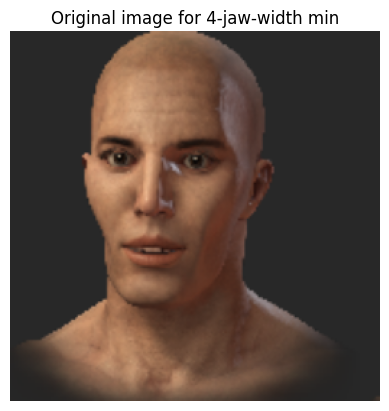

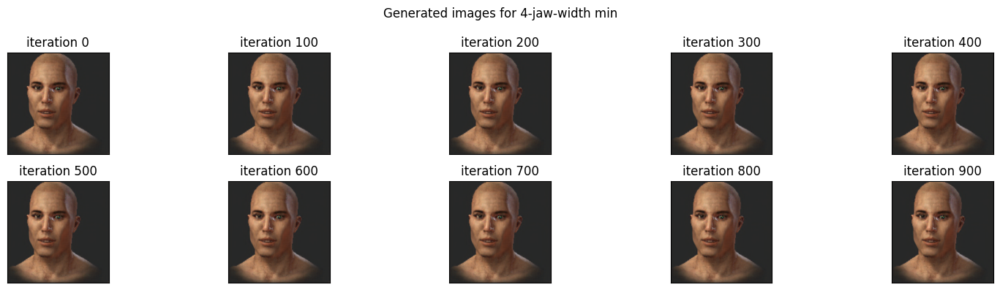

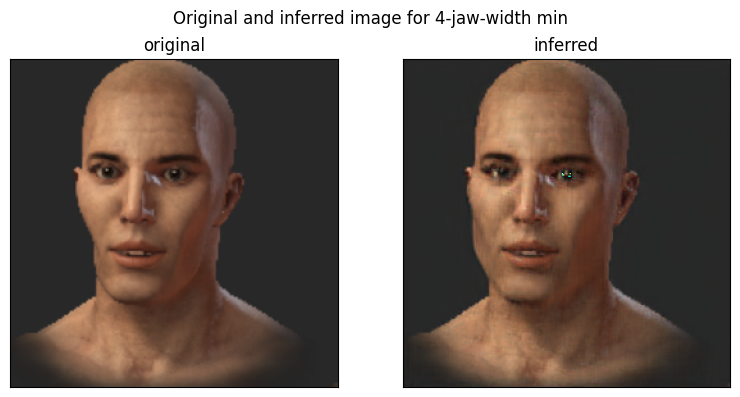

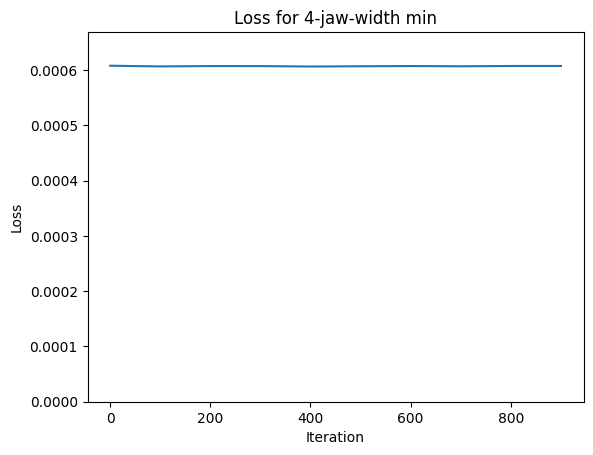

-----------------------------------
Parameter: 4-jaw-width max
Searching for z...
Iteration: 0, loss: 4.32E-04
Iteration: 100, loss: 4.31E-04
Iteration: 200, loss: 4.31E-04
Iteration: 300, loss: 4.31E-04
Iteration: 400, loss: 4.32E-04
Iteration: 500, loss: 4.32E-04
Iteration: 600, loss: 4.31E-04
Iteration: 700, loss: 4.31E-04
Iteration: 800, loss: 4.31E-04
Iteration: 900, loss: 4.32E-04
Plotting results...


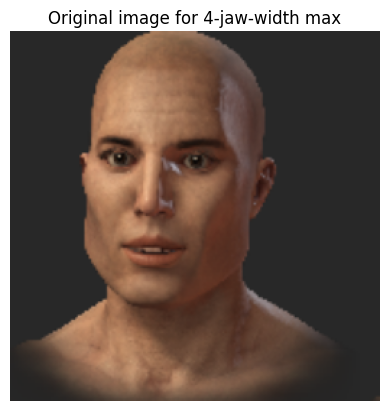

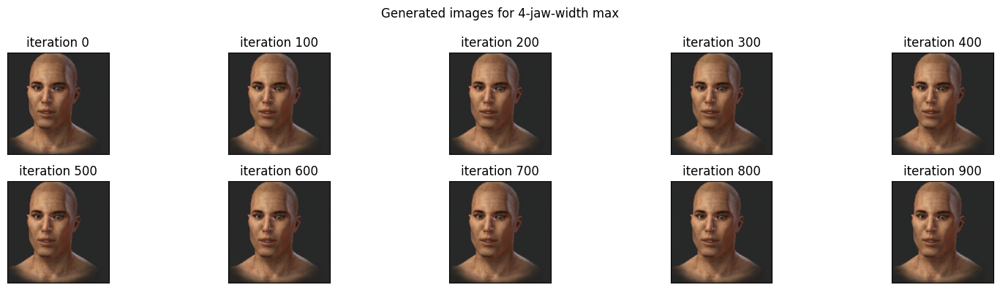

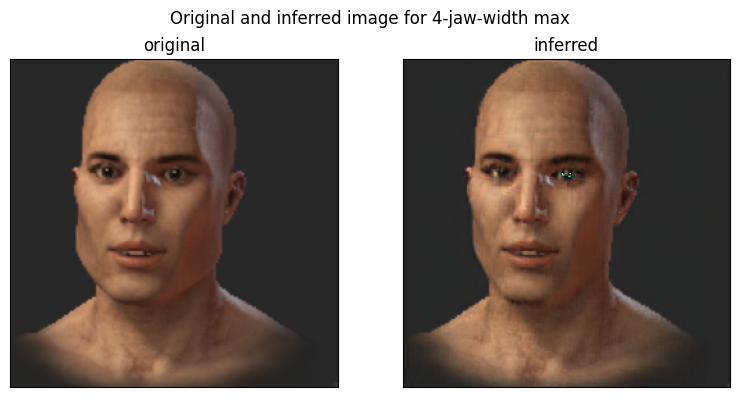

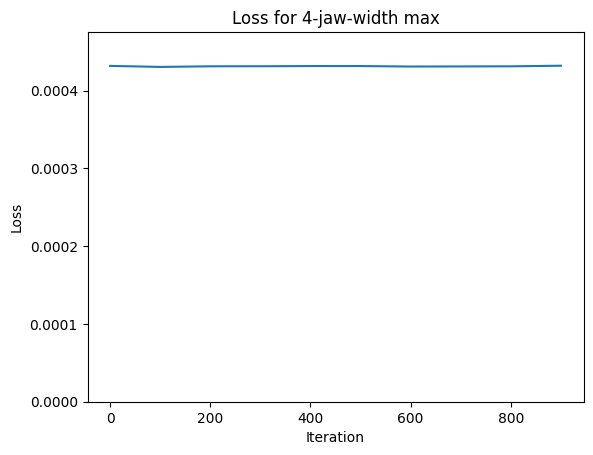

-----------------------------------
Parameter: 5-jaw-height min
Searching for z...
Iteration: 0, loss: 1.02E-03
Iteration: 100, loss: 1.02E-03
Iteration: 200, loss: 1.02E-03
Iteration: 300, loss: 1.02E-03
Iteration: 400, loss: 1.02E-03
Iteration: 500, loss: 1.02E-03
Iteration: 600, loss: 1.02E-03
Iteration: 700, loss: 1.02E-03
Iteration: 800, loss: 1.02E-03
Iteration: 900, loss: 1.02E-03
Plotting results...


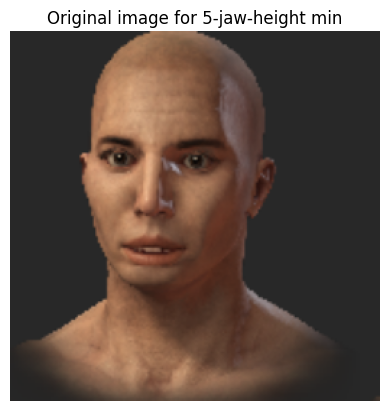

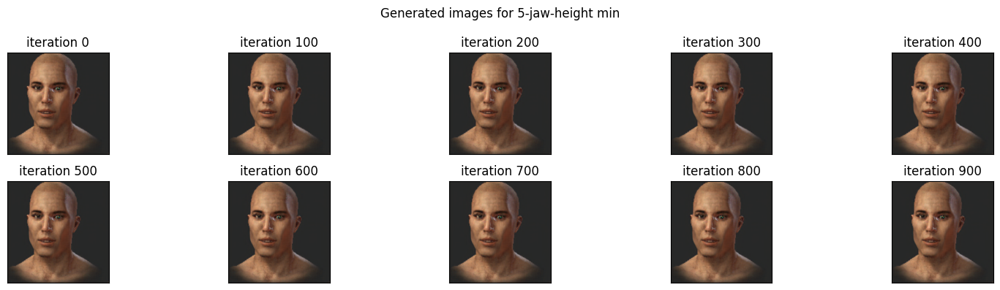

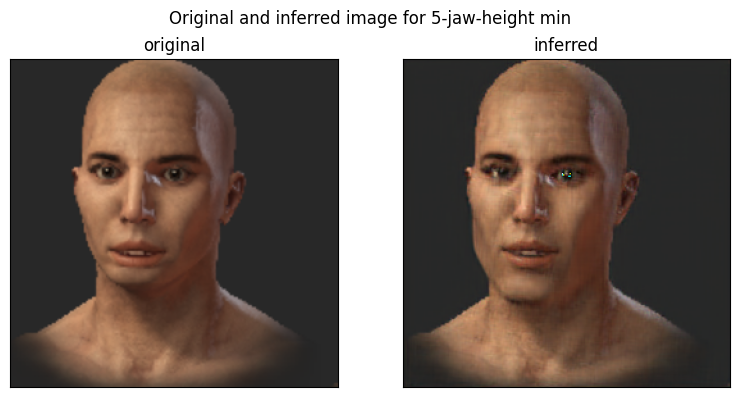

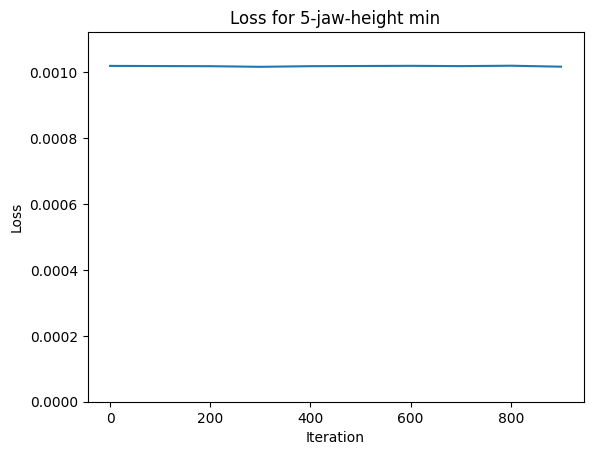

-----------------------------------
Parameter: 5-jaw-height max
Searching for z...
Iteration: 0, loss: 5.79E-04
Iteration: 100, loss: 5.76E-04
Iteration: 200, loss: 5.75E-04
Iteration: 300, loss: 5.78E-04
Iteration: 400, loss: 5.77E-04
Iteration: 500, loss: 5.75E-04
Iteration: 600, loss: 5.76E-04
Iteration: 700, loss: 5.76E-04
Iteration: 800, loss: 5.76E-04
Iteration: 900, loss: 5.75E-04
Plotting results...


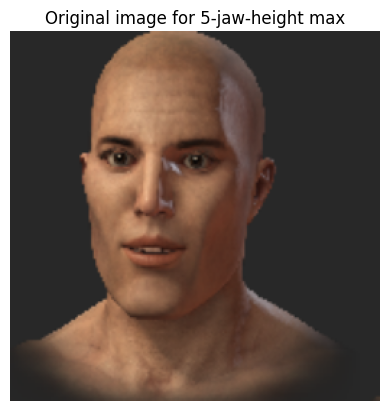

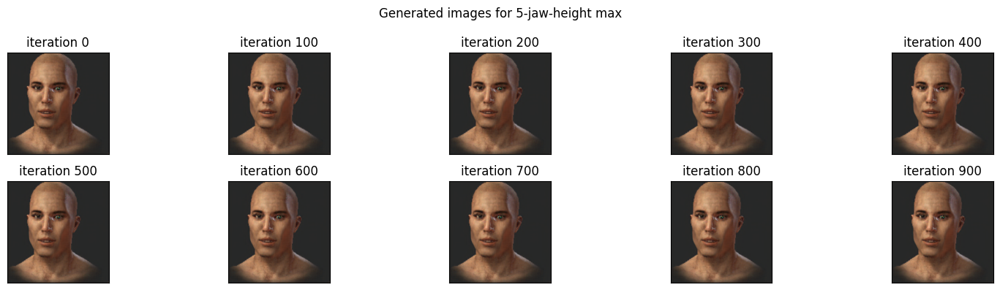

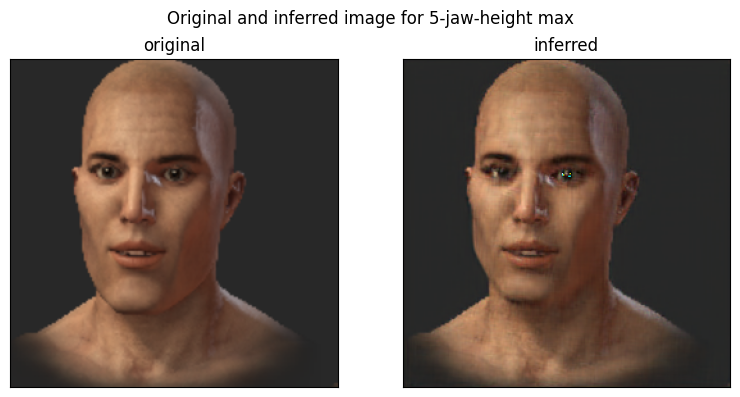

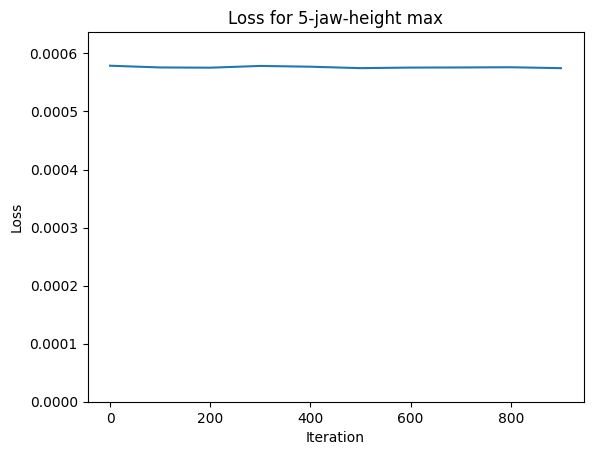

-----------------------------------


In [ ]:
for param_name, real_image_tensor in zip(param_names, min_and_max_image_tensors):
    prepare_plots_per_param(param_name, real_image_tensor, z_init, lr=1, iterations=1000)

#### All but from a random vector

Parameter: 1-eye-distance min
Searching for z...
Iteration: 0, loss: 2.82E-04
Iteration: 100, loss: 2.15E-04
Iteration: 200, loss: 2.14E-04
Iteration: 300, loss: 2.13E-04
Iteration: 400, loss: 2.13E-04
Plotting results...


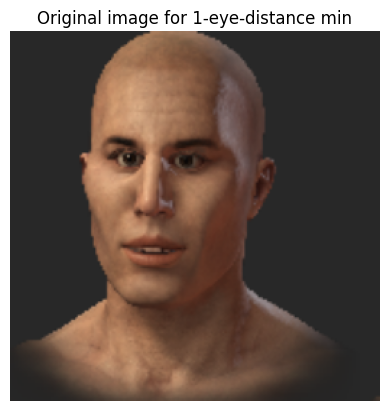

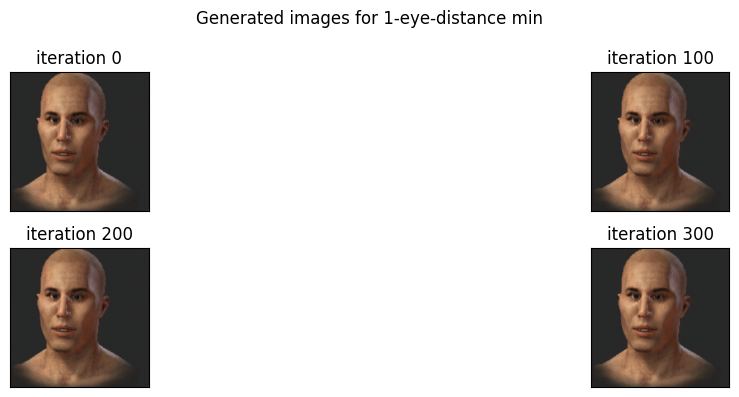

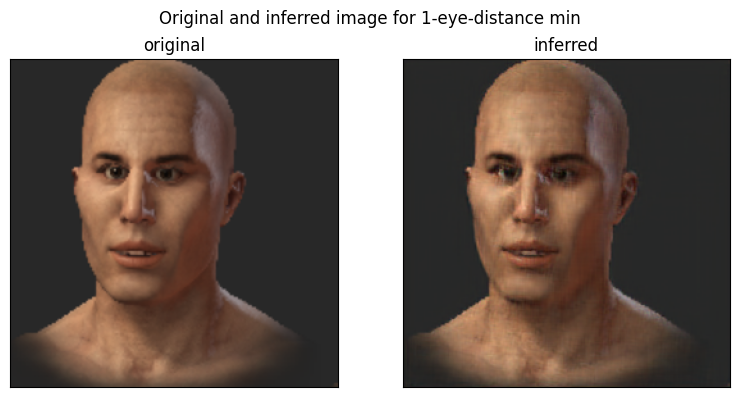

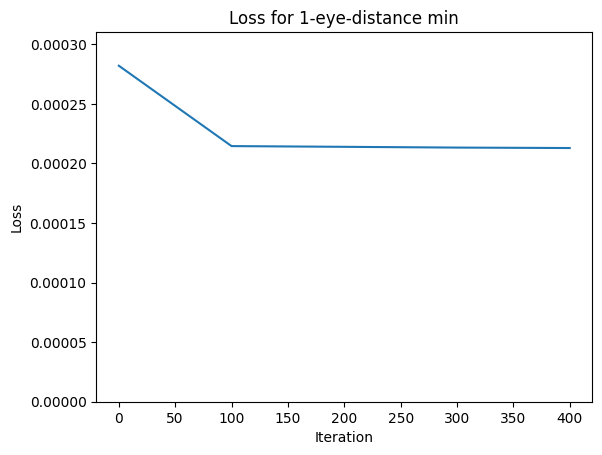

-----------------------------------
Parameter: 1-eye-distance max
Searching for z...
Iteration: 0, loss: 1.48E-03
Iteration: 100, loss: 6.99E-04
Iteration: 200, loss: 6.99E-04
Iteration: 300, loss: 6.98E-04
Iteration: 400, loss: 6.97E-04
Plotting results...


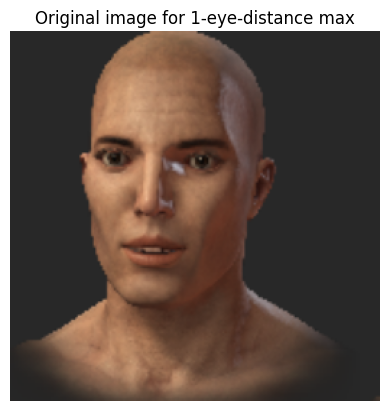

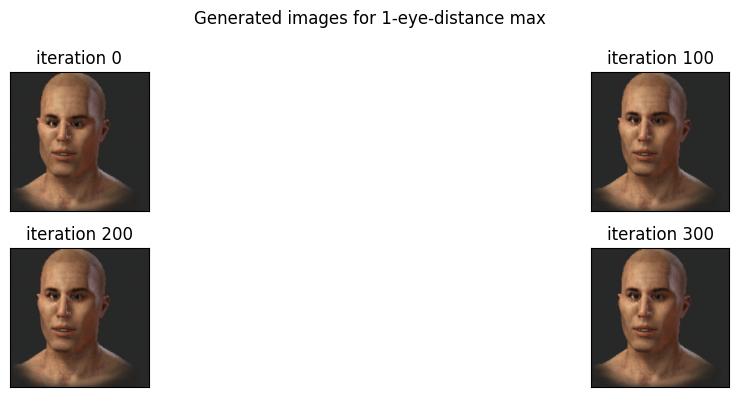

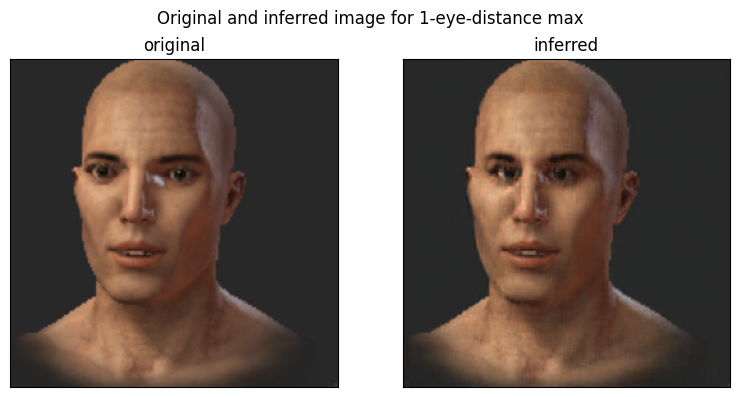

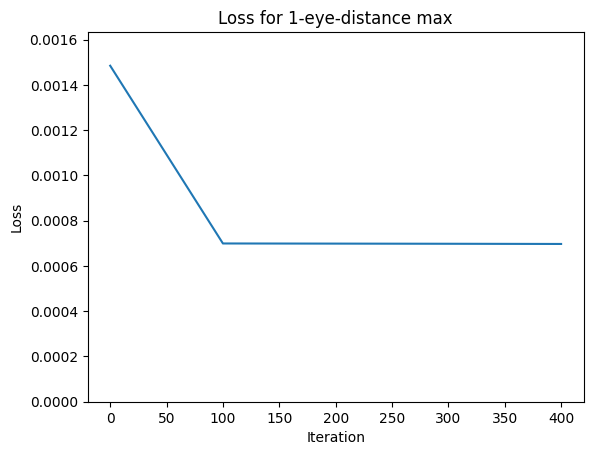

-----------------------------------
Parameter: 2-eye-hight min
Searching for z...
Iteration: 0, loss: 1.19E-03
Iteration: 100, loss: 5.34E-04
Iteration: 200, loss: 2.41E-04
Iteration: 300, loss: 2.38E-04
Iteration: 400, loss: 2.36E-04
Plotting results...


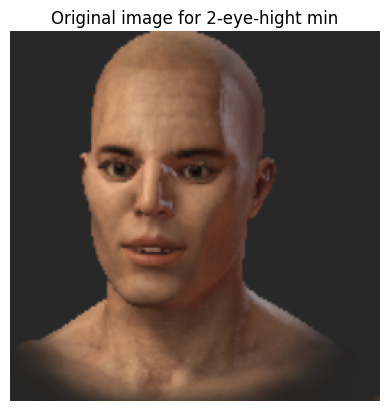

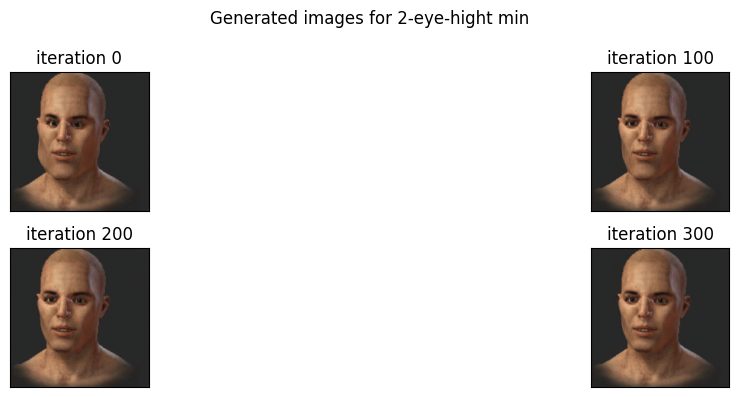

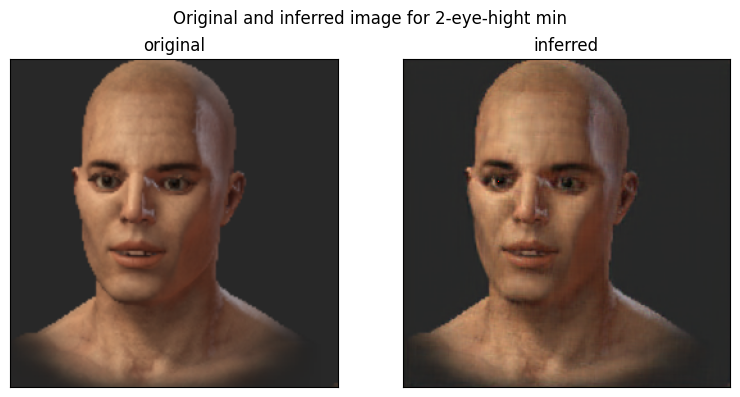

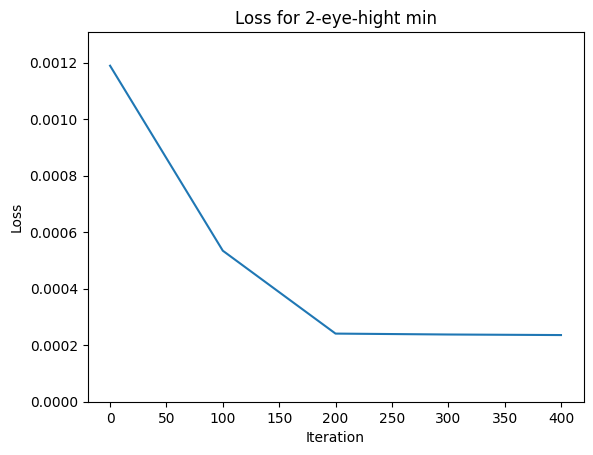

-----------------------------------
Parameter: 2-eye-hight max
Searching for z...
Iteration: 0, loss: 1.59E-03
Iteration: 100, loss: 2.46E-04
Iteration: 200, loss: 2.46E-04
Iteration: 300, loss: 2.46E-04
Iteration: 400, loss: 2.46E-04
Plotting results...


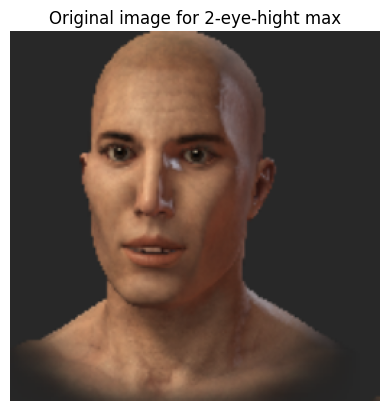

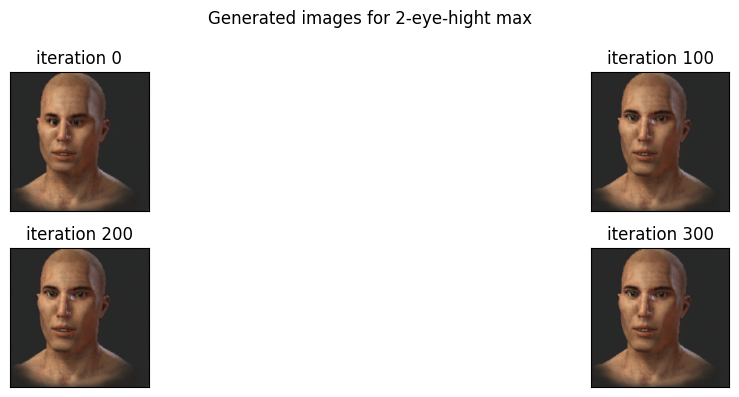

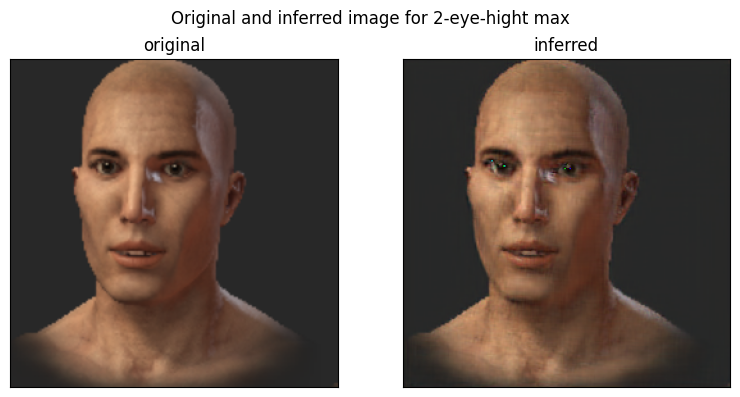

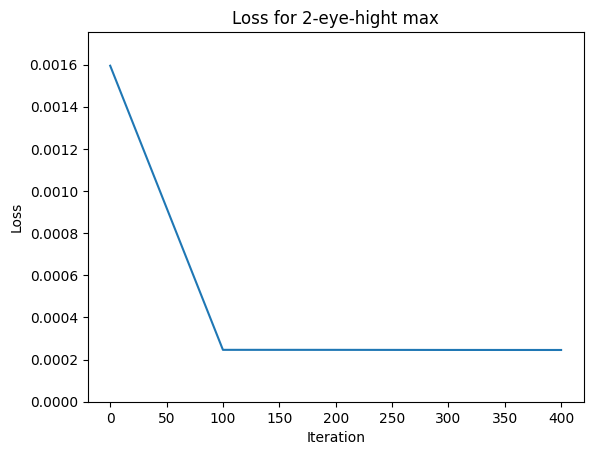

-----------------------------------
Parameter: 3-eye-angle min
Searching for z...
Iteration: 0, loss: 6.70E-04
Iteration: 100, loss: 3.32E-04
Iteration: 200, loss: 3.28E-04
Iteration: 300, loss: 3.27E-04
Iteration: 400, loss: 3.24E-04
Plotting results...


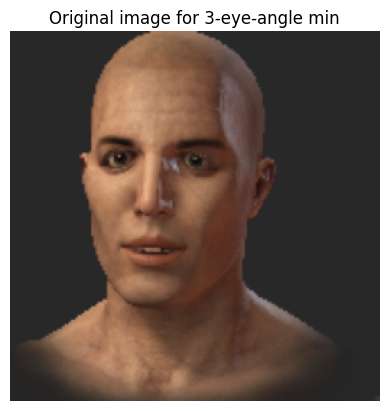

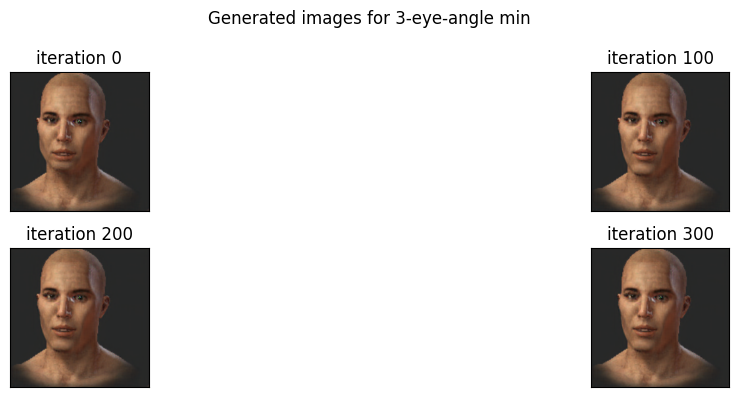

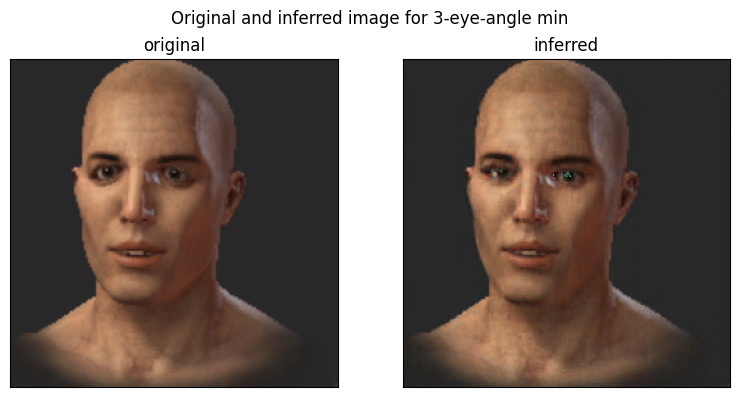

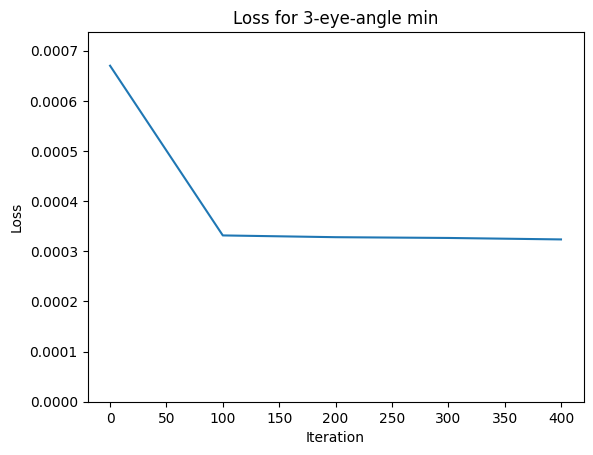

-----------------------------------
Parameter: 3-eye-angle max
Searching for z...
Iteration: 0, loss: 4.63E-04
Iteration: 100, loss: 3.25E-04
Iteration: 200, loss: 3.25E-04
Iteration: 300, loss: 3.25E-04
Iteration: 400, loss: 3.25E-04
Plotting results...


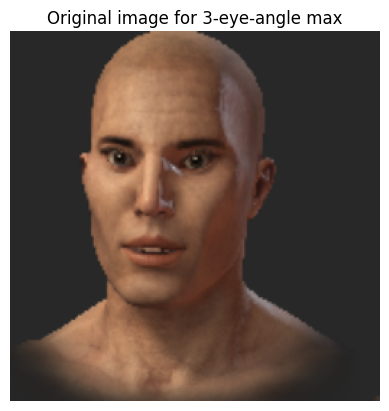

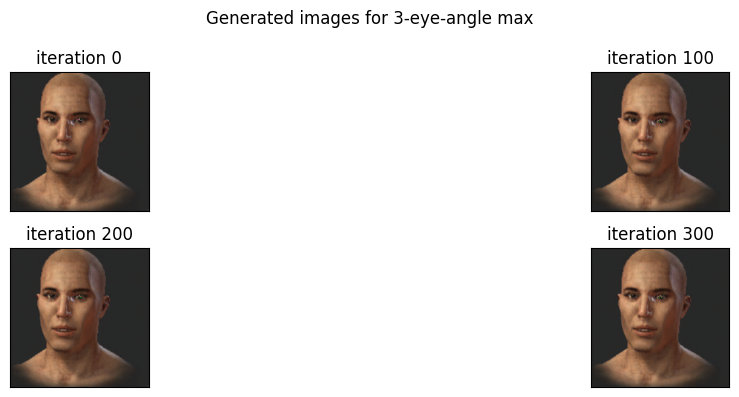

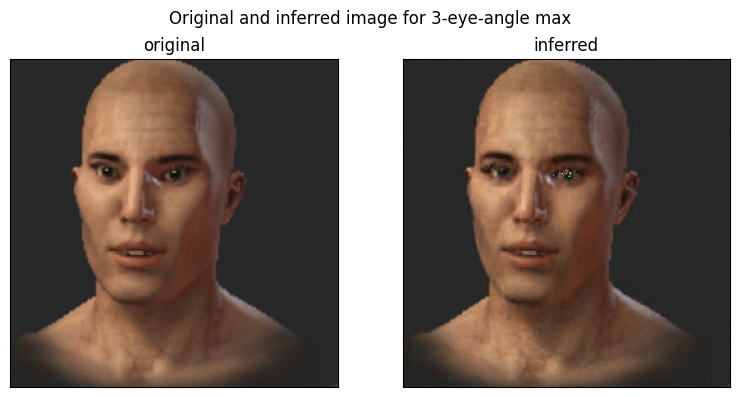

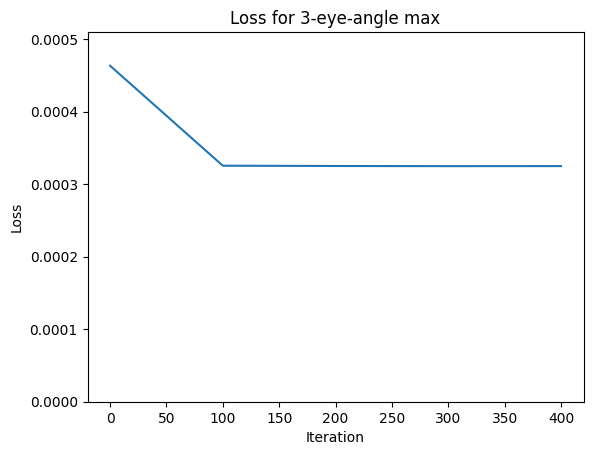

-----------------------------------
Parameter: 4-jaw-width min
Searching for z...
Iteration: 0, loss: 7.21E-04
Iteration: 100, loss: 2.38E-04
Iteration: 200, loss: 2.37E-04
Iteration: 300, loss: 2.36E-04
Iteration: 400, loss: 2.36E-04
Plotting results...


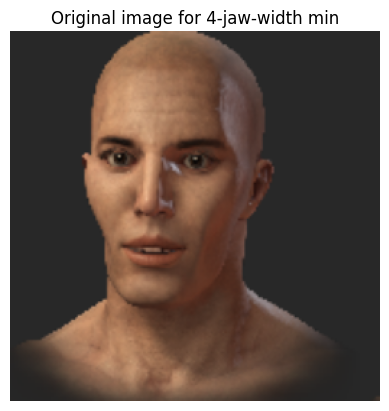

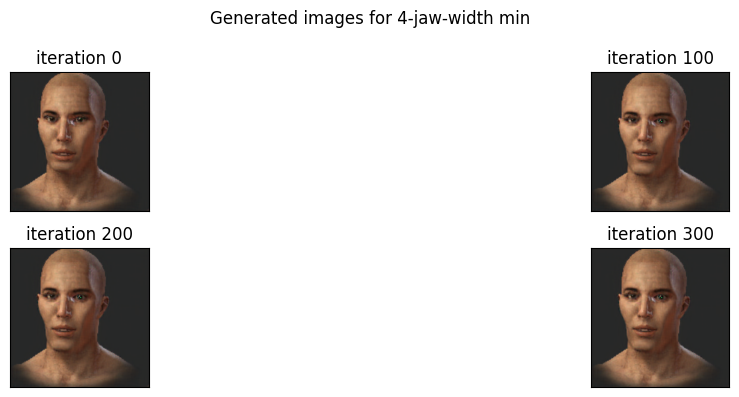

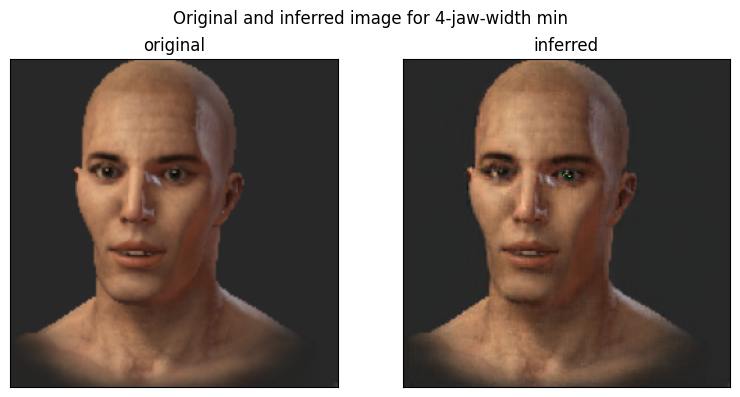

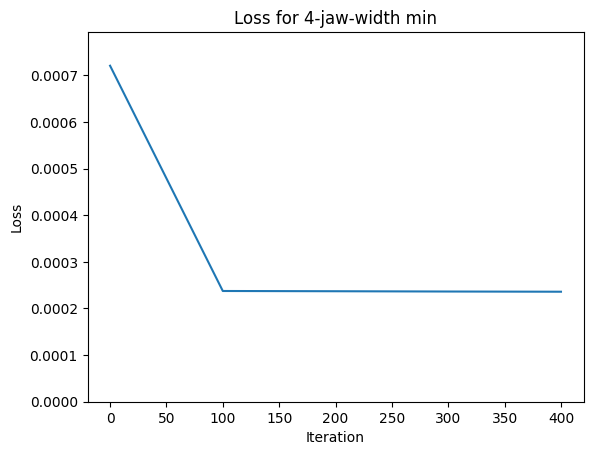

-----------------------------------
Parameter: 4-jaw-width max
Searching for z...
Iteration: 0, loss: 1.20E-03
Iteration: 100, loss: 1.08E-03
Iteration: 200, loss: 5.56E-04
Iteration: 300, loss: 5.50E-04
Iteration: 400, loss: 5.43E-04
Plotting results...


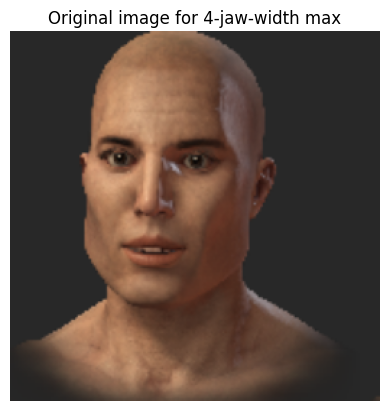

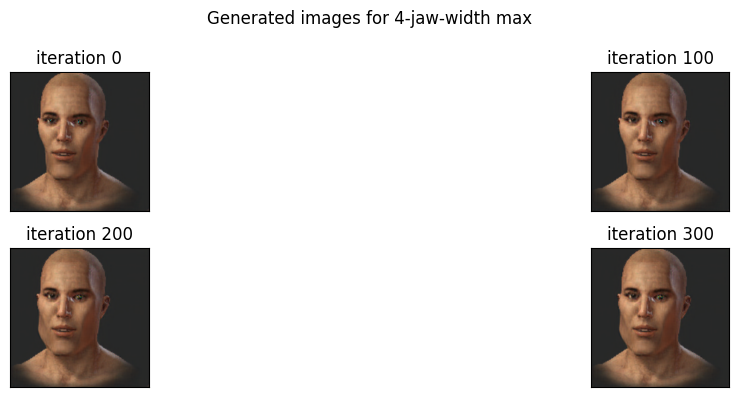

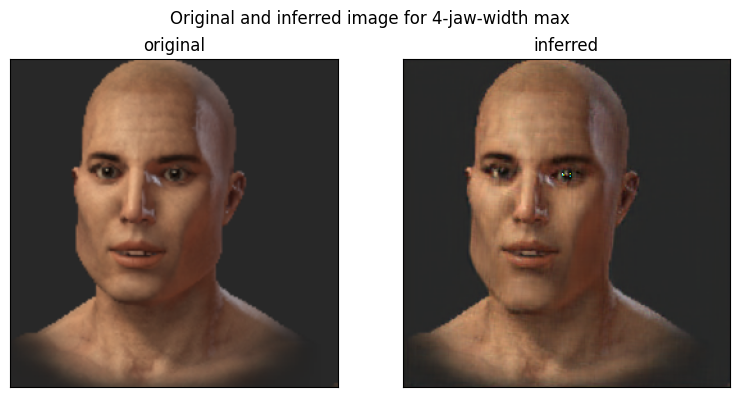

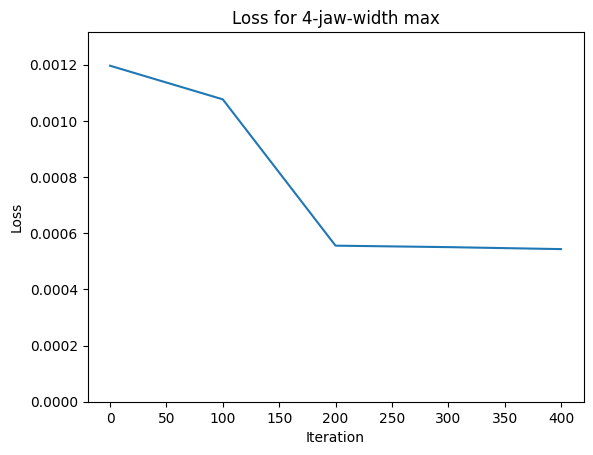

-----------------------------------
Parameter: 5-jaw-height min
Searching for z...
Iteration: 0, loss: 9.74E-04
Iteration: 100, loss: 2.73E-04
Iteration: 200, loss: 2.67E-04
Iteration: 300, loss: 2.63E-04
Iteration: 400, loss: 2.61E-04
Plotting results...


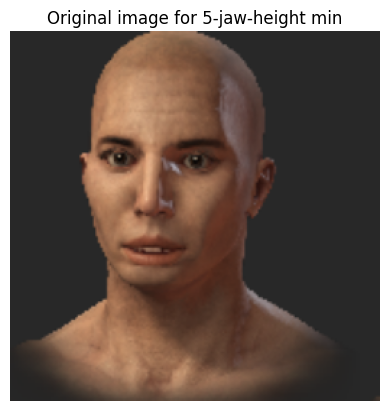

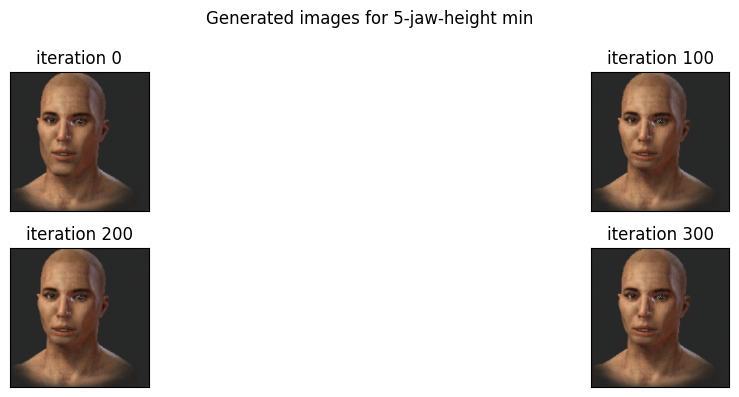

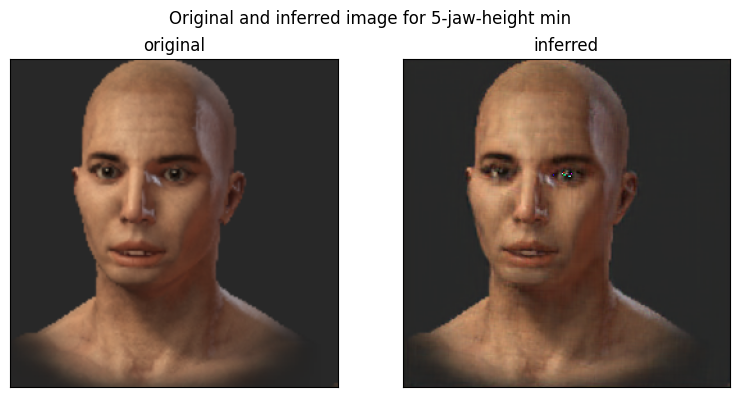

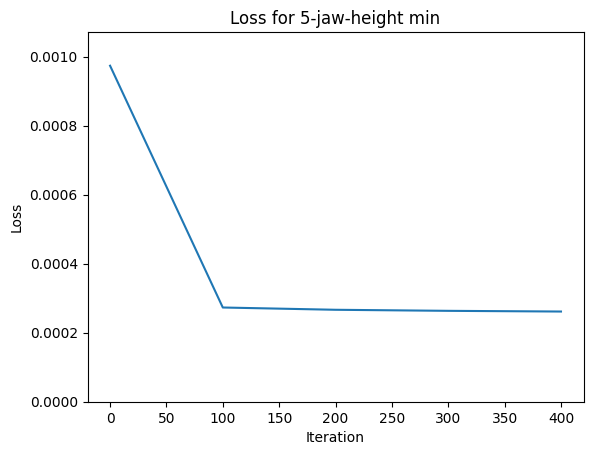

-----------------------------------
Parameter: 5-jaw-height max
Searching for z...
Iteration: 0, loss: 1.98E-03
Iteration: 100, loss: 1.15E-03
Iteration: 200, loss: 5.38E-04
Iteration: 300, loss: 5.31E-04
Iteration: 400, loss: 5.28E-04
Plotting results...


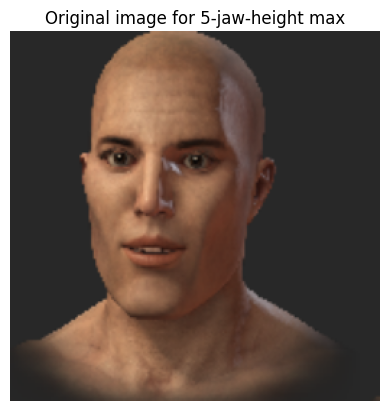

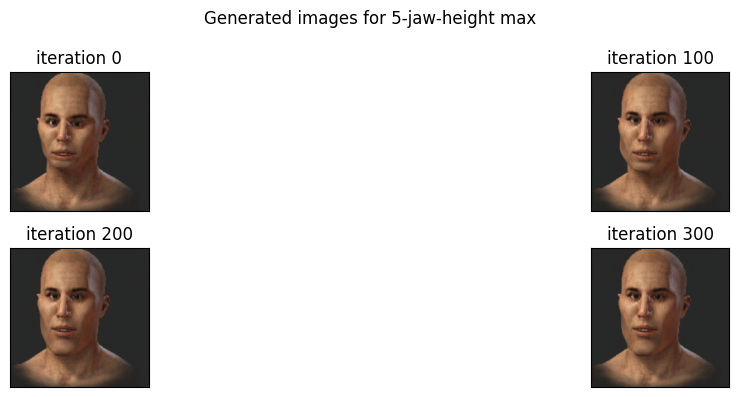

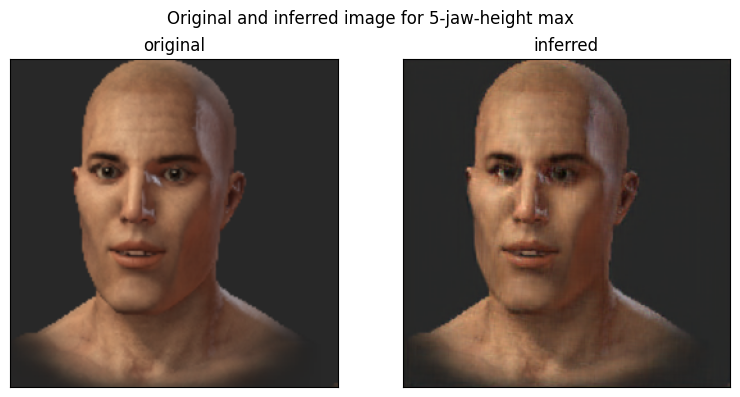

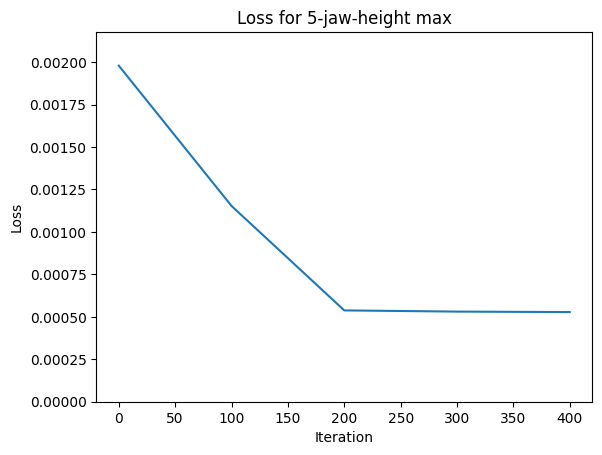

-----------------------------------


In [ ]:
for param_name, real_image_tensor in zip(param_names, min_and_max_image_tensors):
    prepare_plots_per_param(param_name, real_image_tensor, lr=10, iterations=500)

### How will the first Freddie Mercury be inferred?



Parameter: Perfect Freddie Mercury
Searching for z...
Iteration: 0, loss: 2.29E-03
Iteration: 100, loss: 1.88E-03
Iteration: 200, loss: 1.78E-03
Iteration: 300, loss: 1.71E-03
Iteration: 400, loss: 1.65E-03
Iteration: 500, loss: 1.59E-03
Iteration: 600, loss: 1.57E-03
Iteration: 700, loss: 1.55E-03
Iteration: 800, loss: 1.53E-03
Iteration: 900, loss: 1.53E-03
Iteration: 1000, loss: 1.53E-03
Iteration: 1100, loss: 1.53E-03
Iteration: 1200, loss: 1.53E-03
Iteration: 1300, loss: 1.53E-03
Iteration: 1400, loss: 1.53E-03
Iteration: 1500, loss: 1.53E-03
Iteration: 1600, loss: 1.53E-03
Iteration: 1700, loss: 1.53E-03
Iteration: 1800, loss: 1.53E-03
Iteration: 1900, loss: 1.53E-03
Plotting results...


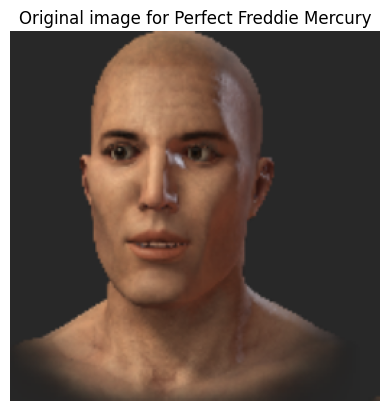

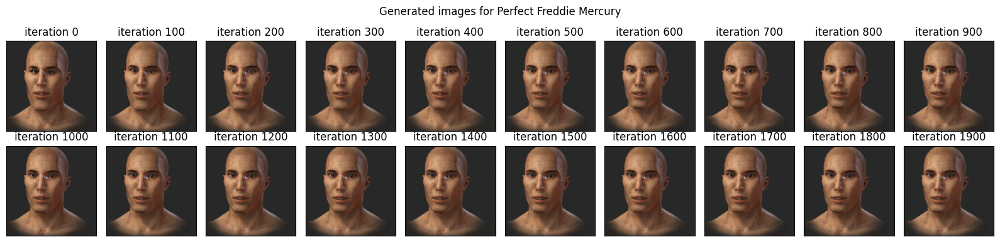

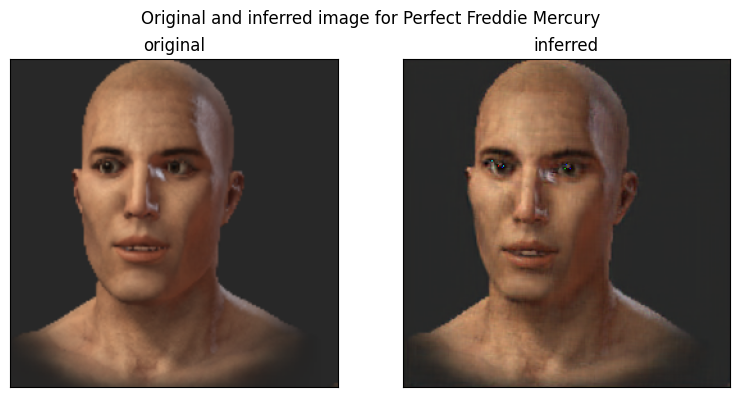

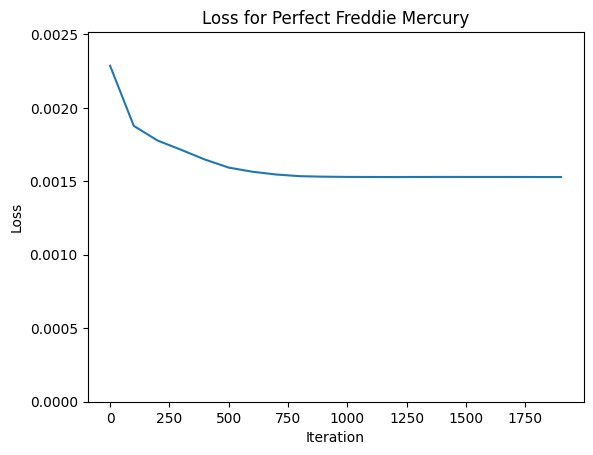

-----------------------------------


(tensor([[-9.6238e-01,  3.2582e-01,  3.4303e-01, -2.9335e+00, -7.2642e-01,
          -1.3227e+00, -6.5361e-01,  9.2173e-01,  4.0584e-01,  4.7057e-01,
          -3.9096e-02,  3.0000e-01,  3.4544e-01, -1.7382e+00, -8.2667e-02,
          -1.2387e+00,  4.1233e-01, -3.3065e-01, -9.3611e-01, -1.1962e+00,
          -3.7971e-01, -9.1704e-01,  1.6832e+00,  7.6316e-01, -1.2540e-01,
           1.6880e-01,  1.0938e+00, -1.7629e-01,  9.3373e-01,  3.7126e-01,
           9.6536e-01,  1.2881e+00,  1.2902e+00,  3.6626e-01, -6.9724e-01,
           1.5998e+00,  1.2689e+00,  2.0580e+00,  8.6197e-01,  7.5652e-01,
          -2.0504e-01, -6.8117e-01, -1.6092e-01, -4.7861e-01,  1.1345e+00,
           2.4018e+00,  3.2503e-01,  5.0779e-01, -1.1738e+00,  7.3099e-01,
          -4.0734e-01,  5.0224e-01,  3.3757e-01,  3.5224e-02, -8.0747e-01,
          -2.3793e-01,  9.5136e-01,  1.8427e+00, -1.8082e+00, -2.2722e-01,
           4.8767e-01,  7.2767e-02, -1.0952e-02, -2.0664e+00, -8.6701e-01,
           8.3663e-01, -1

In [ ]:
perfect_freddie_image = prep_image("img/from_dataset/perfect_mercury.png")

prepare_plots_per_param("Perfect Freddie Mercury", perfect_freddie_image, lr=1, iterations=2000)


## 3. What to do when current workflow is not enough?

### A. Just train the model more...

I've trained the model more throuout the night. After another 6 hours of training the generator has been sometimes yielding more realisticlly looking Freddie Mercuries, sometimes not; sometimes mode collapse was apparent, sometimes all the eyes have been all "melted" (*there's something about their eyes...*). After looking at some examples and seeing a big valley on discriminators loss on around 9000th iteration [see picture below]. I've decided to go with model from this iteration.

![Valley](img/midnight-run.png)

(For short the plot plummeted just before the 9000th iteration)

![9000th Freddies](img/generated/9000th_iteration.jpg)

(Iteration 9000th output sample)


I will try 

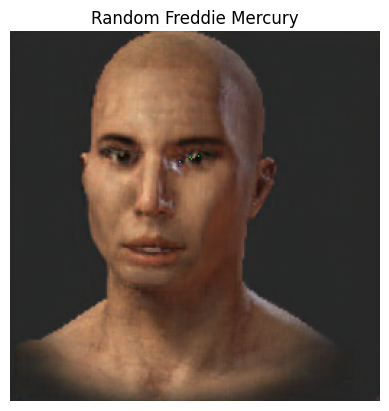

In [ ]:
MODEL_9000_PATH = "model/model_mercury_5_param_9000.pt"
generator_9000 = import_generator(MODEL_PATH)
# print(generator)   In case of emergency diff check with the original evaluation
## TODO save only the generator, not the whole model

random_latent_vectors = torch.randn( (1, LATENT_DIM) ).cuda(0)
generated_images = generator_9000(random_latent_vectors)
show_tensor_picture(generated_images[0], title="Random Freddie Mercury")

#### Middle face search

In [ ]:
middle_image = prep_image("img/from_dataset/middle_mercury.png")

middle_z, middle_checkpoints, middle_losses = find_z(middle_image, generator_9000, iterations=1000, lr=1, checkpoint_step=100)



Iteration: 0, loss: 1.85E-03
Iteration: 100, loss: 9.22E-04
Iteration: 200, loss: 6.63E-04
Iteration: 300, loss: 5.19E-04
Iteration: 400, loss: 4.96E-04
Iteration: 500, loss: 4.93E-04
Iteration: 600, loss: 4.92E-04
Iteration: 700, loss: 4.92E-04
Iteration: 800, loss: 4.91E-04
Iteration: 900, loss: 4.91E-04


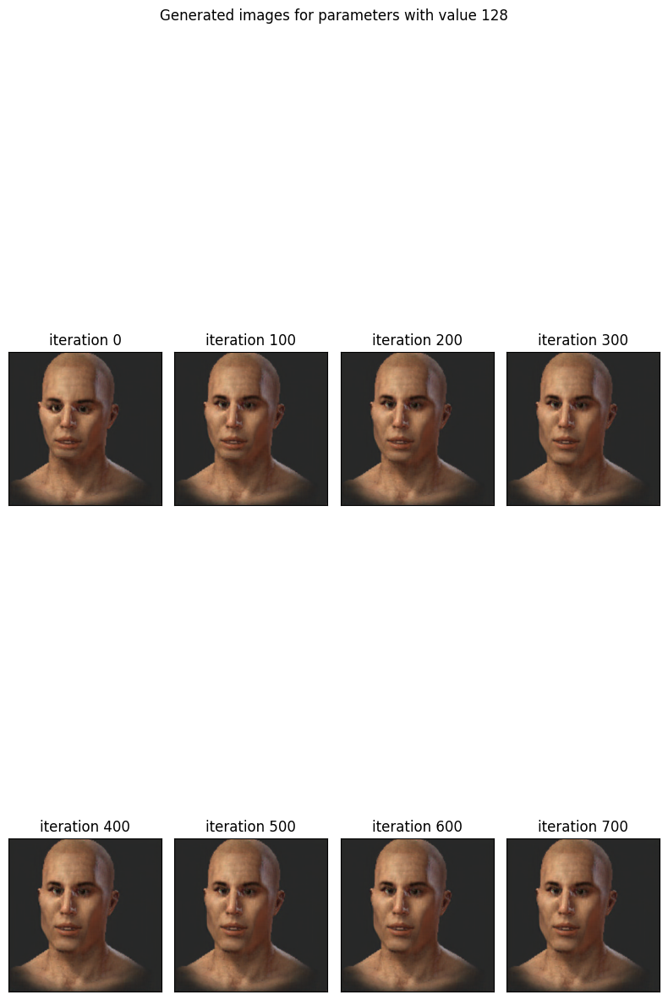

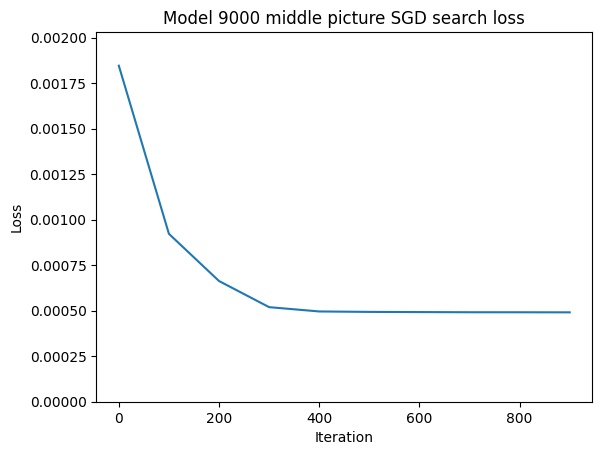

In [ ]:
plot_images([checkpoint for _, checkpoint in middle_checkpoints],
            [f"iteration {checkpoint_n}" for checkpoint_n, _ in middle_checkpoints],
            nrows=len(middle_checkpoints)//4, ncols=4,
            title="Generated images for parameters with value 128", figsize=[8, 16])

plot_loss(middle_losses, [i for i, _ in middle_checkpoints], title="Model 9000 middle picture SGD search loss")

#### Finding extreme parameters

**Starting with middle z**

In [ ]:
z_init = middle_z.detach().clone()



Parameter: 1-eye-distance min
Searching for z...
Iteration: 0, loss: 6.06E-04
Iteration: 100, loss: 6.05E-04
Iteration: 200, loss: 6.06E-04
Iteration: 300, loss: 6.05E-04
Iteration: 400, loss: 6.05E-04
Plotting results...


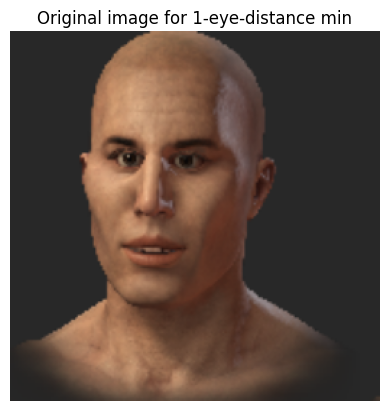

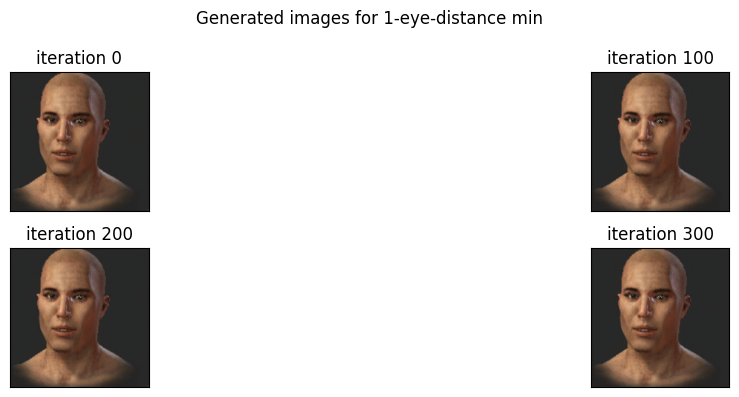

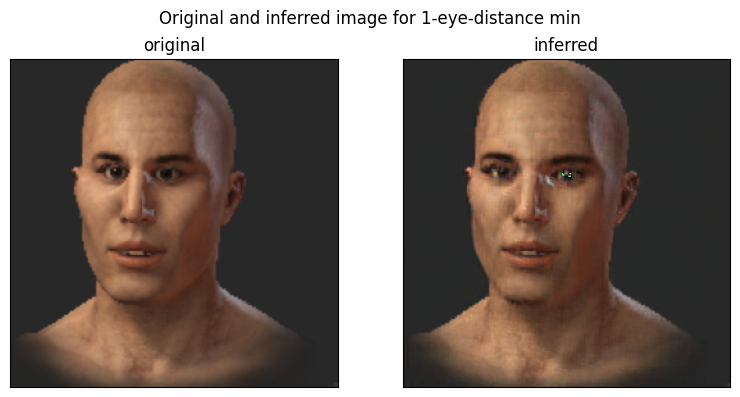

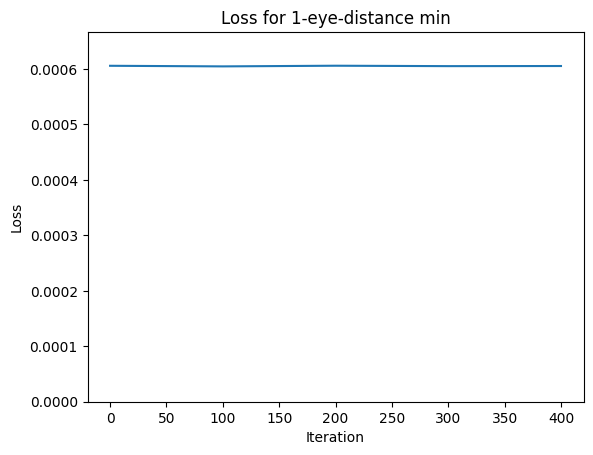

-----------------------------------
Parameter: 1-eye-distance max
Searching for z...
Iteration: 0, loss: 4.79E-04
Iteration: 100, loss: 4.79E-04
Iteration: 200, loss: 4.78E-04
Iteration: 300, loss: 4.78E-04
Iteration: 400, loss: 4.78E-04
Plotting results...


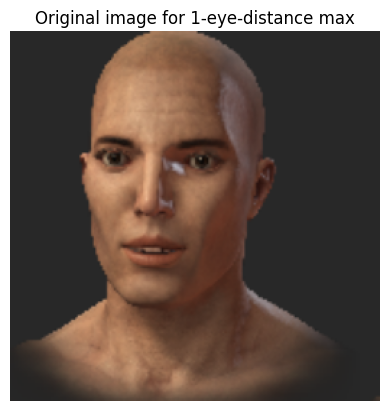

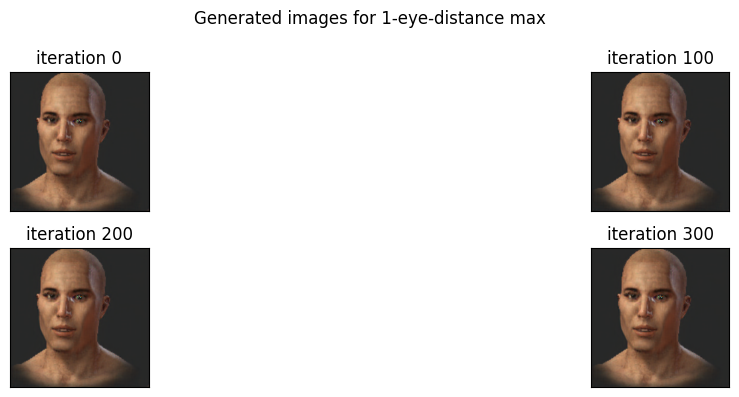

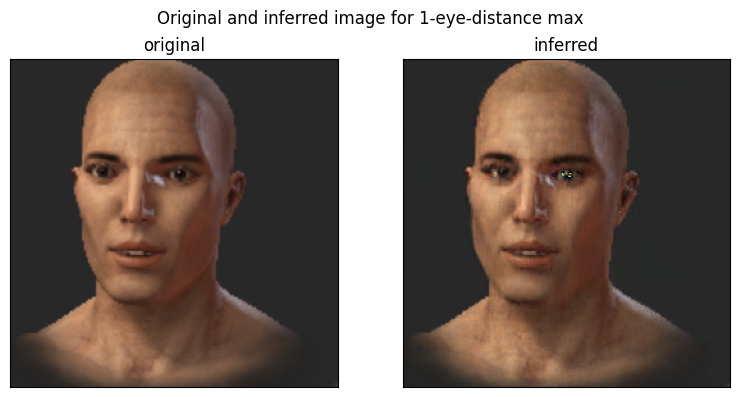

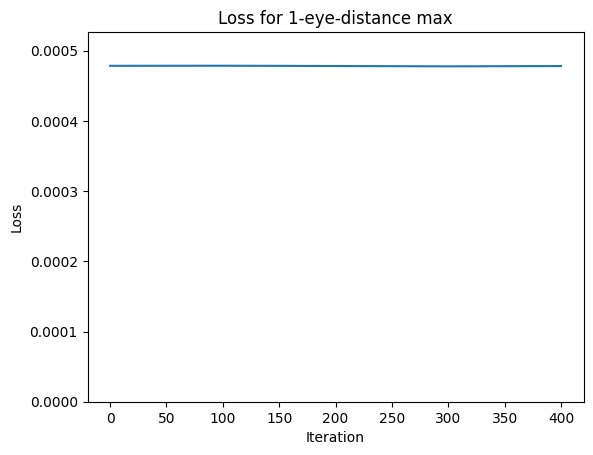

-----------------------------------
Parameter: 2-eye-hight min
Searching for z...
Iteration: 0, loss: 1.52E-03
Iteration: 100, loss: 1.52E-03
Iteration: 200, loss: 1.52E-03
Iteration: 300, loss: 1.52E-03
Iteration: 400, loss: 1.52E-03
Plotting results...


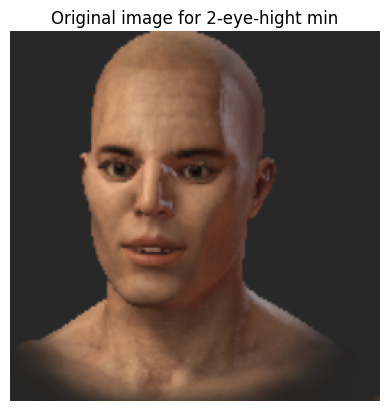

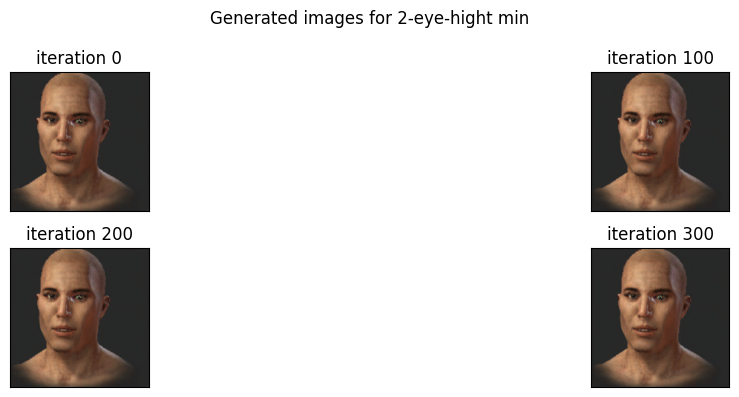

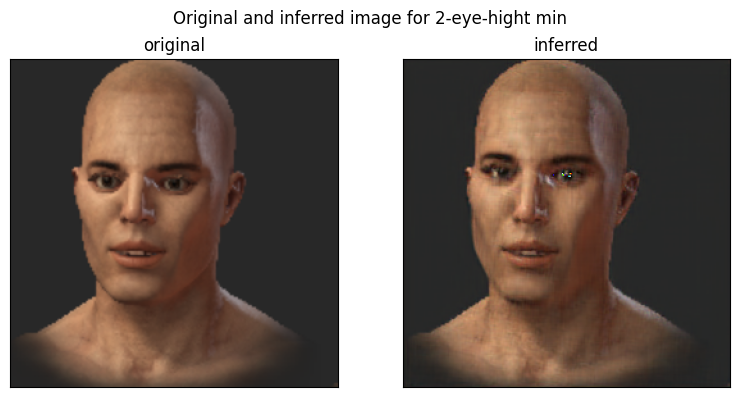

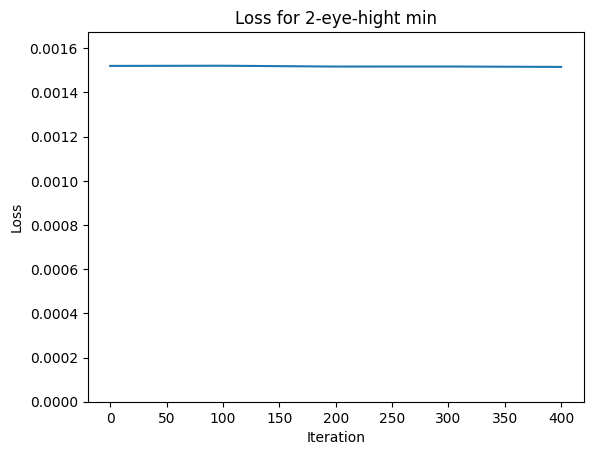

-----------------------------------
Parameter: 2-eye-hight max
Searching for z...
Iteration: 0, loss: 8.82E-04
Iteration: 100, loss: 8.84E-04
Iteration: 200, loss: 8.82E-04
Iteration: 300, loss: 8.82E-04
Iteration: 400, loss: 8.79E-04
Plotting results...


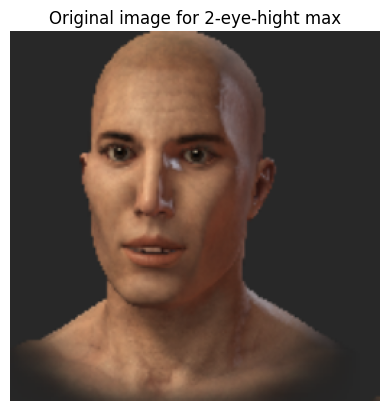

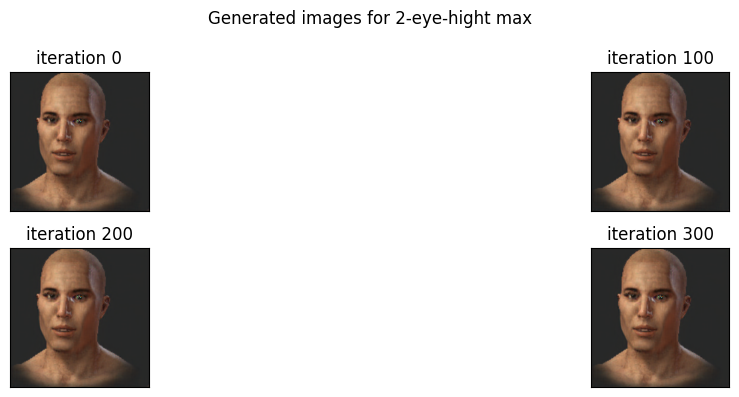

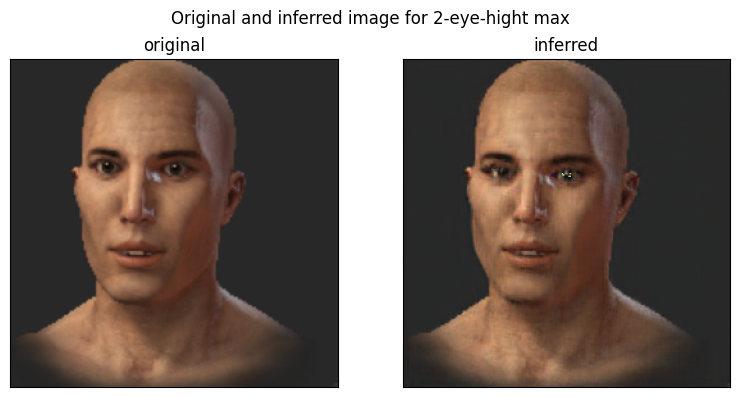

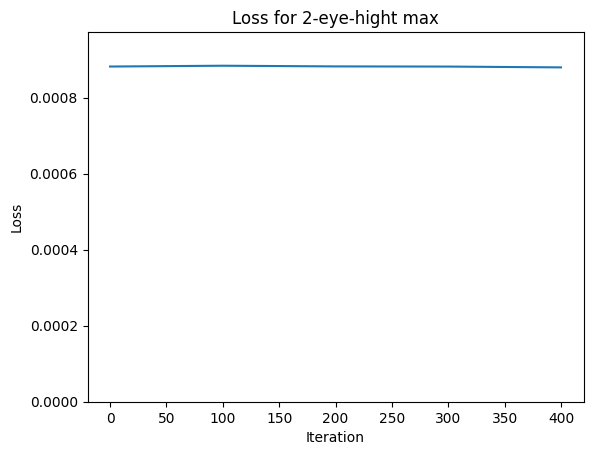

-----------------------------------
Parameter: 3-eye-angle min
Searching for z...
Iteration: 0, loss: 4.14E-04
Iteration: 100, loss: 4.16E-04
Iteration: 200, loss: 4.13E-04
Iteration: 300, loss: 4.14E-04
Iteration: 400, loss: 4.16E-04
Plotting results...


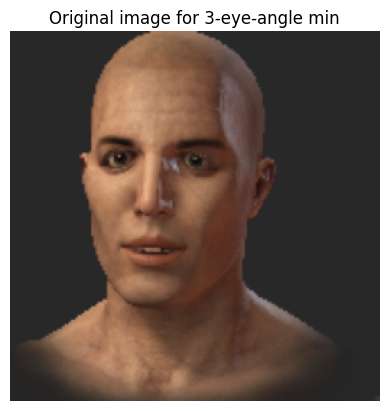

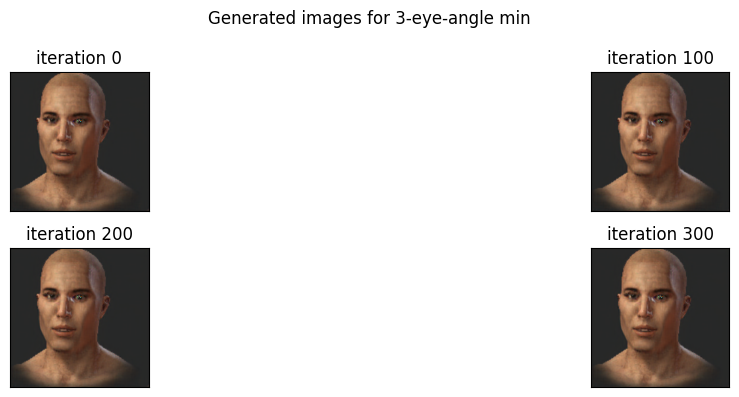

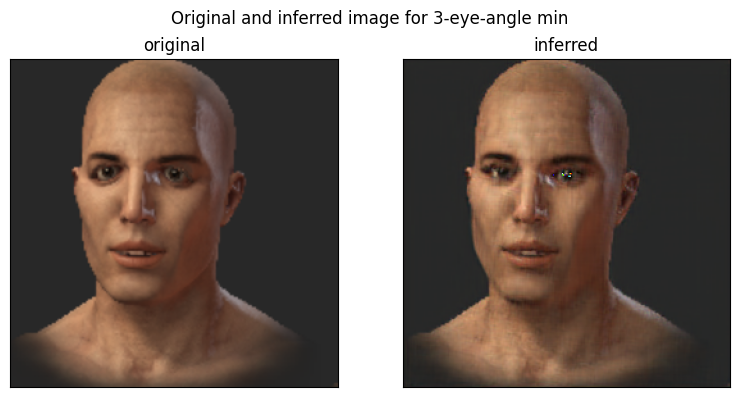

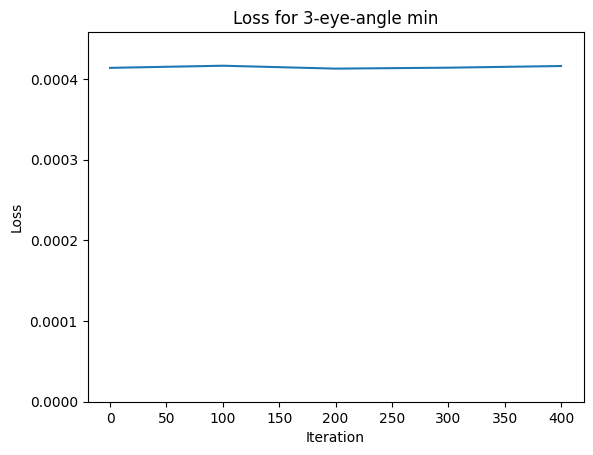

-----------------------------------
Parameter: 3-eye-angle max
Searching for z...
Iteration: 0, loss: 3.75E-04
Iteration: 100, loss: 3.75E-04
Iteration: 200, loss: 3.74E-04
Iteration: 300, loss: 3.75E-04
Iteration: 400, loss: 3.74E-04
Plotting results...


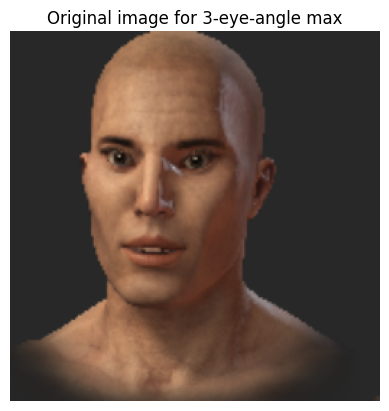

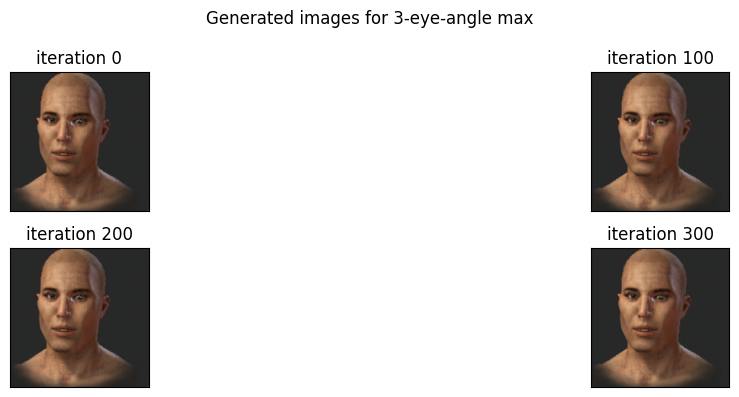

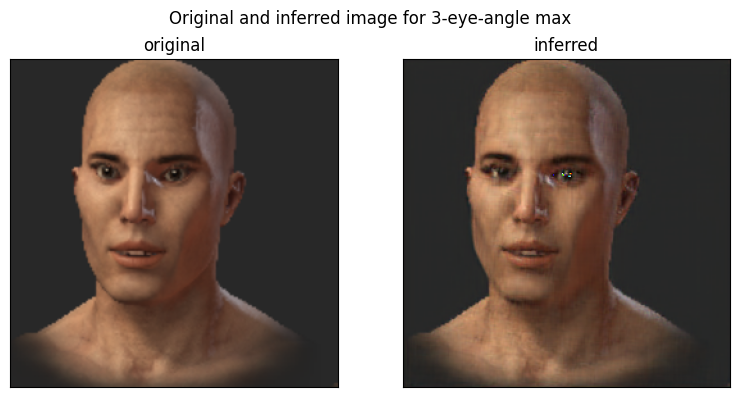

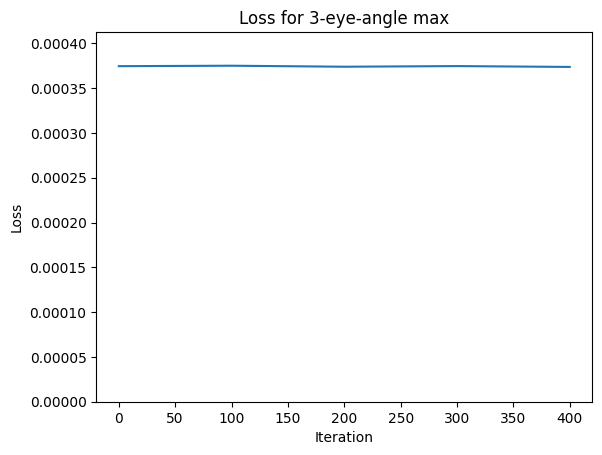

-----------------------------------
Parameter: 4-jaw-width min
Searching for z...
Iteration: 0, loss: 6.11E-04
Iteration: 100, loss: 6.11E-04
Iteration: 200, loss: 6.12E-04
Iteration: 300, loss: 6.12E-04
Iteration: 400, loss: 6.12E-04
Plotting results...


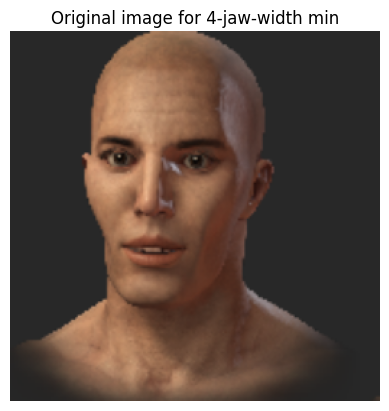

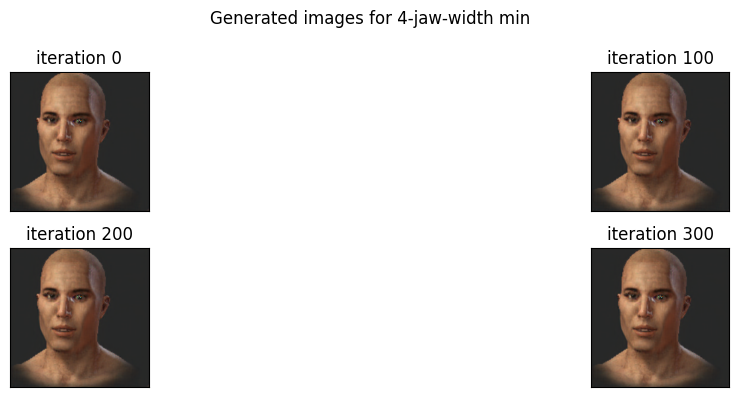

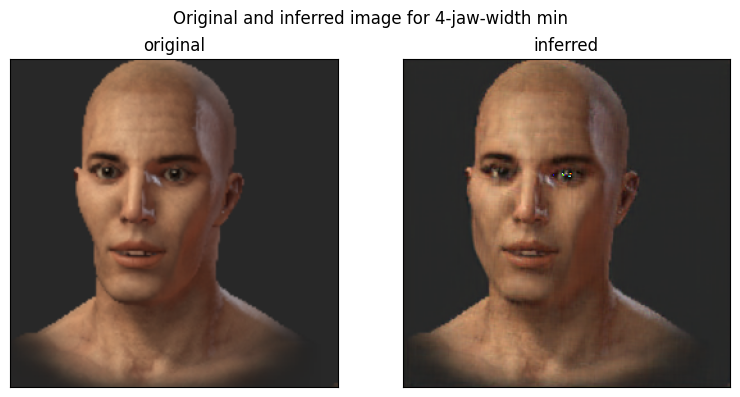

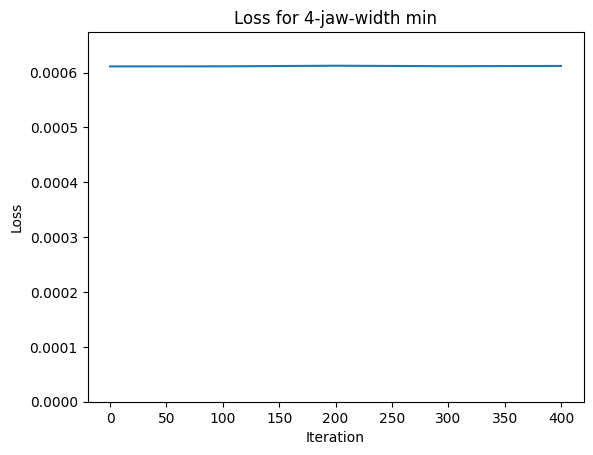

-----------------------------------
Parameter: 4-jaw-width max
Searching for z...
Iteration: 0, loss: 4.34E-04
Iteration: 100, loss: 4.33E-04
Iteration: 200, loss: 4.34E-04
Iteration: 300, loss: 4.34E-04
Iteration: 400, loss: 4.34E-04
Plotting results...


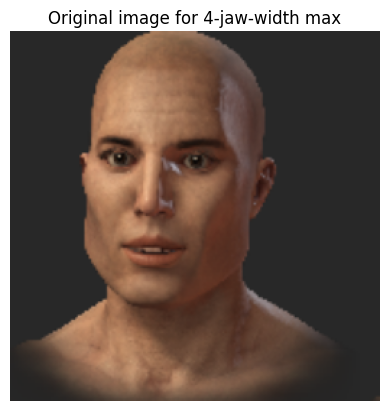

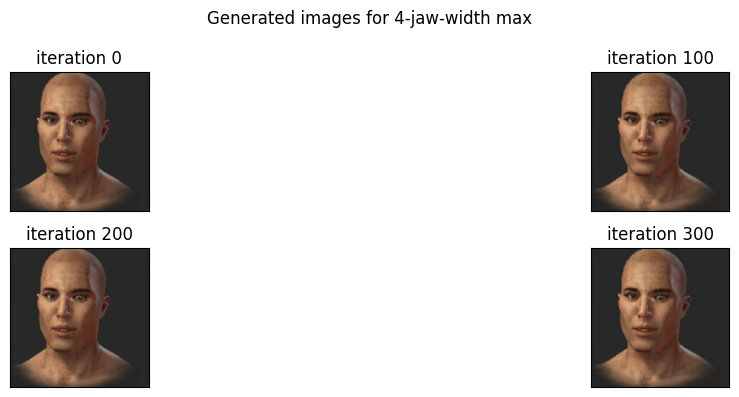

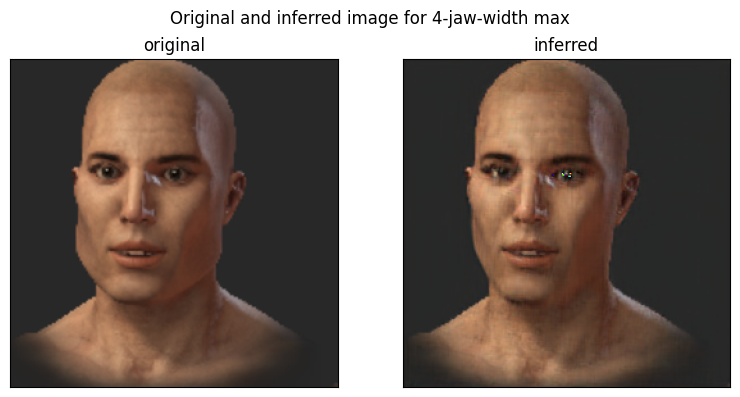

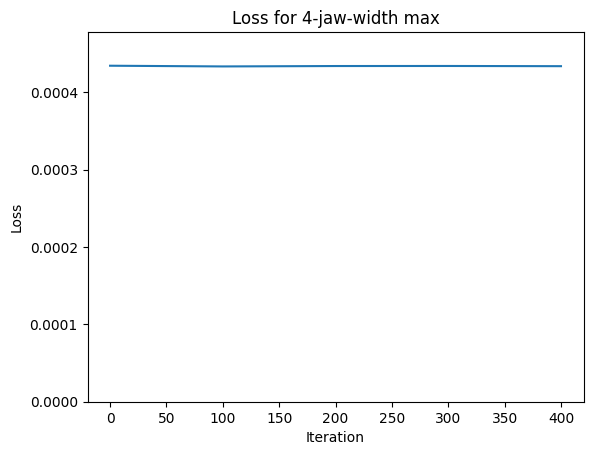

-----------------------------------
Parameter: 5-jaw-height min
Searching for z...
Iteration: 0, loss: 1.01E-03
Iteration: 100, loss: 1.01E-03
Iteration: 200, loss: 1.01E-03
Iteration: 300, loss: 1.01E-03
Iteration: 400, loss: 1.01E-03
Plotting results...


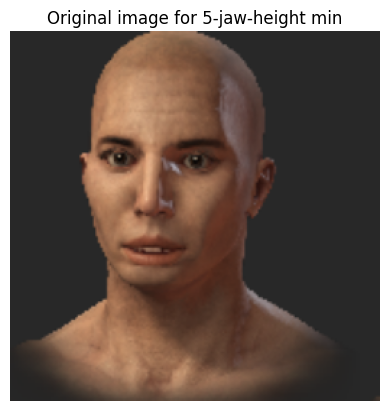

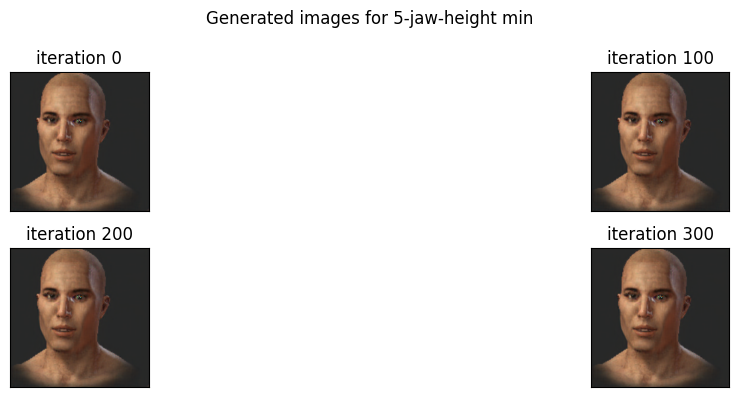

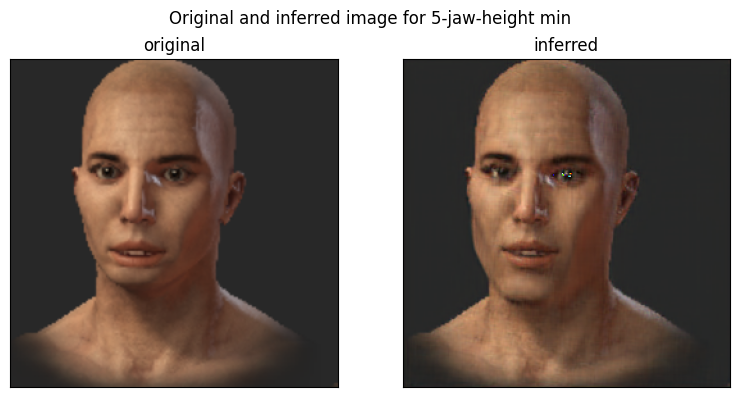

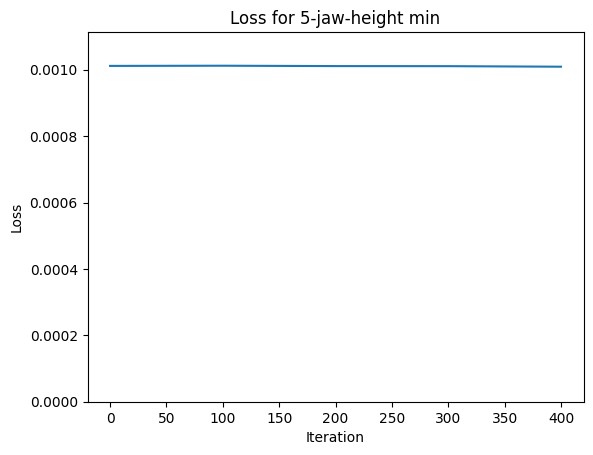

-----------------------------------
Parameter: 5-jaw-height max
Searching for z...
Iteration: 0, loss: 5.76E-04
Iteration: 100, loss: 5.75E-04
Iteration: 200, loss: 5.73E-04
Iteration: 300, loss: 5.75E-04
Iteration: 400, loss: 5.75E-04
Plotting results...


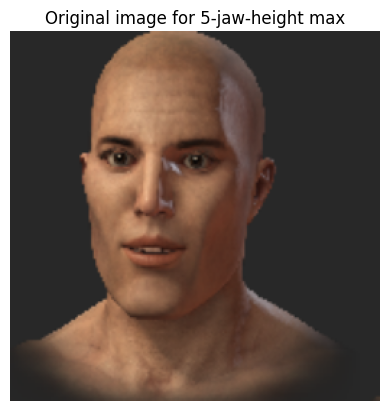

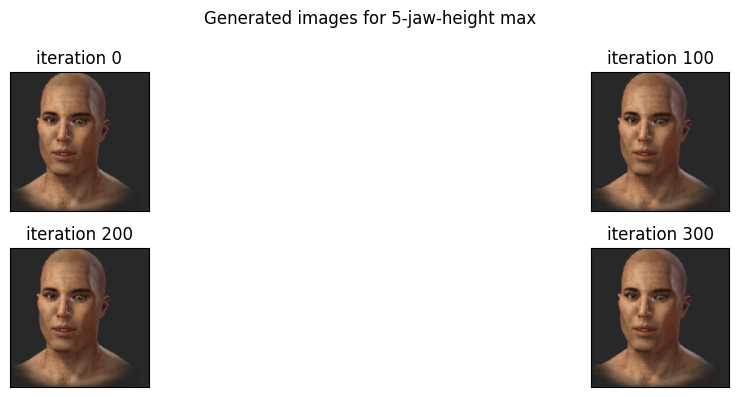

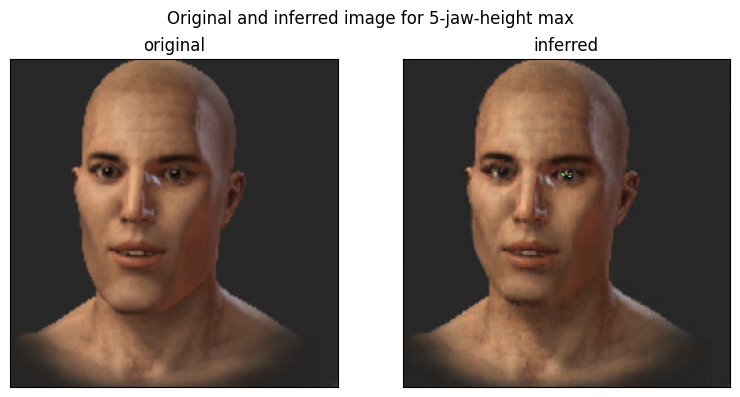

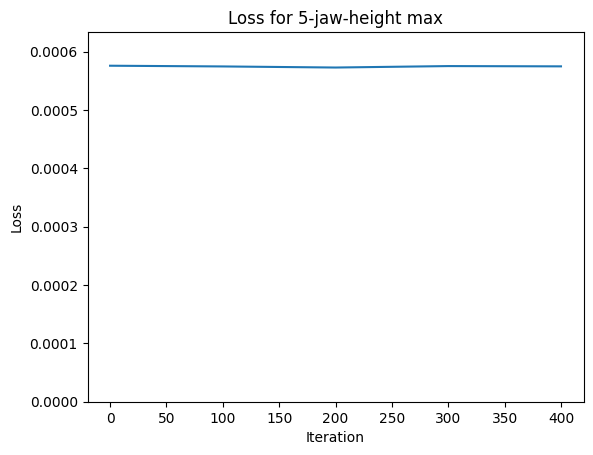

-----------------------------------


In [ ]:
for param_name, real_image_tensor in zip(param_names, min_and_max_image_tensors):
    prepare_plots_per_param(param_name, real_image_tensor, generator=generator_9000, z_init=z_init, lr=1, iterations=500)

#### Starting from random

Parameter: 1-eye-distance min
Searching for z...
Iteration: 0, loss: 1.82E-03
Iteration: 100, loss: 5.38E-04
Iteration: 200, loss: 3.16E-04
Iteration: 300, loss: 2.33E-04
Iteration: 400, loss: 2.12E-04
Iteration: 500, loss: 2.10E-04
Iteration: 600, loss: 2.10E-04
Iteration: 700, loss: 2.10E-04
Iteration: 800, loss: 2.10E-04
Iteration: 900, loss: 2.10E-04
Iteration: 1000, loss: 2.10E-04
Iteration: 1100, loss: 2.10E-04
Iteration: 1200, loss: 2.10E-04
Iteration: 1300, loss: 2.09E-04
Iteration: 1400, loss: 2.10E-04
Iteration: 1500, loss: 2.10E-04
Iteration: 1600, loss: 2.09E-04
Iteration: 1700, loss: 2.10E-04
Iteration: 1800, loss: 2.09E-04
Iteration: 1900, loss: 2.10E-04
Plotting results...


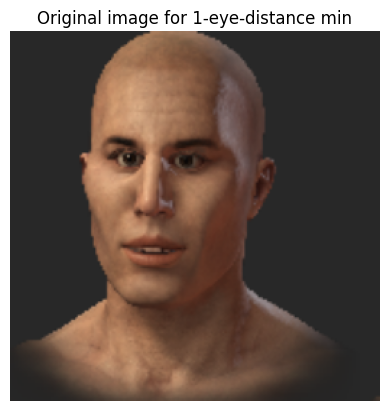

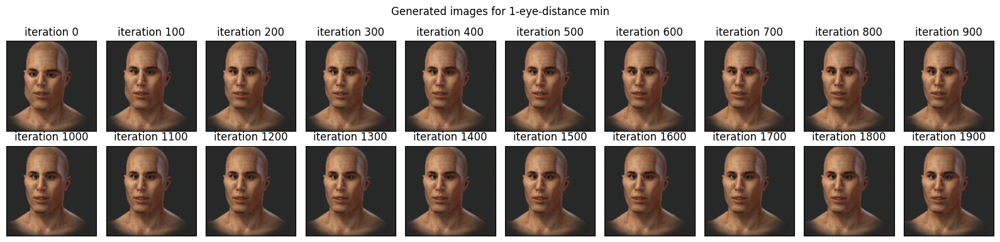

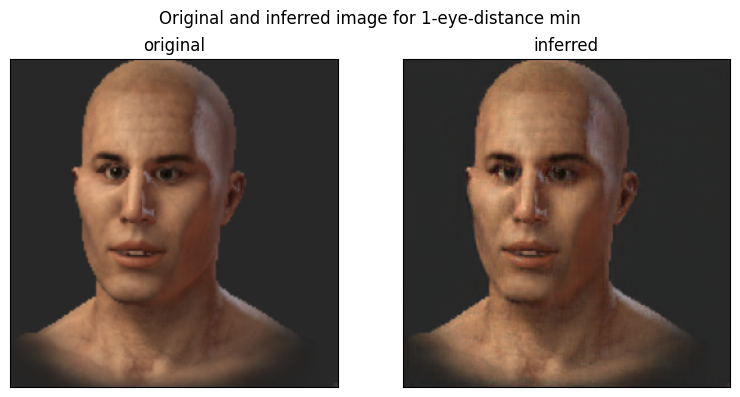

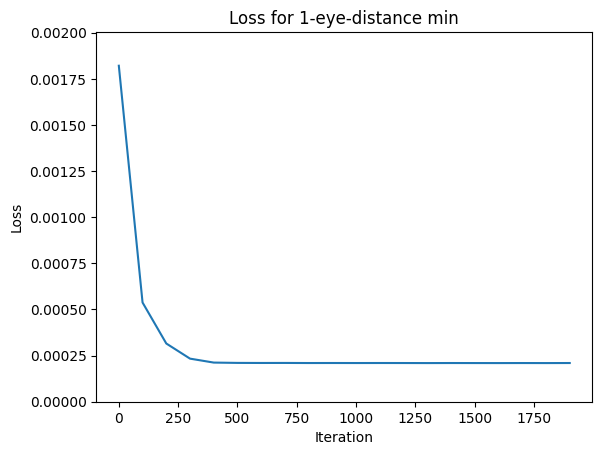

-----------------------------------
Parameter: 1-eye-distance max
Searching for z...
Iteration: 0, loss: 6.53E-04
Iteration: 100, loss: 5.56E-04
Iteration: 200, loss: 4.02E-04
Iteration: 300, loss: 4.03E-04
Iteration: 400, loss: 4.01E-04
Iteration: 500, loss: 4.01E-04
Iteration: 600, loss: 4.00E-04
Iteration: 700, loss: 4.00E-04
Iteration: 800, loss: 4.00E-04
Iteration: 900, loss: 4.00E-04
Iteration: 1000, loss: 4.01E-04
Iteration: 1100, loss: 3.99E-04
Iteration: 1200, loss: 3.99E-04
Iteration: 1300, loss: 3.99E-04
Iteration: 1400, loss: 3.99E-04
Iteration: 1500, loss: 3.98E-04
Iteration: 1600, loss: 3.98E-04
Iteration: 1700, loss: 3.98E-04
Iteration: 1800, loss: 3.99E-04
Iteration: 1900, loss: 3.98E-04
Plotting results...


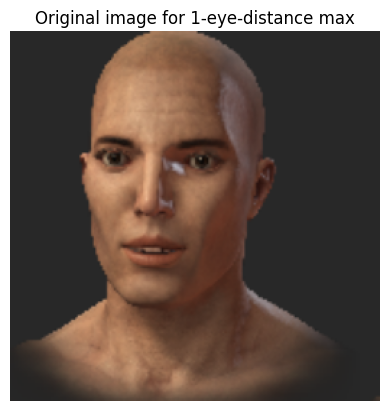

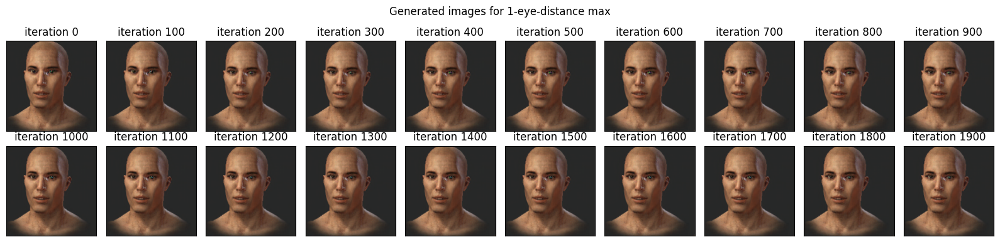

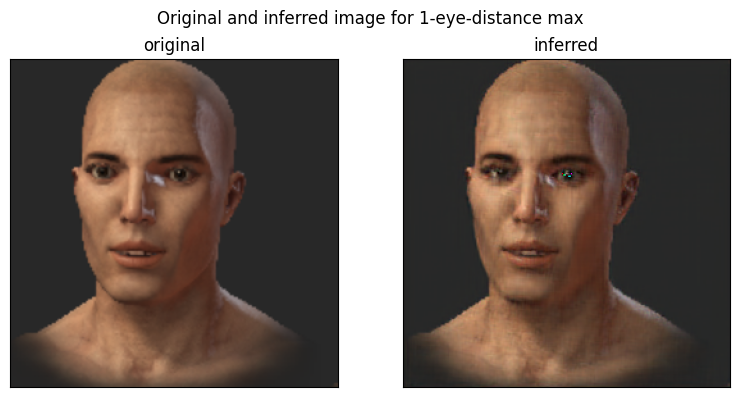

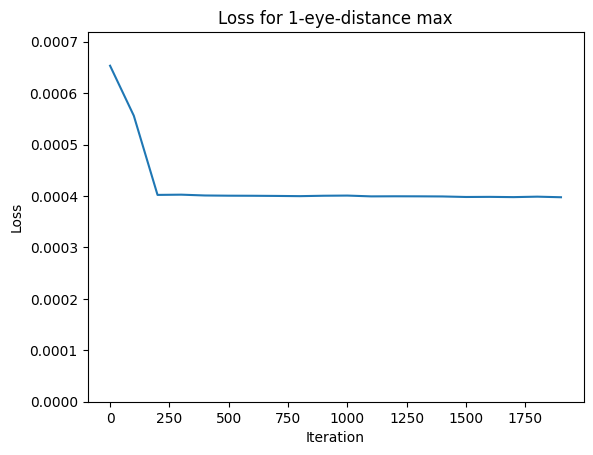

-----------------------------------
Parameter: 2-eye-hight min
Searching for z...
Iteration: 0, loss: 2.11E-03
Iteration: 100, loss: 1.59E-03
Iteration: 200, loss: 1.34E-03
Iteration: 300, loss: 1.14E-03
Iteration: 400, loss: 9.76E-04
Iteration: 500, loss: 7.99E-04
Iteration: 600, loss: 6.55E-04
Iteration: 700, loss: 5.32E-04
Iteration: 800, loss: 4.17E-04
Iteration: 900, loss: 2.86E-04
Iteration: 1000, loss: 2.56E-04
Iteration: 1100, loss: 2.51E-04
Iteration: 1200, loss: 2.50E-04
Iteration: 1300, loss: 2.49E-04
Iteration: 1400, loss: 2.49E-04
Iteration: 1500, loss: 2.48E-04
Iteration: 1600, loss: 2.48E-04
Iteration: 1700, loss: 2.47E-04
Iteration: 1800, loss: 2.47E-04
Iteration: 1900, loss: 2.46E-04
Plotting results...


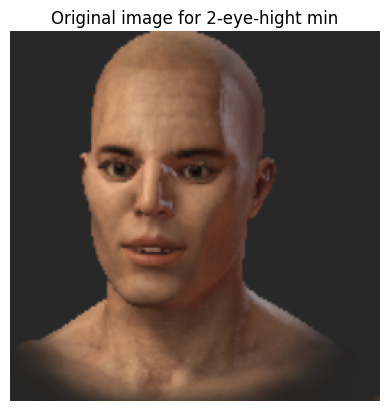

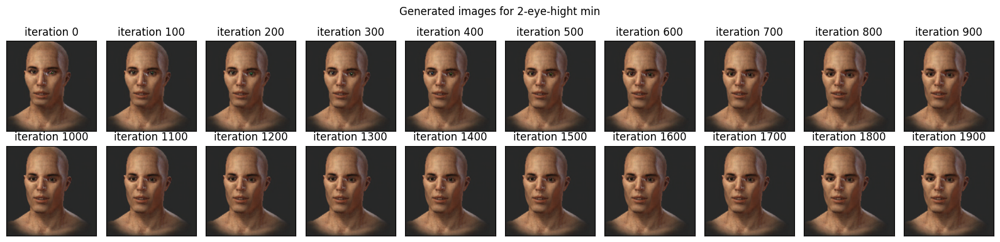

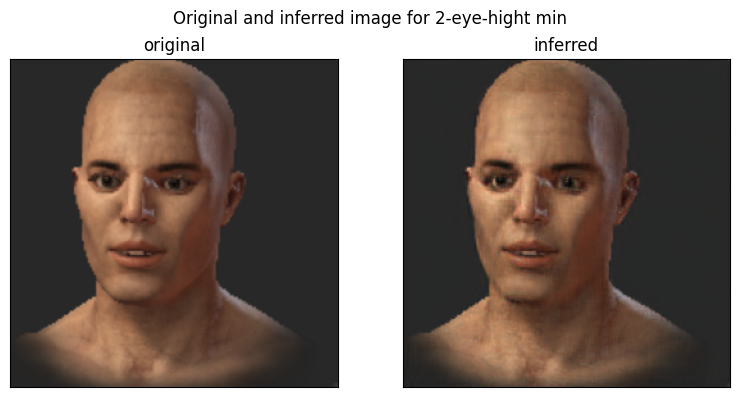

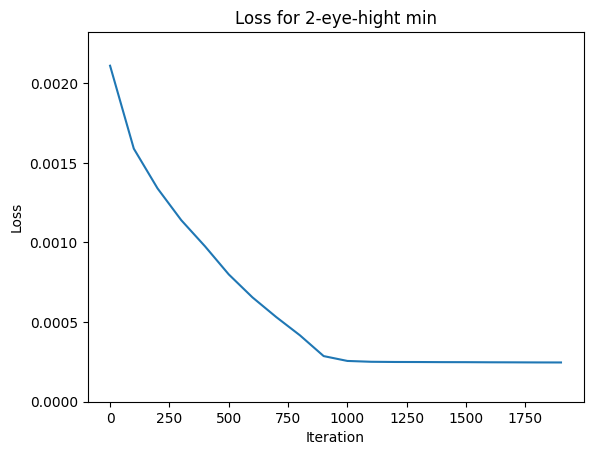

-----------------------------------
Parameter: 2-eye-hight max
Searching for z...
Iteration: 0, loss: 1.07E-03
Iteration: 100, loss: 3.99E-04
Iteration: 200, loss: 2.65E-04
Iteration: 300, loss: 2.52E-04
Iteration: 400, loss: 2.48E-04
Iteration: 500, loss: 2.46E-04
Iteration: 600, loss: 2.46E-04
Iteration: 700, loss: 2.45E-04
Iteration: 800, loss: 2.45E-04
Iteration: 900, loss: 2.45E-04
Iteration: 1000, loss: 2.44E-04
Iteration: 1100, loss: 2.44E-04
Iteration: 1200, loss: 2.44E-04
Iteration: 1300, loss: 2.43E-04
Iteration: 1400, loss: 2.43E-04
Iteration: 1500, loss: 2.43E-04
Iteration: 1600, loss: 2.42E-04
Iteration: 1700, loss: 2.42E-04
Iteration: 1800, loss: 2.42E-04
Iteration: 1900, loss: 2.42E-04
Plotting results...


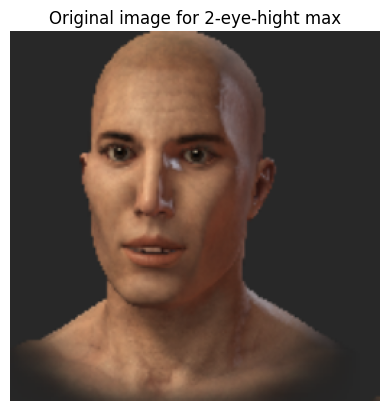

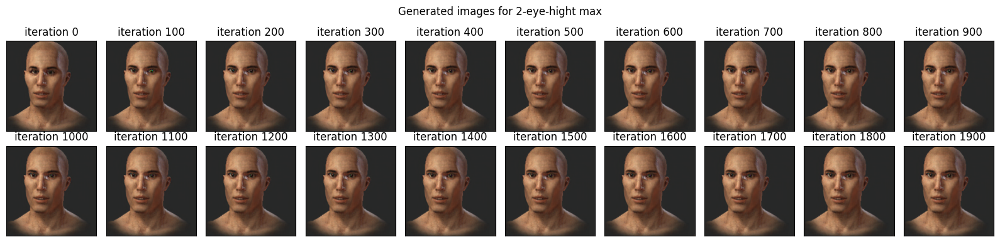

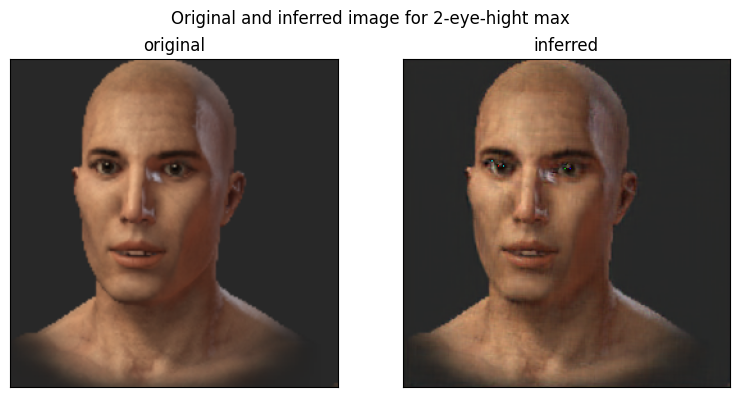

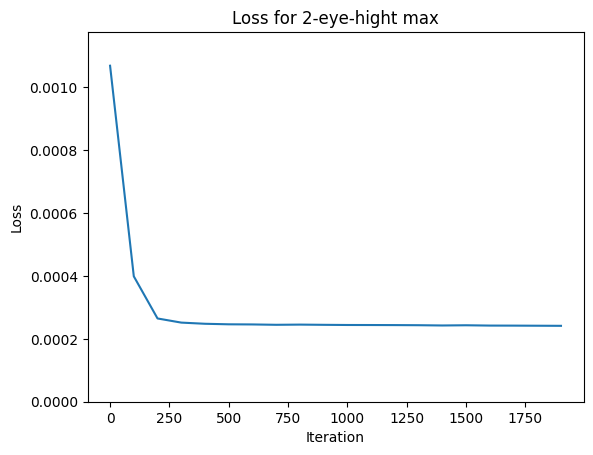

-----------------------------------
Parameter: 3-eye-angle min
Searching for z...
Iteration: 0, loss: 6.60E-04
Iteration: 100, loss: 6.15E-04
Iteration: 200, loss: 6.11E-04
Iteration: 300, loss: 6.10E-04
Iteration: 400, loss: 6.10E-04
Iteration: 500, loss: 6.10E-04
Iteration: 600, loss: 6.09E-04
Iteration: 700, loss: 6.09E-04
Iteration: 800, loss: 6.10E-04
Iteration: 900, loss: 6.09E-04
Iteration: 1000, loss: 6.09E-04
Iteration: 1100, loss: 6.08E-04
Iteration: 1200, loss: 6.08E-04
Iteration: 1300, loss: 6.08E-04
Iteration: 1400, loss: 6.08E-04
Iteration: 1500, loss: 6.07E-04
Iteration: 1600, loss: 6.06E-04
Iteration: 1700, loss: 6.06E-04
Iteration: 1800, loss: 6.06E-04
Iteration: 1900, loss: 6.05E-04
Plotting results...


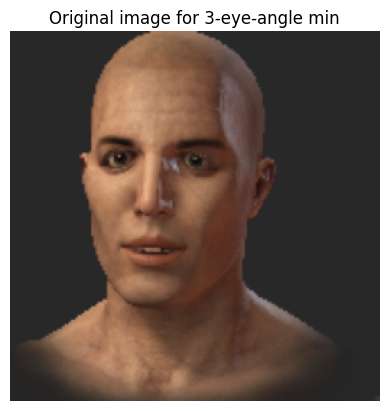

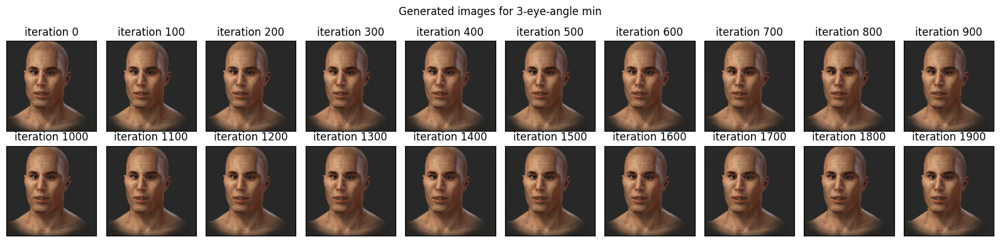

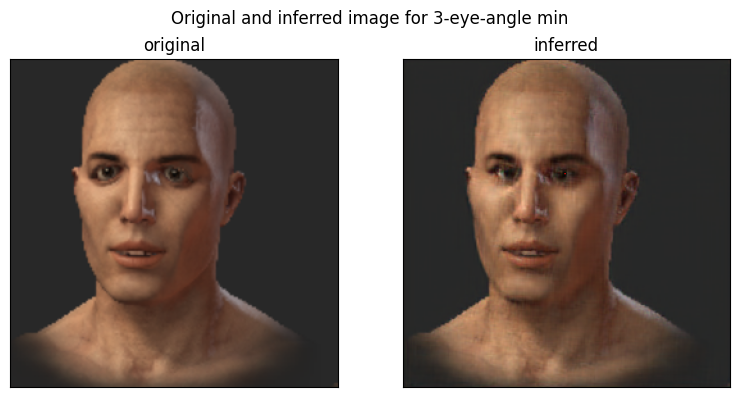

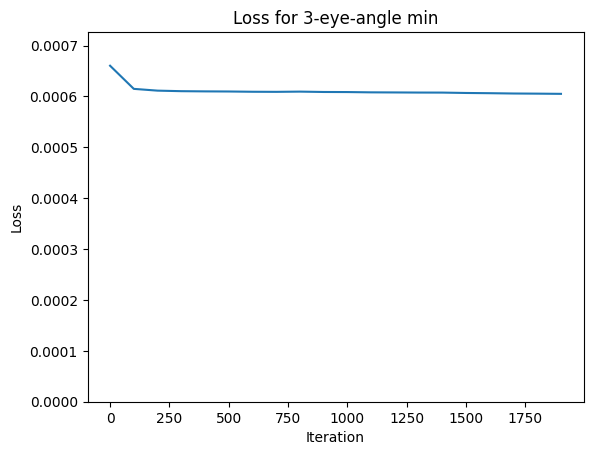

-----------------------------------
Parameter: 3-eye-angle max
Searching for z...
Iteration: 0, loss: 1.31E-03
Iteration: 100, loss: 6.43E-04
Iteration: 200, loss: 5.07E-04
Iteration: 300, loss: 4.10E-04
Iteration: 400, loss: 3.70E-04
Iteration: 500, loss: 3.53E-04
Iteration: 600, loss: 3.42E-04
Iteration: 700, loss: 3.37E-04
Iteration: 800, loss: 3.35E-04
Iteration: 900, loss: 3.34E-04
Iteration: 1000, loss: 3.34E-04
Iteration: 1100, loss: 3.33E-04
Iteration: 1200, loss: 3.33E-04
Iteration: 1300, loss: 3.33E-04
Iteration: 1400, loss: 3.33E-04
Iteration: 1500, loss: 3.33E-04
Iteration: 1600, loss: 3.33E-04
Iteration: 1700, loss: 3.33E-04
Iteration: 1800, loss: 3.33E-04
Iteration: 1900, loss: 3.32E-04
Plotting results...


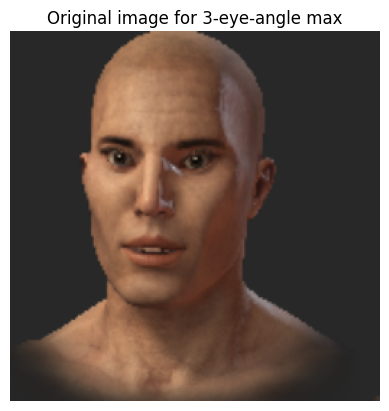

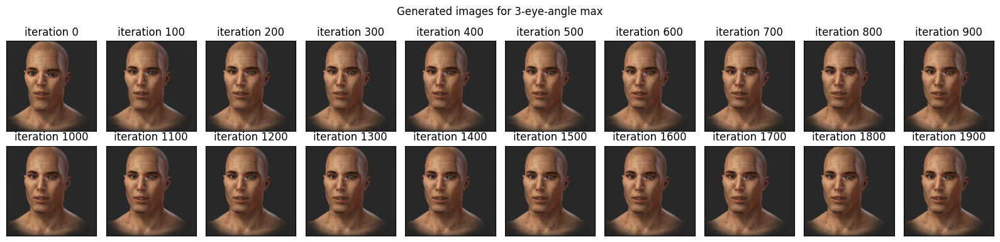

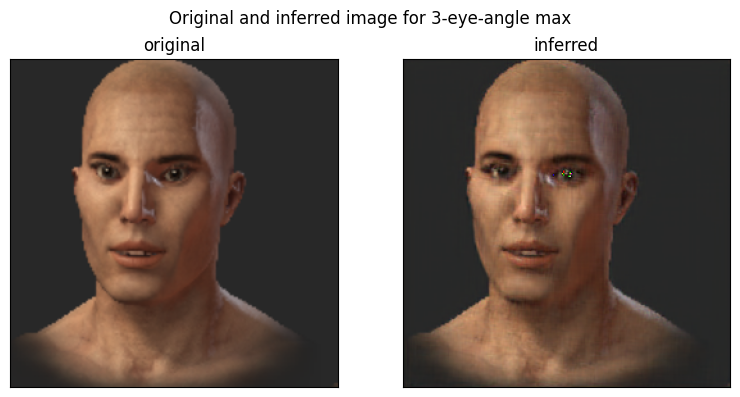

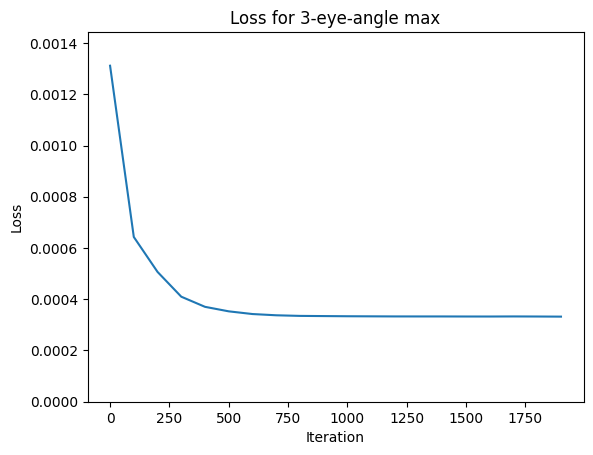

-----------------------------------
Parameter: 4-jaw-width min
Searching for z...
Iteration: 0, loss: 9.84E-04
Iteration: 100, loss: 6.84E-04
Iteration: 200, loss: 6.79E-04
Iteration: 300, loss: 6.75E-04
Iteration: 400, loss: 6.69E-04
Iteration: 500, loss: 6.61E-04
Iteration: 600, loss: 6.47E-04
Iteration: 700, loss: 6.25E-04
Iteration: 800, loss: 5.90E-04
Iteration: 900, loss: 5.48E-04
Iteration: 1000, loss: 5.03E-04
Iteration: 1100, loss: 4.32E-04
Iteration: 1200, loss: 3.71E-04
Iteration: 1300, loss: 3.32E-04
Iteration: 1400, loss: 2.86E-04
Iteration: 1500, loss: 2.56E-04
Iteration: 1600, loss: 2.53E-04
Iteration: 1700, loss: 2.52E-04
Iteration: 1800, loss: 2.52E-04
Iteration: 1900, loss: 2.52E-04
Plotting results...


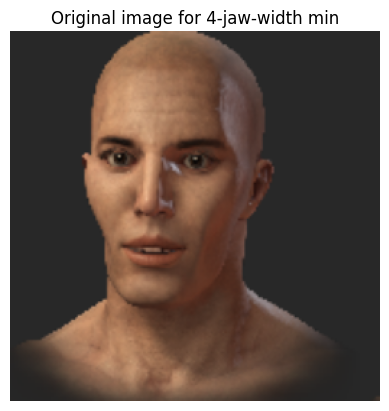

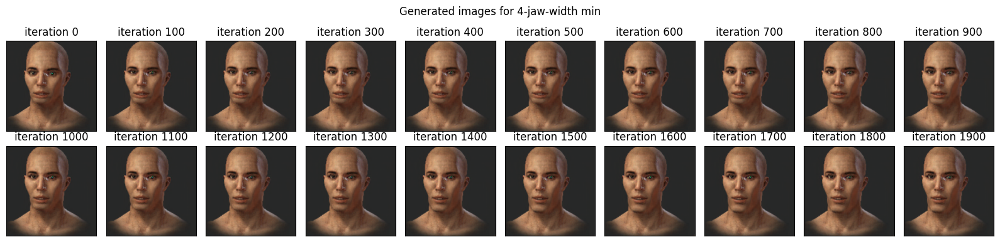

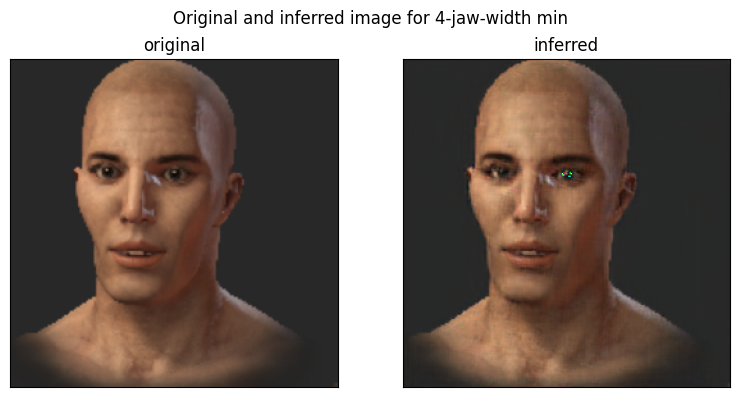

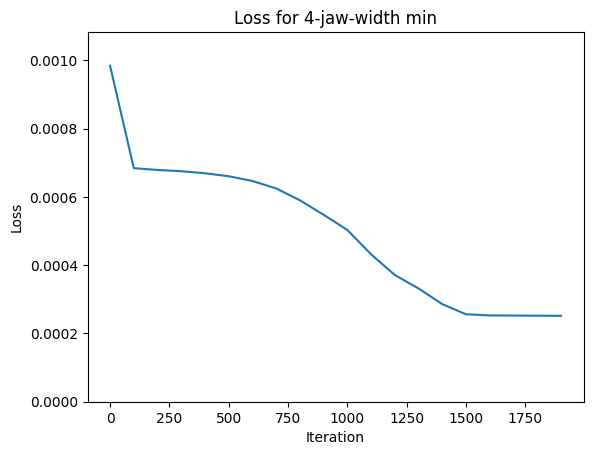

-----------------------------------
Parameter: 4-jaw-width max
Searching for z...
Iteration: 0, loss: 3.85E-04
Iteration: 100, loss: 3.24E-04
Iteration: 200, loss: 2.95E-04
Iteration: 300, loss: 2.89E-04
Iteration: 400, loss: 2.87E-04
Iteration: 500, loss: 2.85E-04
Iteration: 600, loss: 2.84E-04
Iteration: 700, loss: 2.83E-04
Iteration: 800, loss: 2.83E-04
Iteration: 900, loss: 2.81E-04
Iteration: 1000, loss: 2.82E-04
Iteration: 1100, loss: 2.81E-04
Iteration: 1200, loss: 2.80E-04
Iteration: 1300, loss: 2.80E-04
Iteration: 1400, loss: 2.79E-04
Iteration: 1500, loss: 2.79E-04
Iteration: 1600, loss: 2.78E-04
Iteration: 1700, loss: 2.78E-04
Iteration: 1800, loss: 2.78E-04
Iteration: 1900, loss: 2.78E-04
Plotting results...


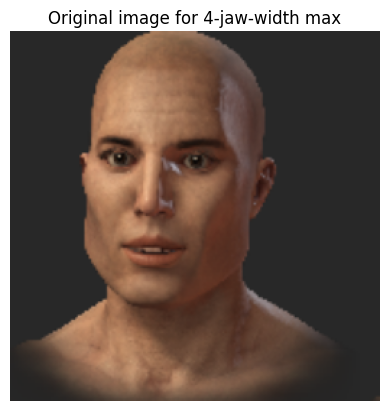

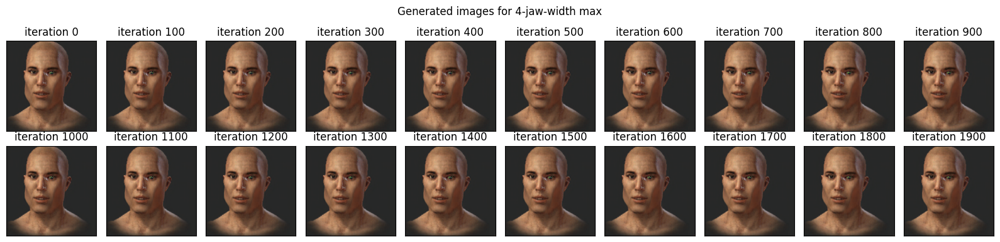

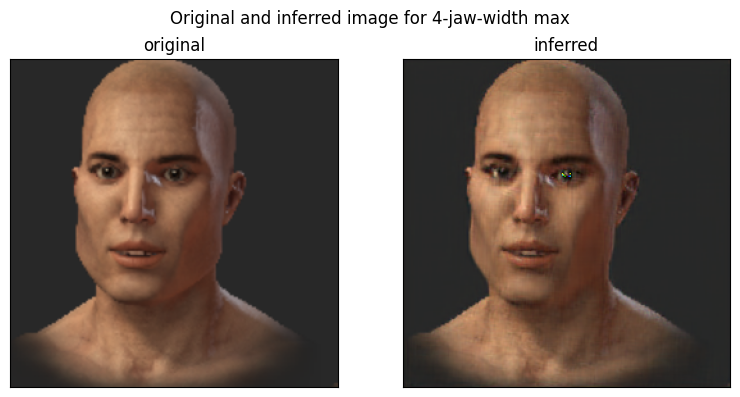

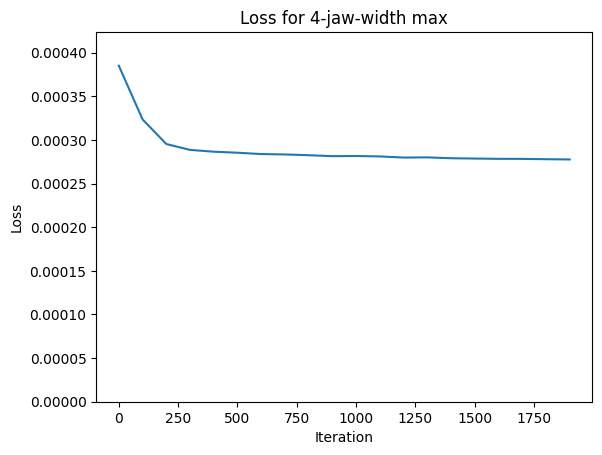

-----------------------------------
Parameter: 5-jaw-height min
Searching for z...
Iteration: 0, loss: 1.16E-03
Iteration: 100, loss: 6.38E-04
Iteration: 200, loss: 5.58E-04
Iteration: 300, loss: 5.42E-04
Iteration: 400, loss: 5.39E-04
Iteration: 500, loss: 5.37E-04
Iteration: 600, loss: 5.36E-04
Iteration: 700, loss: 5.34E-04
Iteration: 800, loss: 5.33E-04
Iteration: 900, loss: 5.33E-04
Iteration: 1000, loss: 5.32E-04
Iteration: 1100, loss: 5.31E-04
Iteration: 1200, loss: 5.31E-04
Iteration: 1300, loss: 5.30E-04
Iteration: 1400, loss: 5.29E-04
Iteration: 1500, loss: 5.29E-04
Iteration: 1600, loss: 5.29E-04
Iteration: 1700, loss: 5.28E-04
Iteration: 1800, loss: 5.28E-04
Iteration: 1900, loss: 5.28E-04
Plotting results...


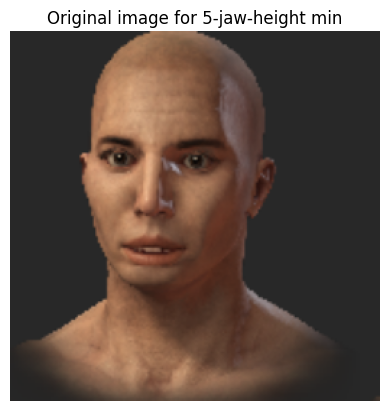

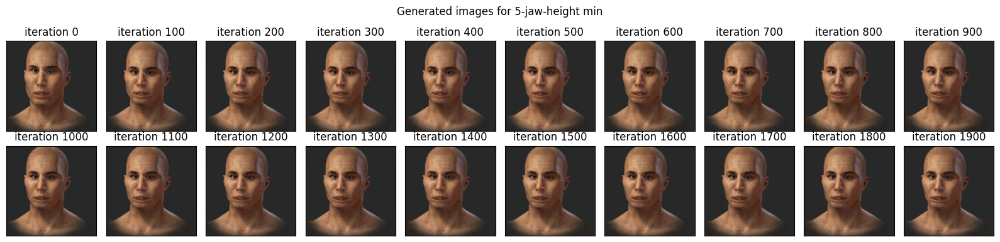

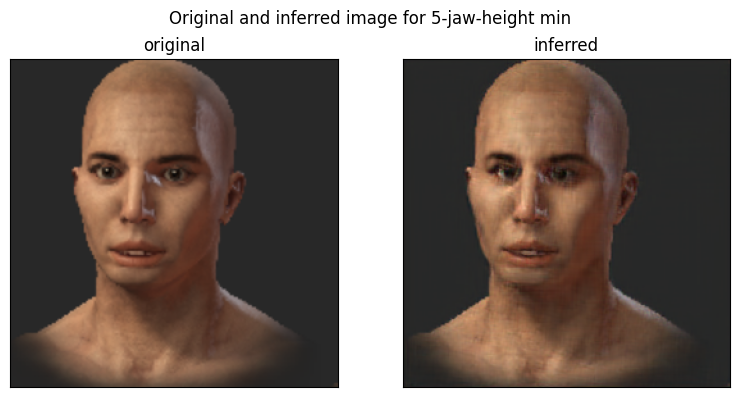

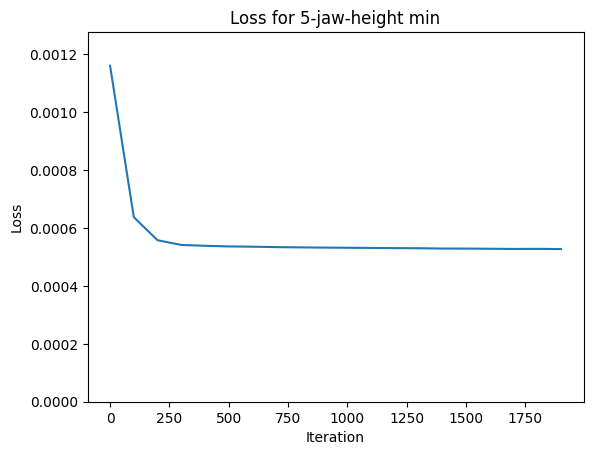

-----------------------------------
Parameter: 5-jaw-height max
Searching for z...
Iteration: 0, loss: 1.11E-03
Iteration: 100, loss: 8.36E-04
Iteration: 200, loss: 7.67E-04
Iteration: 300, loss: 6.84E-04
Iteration: 400, loss: 6.07E-04
Iteration: 500, loss: 5.58E-04
Iteration: 600, loss: 5.41E-04
Iteration: 700, loss: 5.34E-04
Iteration: 800, loss: 5.31E-04
Iteration: 900, loss: 5.29E-04
Iteration: 1000, loss: 5.28E-04
Iteration: 1100, loss: 5.27E-04
Iteration: 1200, loss: 5.26E-04
Iteration: 1300, loss: 5.25E-04
Iteration: 1400, loss: 5.25E-04
Iteration: 1500, loss: 5.24E-04
Iteration: 1600, loss: 5.24E-04
Iteration: 1700, loss: 5.23E-04
Iteration: 1800, loss: 5.23E-04
Iteration: 1900, loss: 5.23E-04
Plotting results...


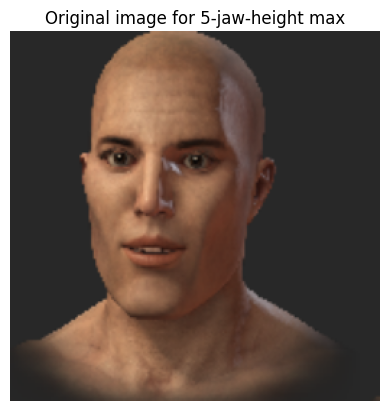

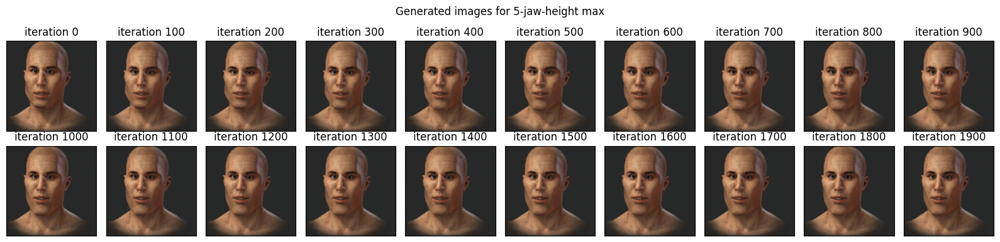

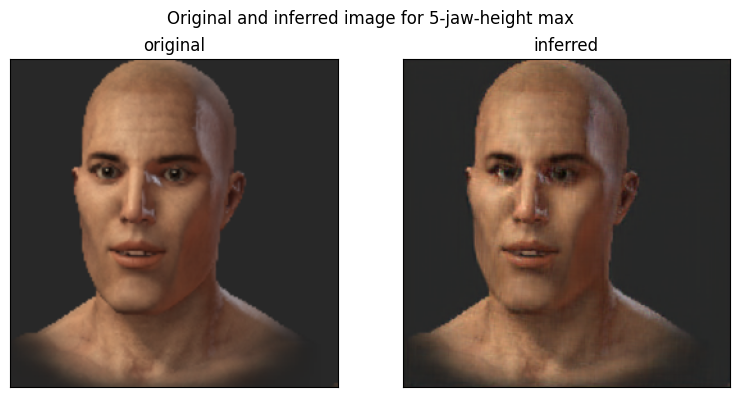

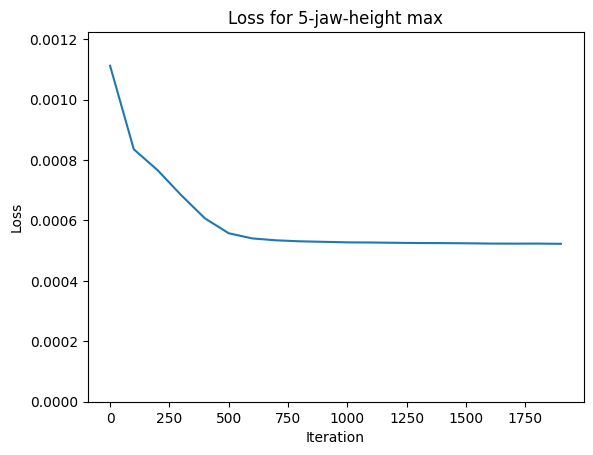

-----------------------------------


In [ ]:
for param_name, real_image_tensor in zip(param_names, min_and_max_image_tensors):
    prepare_plots_per_param(param_name, real_image_tensor, generator=generator_9000, lr=1, iterations=500)

##### Maaaany iterations from middle
(Unsuccessful)

Parameter: 1-eye-distance min
Searching for z...
Iteration: 0, loss: 6.05E-04
Iteration: 100, loss: 6.06E-04
Iteration: 200, loss: 6.05E-04
Iteration: 300, loss: 6.06E-04
Iteration: 400, loss: 6.06E-04
Iteration: 500, loss: 6.06E-04
Iteration: 600, loss: 6.06E-04
Iteration: 700, loss: 6.06E-04
Iteration: 800, loss: 6.05E-04
Iteration: 900, loss: 6.06E-04
Iteration: 1000, loss: 6.06E-04
Iteration: 1100, loss: 6.06E-04
Iteration: 1200, loss: 6.06E-04
Iteration: 1300, loss: 6.06E-04
Iteration: 1400, loss: 6.06E-04
Iteration: 1500, loss: 6.06E-04
Iteration: 1600, loss: 6.06E-04
Iteration: 1700, loss: 6.06E-04
Iteration: 1800, loss: 6.05E-04
Iteration: 1900, loss: 6.06E-04
Iteration: 2000, loss: 6.06E-04
Iteration: 2100, loss: 6.06E-04
Iteration: 2200, loss: 6.05E-04
Iteration: 2300, loss: 6.06E-04
Iteration: 2400, loss: 6.06E-04
Iteration: 2500, loss: 6.06E-04
Iteration: 2600, loss: 6.06E-04
Iteration: 2700, loss: 6.06E-04
Iteration: 2800, loss: 6.06E-04
Iteration: 2900, loss: 6.06E-04
Ite

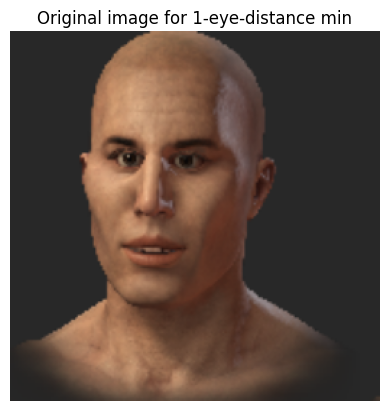

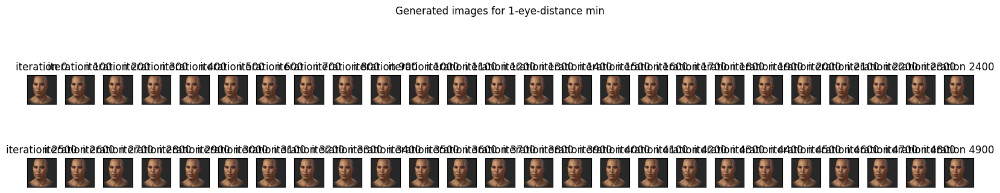

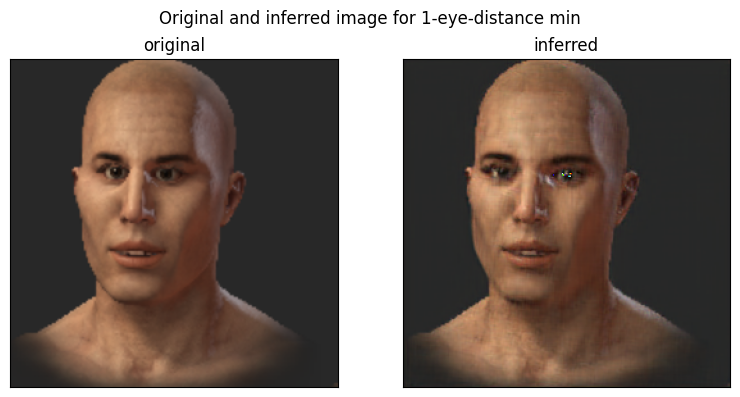

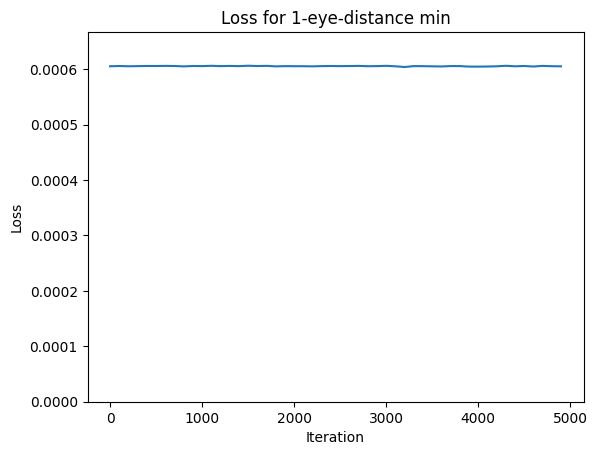

-----------------------------------
Parameter: 1-eye-distance max
Searching for z...
Iteration: 0, loss: 4.79E-04
Iteration: 100, loss: 4.79E-04
Iteration: 200, loss: 4.79E-04
Iteration: 300, loss: 4.77E-04
Iteration: 400, loss: 4.79E-04
Iteration: 500, loss: 4.79E-04
Iteration: 600, loss: 4.79E-04
Iteration: 700, loss: 4.78E-04
Iteration: 800, loss: 4.79E-04
Iteration: 900, loss: 4.78E-04
Iteration: 1000, loss: 4.78E-04
Iteration: 1100, loss: 4.78E-04
Iteration: 1200, loss: 4.78E-04
Iteration: 1300, loss: 4.78E-04
Iteration: 1400, loss: 4.78E-04
Iteration: 1500, loss: 4.80E-04
Iteration: 1600, loss: 4.78E-04
Iteration: 1700, loss: 4.79E-04
Iteration: 1800, loss: 4.79E-04
Iteration: 1900, loss: 4.79E-04
Iteration: 2000, loss: 4.78E-04
Iteration: 2100, loss: 4.79E-04
Iteration: 2200, loss: 4.78E-04
Iteration: 2300, loss: 4.78E-04
Iteration: 2400, loss: 4.79E-04
Iteration: 2500, loss: 4.77E-04
Iteration: 2600, loss: 4.79E-04
Iteration: 2700, loss: 4.79E-04
Iteration: 2800, loss: 4.79E-04

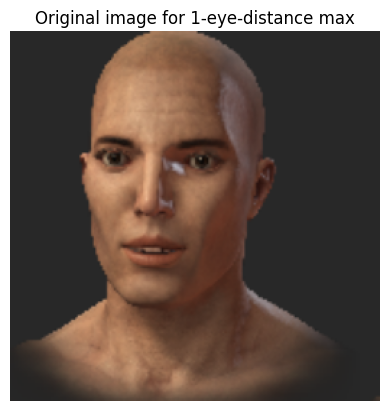

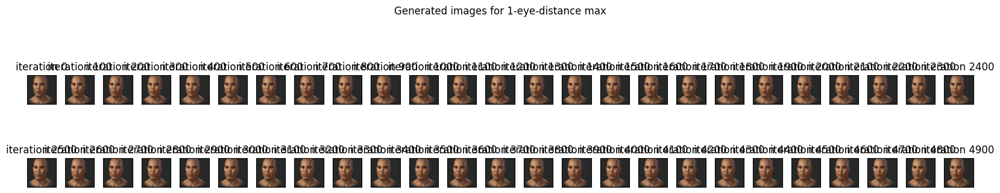

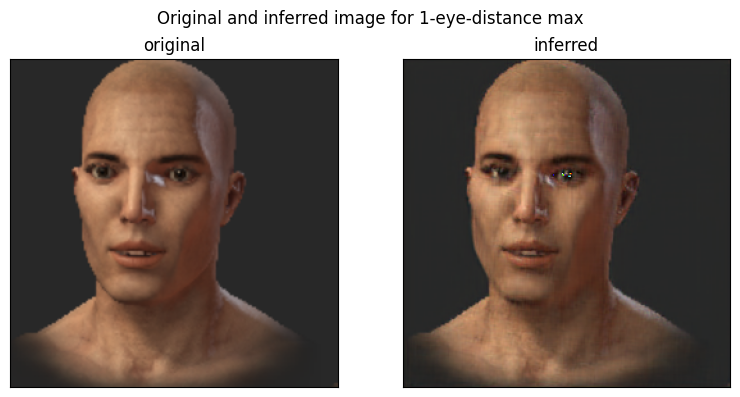

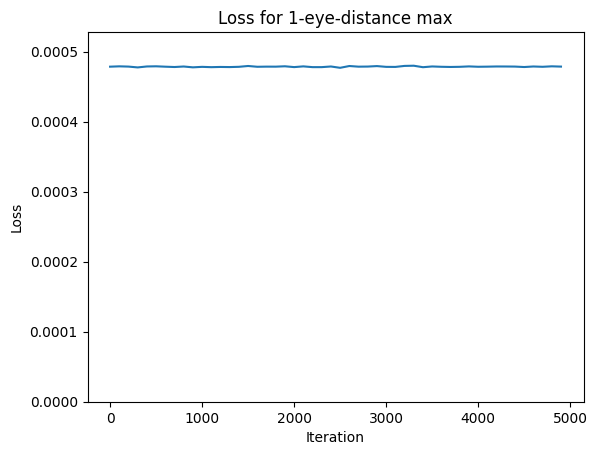

-----------------------------------
Parameter: 2-eye-hight min
Searching for z...
Iteration: 0, loss: 1.52E-03
Iteration: 100, loss: 1.52E-03
Iteration: 200, loss: 1.52E-03
Iteration: 300, loss: 1.52E-03
Iteration: 400, loss: 1.52E-03
Iteration: 500, loss: 1.51E-03
Iteration: 600, loss: 1.51E-03
Iteration: 700, loss: 1.51E-03
Iteration: 800, loss: 1.52E-03
Iteration: 900, loss: 1.52E-03
Iteration: 1000, loss: 1.52E-03
Iteration: 1100, loss: 1.52E-03
Iteration: 1200, loss: 1.52E-03
Iteration: 1300, loss: 1.52E-03
Iteration: 1400, loss: 1.52E-03
Iteration: 1500, loss: 1.52E-03
Iteration: 1600, loss: 1.51E-03
Iteration: 1700, loss: 1.52E-03
Iteration: 1800, loss: 1.52E-03
Iteration: 1900, loss: 1.52E-03
Iteration: 2000, loss: 1.52E-03
Iteration: 2100, loss: 1.52E-03
Iteration: 2200, loss: 1.51E-03
Iteration: 2300, loss: 1.51E-03
Iteration: 2400, loss: 1.52E-03
Iteration: 2500, loss: 1.52E-03
Iteration: 2600, loss: 1.52E-03
Iteration: 2700, loss: 1.52E-03
Iteration: 2800, loss: 1.51E-03
It

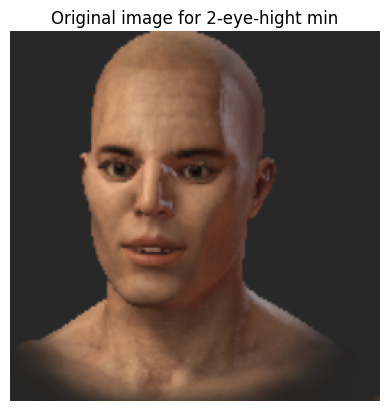

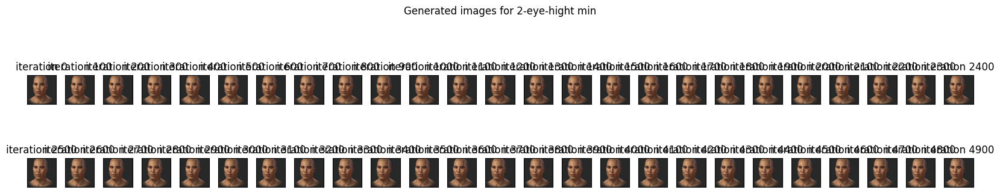

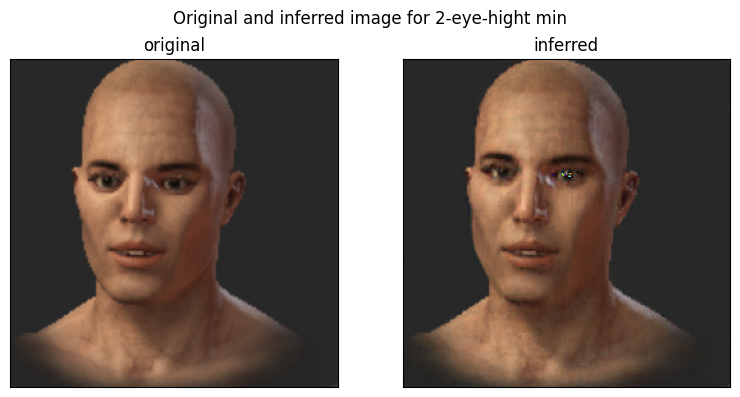

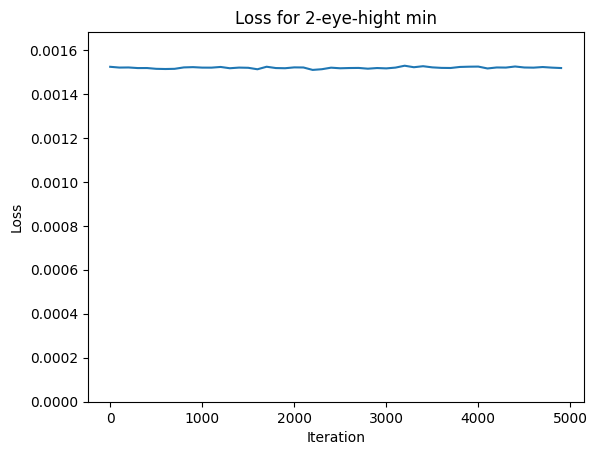

-----------------------------------
Parameter: 2-eye-hight max
Searching for z...
Iteration: 0, loss: 8.80E-04
Iteration: 100, loss: 8.84E-04
Iteration: 200, loss: 8.81E-04
Iteration: 300, loss: 8.81E-04
Iteration: 400, loss: 8.87E-04
Iteration: 500, loss: 8.83E-04
Iteration: 600, loss: 8.86E-04
Iteration: 700, loss: 8.83E-04
Iteration: 800, loss: 8.81E-04
Iteration: 900, loss: 8.82E-04
Iteration: 1000, loss: 8.86E-04
Iteration: 1100, loss: 8.86E-04
Iteration: 1200, loss: 8.83E-04
Iteration: 1300, loss: 8.83E-04
Iteration: 1400, loss: 8.82E-04
Iteration: 1500, loss: 8.81E-04
Iteration: 1600, loss: 8.76E-04
Iteration: 1700, loss: 8.82E-04
Iteration: 1800, loss: 8.84E-04
Iteration: 1900, loss: 8.86E-04
Iteration: 2000, loss: 8.84E-04
Iteration: 2100, loss: 8.85E-04
Iteration: 2200, loss: 8.83E-04
Iteration: 2300, loss: 8.85E-04
Iteration: 2400, loss: 8.85E-04
Iteration: 2500, loss: 8.81E-04
Iteration: 2600, loss: 8.81E-04
Iteration: 2700, loss: 8.79E-04
Iteration: 2800, loss: 8.84E-04
It

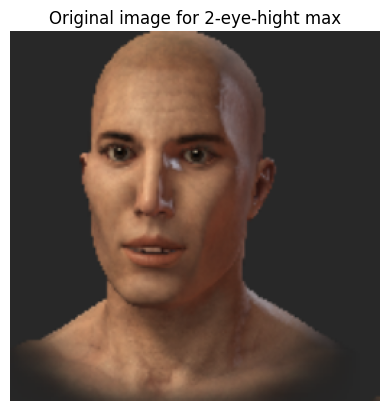

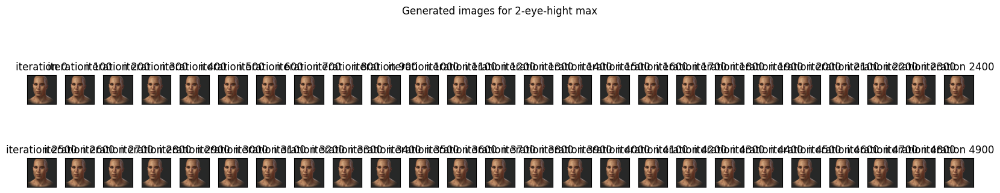

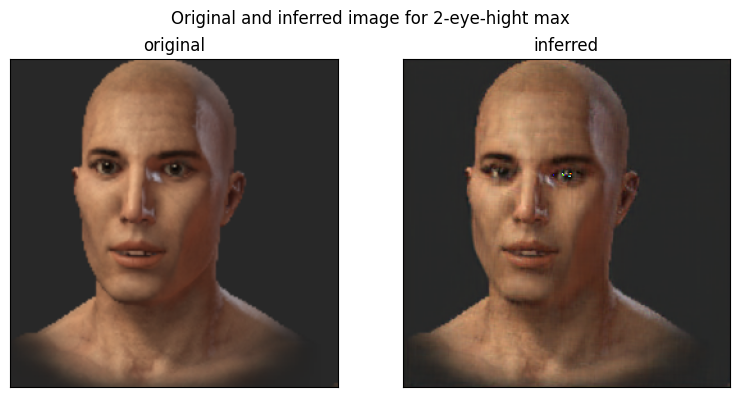

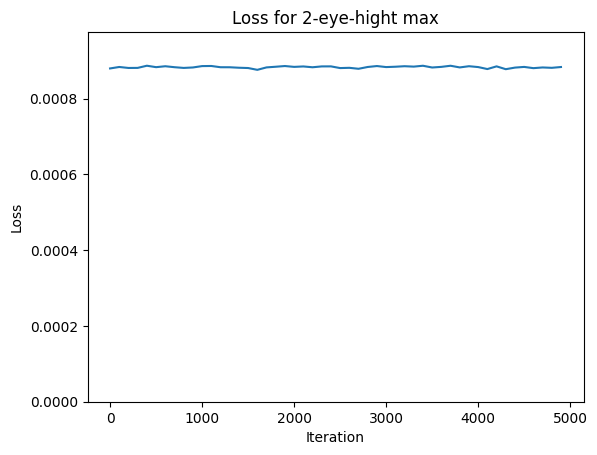

-----------------------------------
Parameter: 3-eye-angle min
Searching for z...
Iteration: 0, loss: 4.15E-04
Iteration: 100, loss: 4.18E-04
Iteration: 200, loss: 4.15E-04
Iteration: 300, loss: 4.14E-04
Iteration: 400, loss: 4.13E-04
Iteration: 500, loss: 4.15E-04
Iteration: 600, loss: 4.15E-04
Iteration: 700, loss: 4.16E-04
Iteration: 800, loss: 4.14E-04
Iteration: 900, loss: 4.14E-04
Iteration: 1000, loss: 4.14E-04
Iteration: 1100, loss: 4.16E-04
Iteration: 1200, loss: 4.15E-04
Iteration: 1300, loss: 4.13E-04
Iteration: 1400, loss: 4.15E-04
Iteration: 1500, loss: 4.15E-04
Iteration: 1600, loss: 4.15E-04
Iteration: 1700, loss: 4.16E-04
Iteration: 1800, loss: 4.14E-04
Iteration: 1900, loss: 4.16E-04
Iteration: 2000, loss: 4.14E-04
Iteration: 2100, loss: 4.16E-04
Iteration: 2200, loss: 4.16E-04
Iteration: 2300, loss: 4.15E-04
Iteration: 2400, loss: 4.14E-04
Iteration: 2500, loss: 4.14E-04
Iteration: 2600, loss: 4.15E-04
Iteration: 2700, loss: 4.16E-04
Iteration: 2800, loss: 4.15E-04
It

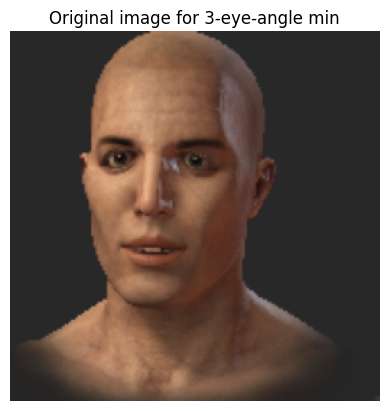

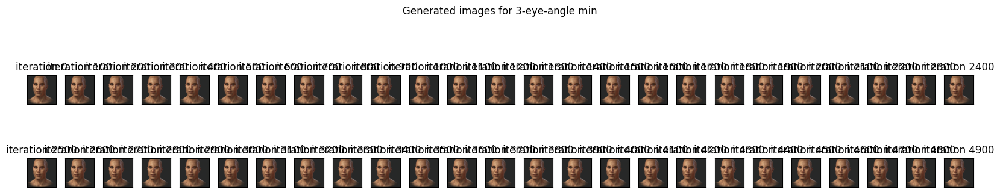

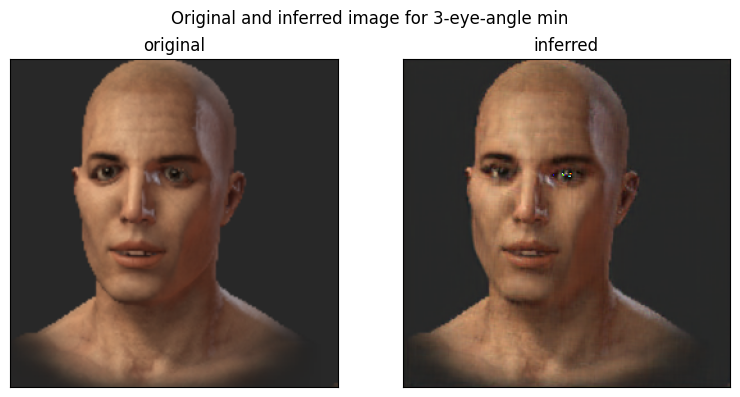

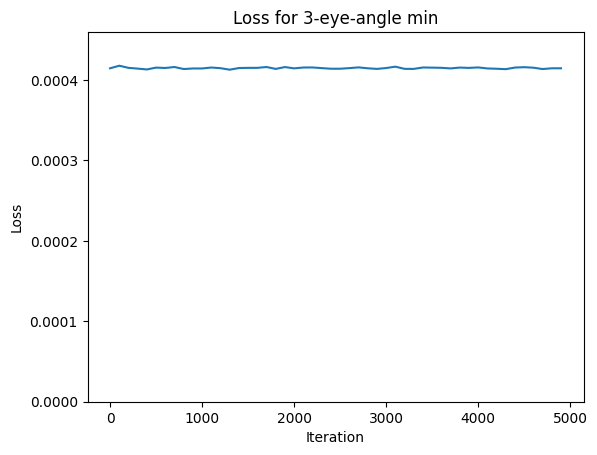

-----------------------------------
Parameter: 3-eye-angle max
Searching for z...
Iteration: 0, loss: 3.74E-04
Iteration: 100, loss: 3.75E-04
Iteration: 200, loss: 3.74E-04
Iteration: 300, loss: 3.74E-04
Iteration: 400, loss: 3.74E-04
Iteration: 500, loss: 3.75E-04
Iteration: 600, loss: 3.74E-04
Iteration: 700, loss: 3.75E-04
Iteration: 800, loss: 3.74E-04
Iteration: 900, loss: 3.75E-04
Iteration: 1000, loss: 3.75E-04
Iteration: 1100, loss: 3.75E-04
Iteration: 1200, loss: 3.74E-04
Iteration: 1300, loss: 3.74E-04
Iteration: 1400, loss: 3.74E-04
Iteration: 1500, loss: 3.74E-04
Iteration: 1600, loss: 3.74E-04
Iteration: 1700, loss: 3.75E-04
Iteration: 1800, loss: 3.75E-04
Iteration: 1900, loss: 3.74E-04
Iteration: 2000, loss: 3.75E-04
Iteration: 2100, loss: 3.75E-04
Iteration: 2200, loss: 3.74E-04
Iteration: 2300, loss: 3.75E-04
Iteration: 2400, loss: 3.75E-04
Iteration: 2500, loss: 3.75E-04
Iteration: 2600, loss: 3.74E-04
Iteration: 2700, loss: 3.74E-04
Iteration: 2800, loss: 3.75E-04
It

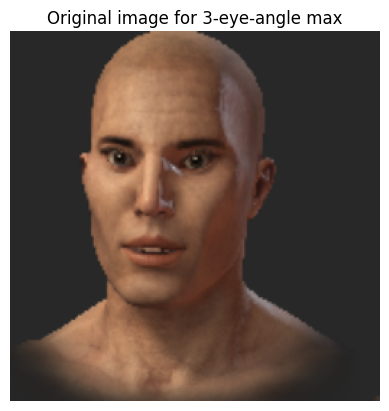

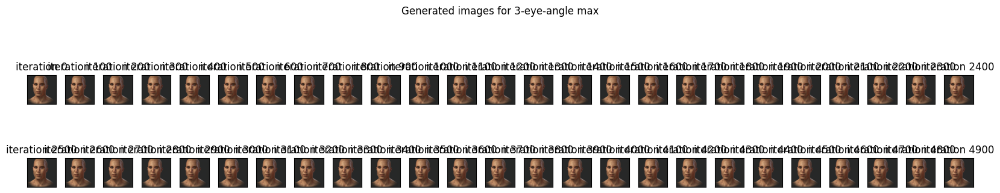

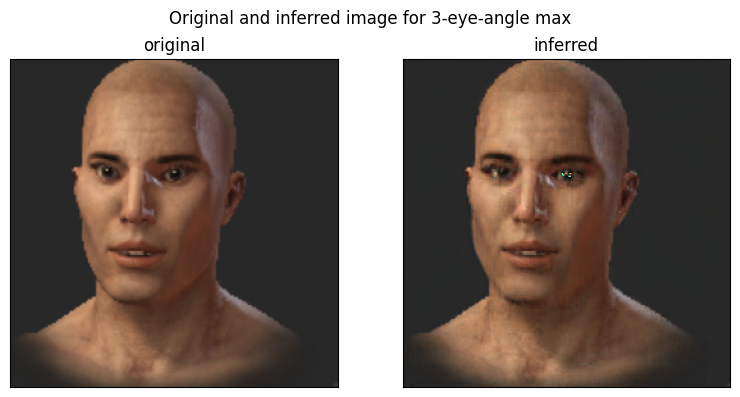

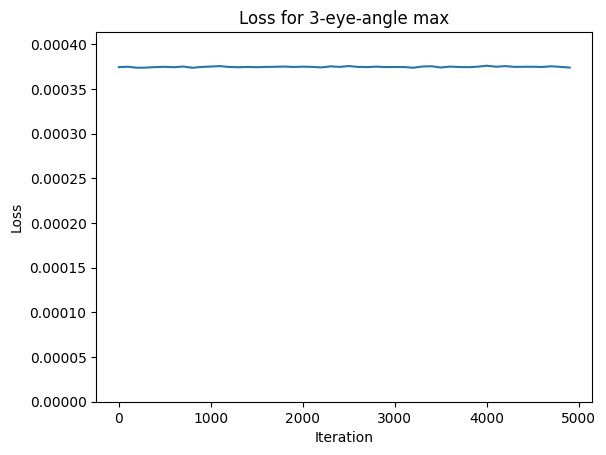

-----------------------------------
Parameter: 4-jaw-width min
Searching for z...
Iteration: 0, loss: 6.11E-04
Iteration: 100, loss: 6.11E-04
Iteration: 200, loss: 6.11E-04
Iteration: 300, loss: 6.12E-04
Iteration: 400, loss: 6.11E-04
Iteration: 500, loss: 6.11E-04
Iteration: 600, loss: 6.12E-04
Iteration: 700, loss: 6.12E-04
Iteration: 800, loss: 6.11E-04
Iteration: 900, loss: 6.13E-04
Iteration: 1000, loss: 6.12E-04
Iteration: 1100, loss: 6.12E-04
Iteration: 1200, loss: 6.11E-04
Iteration: 1300, loss: 6.11E-04
Iteration: 1400, loss: 6.12E-04
Iteration: 1500, loss: 6.11E-04
Iteration: 1600, loss: 6.12E-04
Iteration: 1700, loss: 6.11E-04
Iteration: 1800, loss: 6.12E-04
Iteration: 1900, loss: 6.12E-04
Iteration: 2000, loss: 6.11E-04
Iteration: 2100, loss: 6.12E-04
Iteration: 2200, loss: 6.11E-04
Iteration: 2300, loss: 6.13E-04
Iteration: 2400, loss: 6.12E-04
Iteration: 2500, loss: 6.12E-04
Iteration: 2600, loss: 6.12E-04
Iteration: 2700, loss: 6.12E-04
Iteration: 2800, loss: 6.11E-04
It

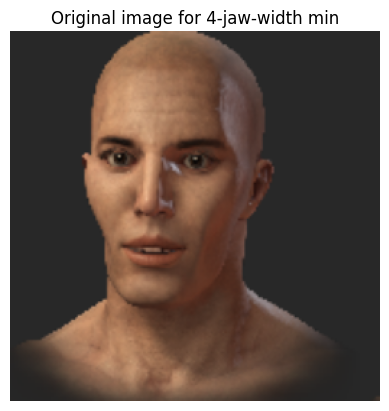

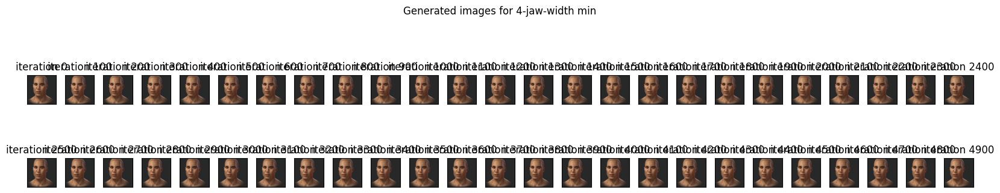

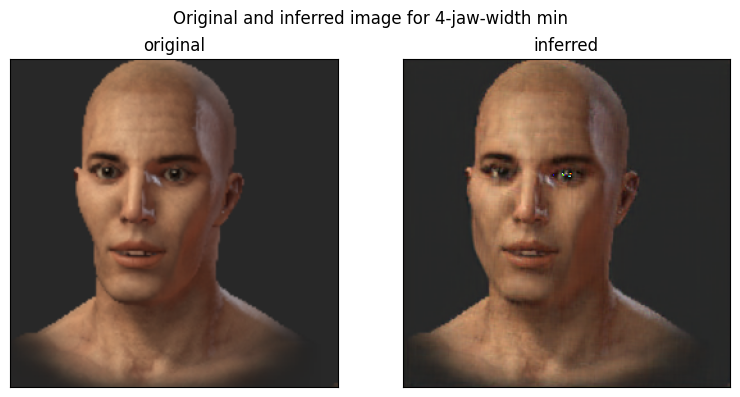

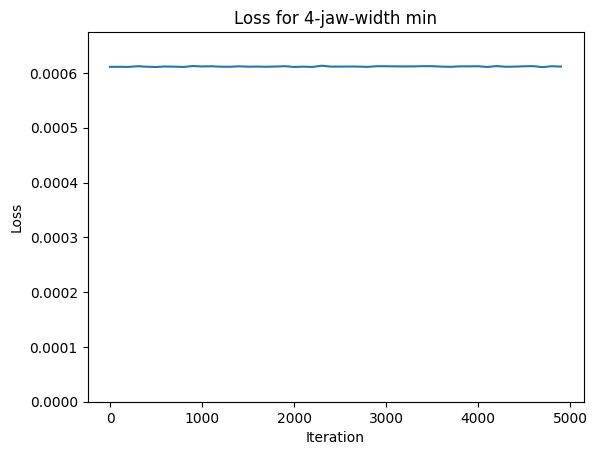

-----------------------------------
Parameter: 4-jaw-width max
Searching for z...
Iteration: 0, loss: 4.33E-04
Iteration: 100, loss: 4.34E-04
Iteration: 200, loss: 4.34E-04
Iteration: 300, loss: 4.34E-04
Iteration: 400, loss: 4.34E-04
Iteration: 500, loss: 4.34E-04
Iteration: 600, loss: 4.33E-04
Iteration: 700, loss: 4.34E-04
Iteration: 800, loss: 4.34E-04
Iteration: 900, loss: 4.34E-04
Iteration: 1000, loss: 4.34E-04
Iteration: 1100, loss: 4.34E-04
Iteration: 1200, loss: 4.34E-04
Iteration: 1300, loss: 4.33E-04
Iteration: 1400, loss: 4.34E-04
Iteration: 1500, loss: 4.33E-04
Iteration: 1600, loss: 4.35E-04
Iteration: 1700, loss: 4.34E-04
Iteration: 1800, loss: 4.33E-04
Iteration: 1900, loss: 4.34E-04
Iteration: 2000, loss: 4.34E-04
Iteration: 2100, loss: 4.34E-04
Iteration: 2200, loss: 4.33E-04
Iteration: 2300, loss: 4.34E-04
Iteration: 2400, loss: 4.35E-04
Iteration: 2500, loss: 4.34E-04
Iteration: 2600, loss: 4.34E-04
Iteration: 2700, loss: 4.34E-04
Iteration: 2800, loss: 4.34E-04
It

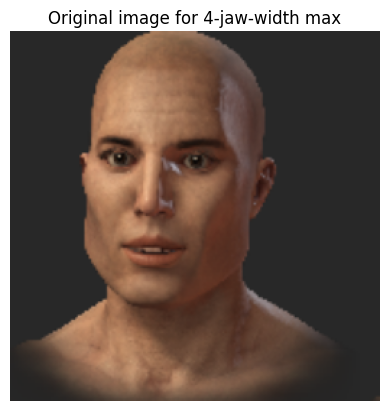

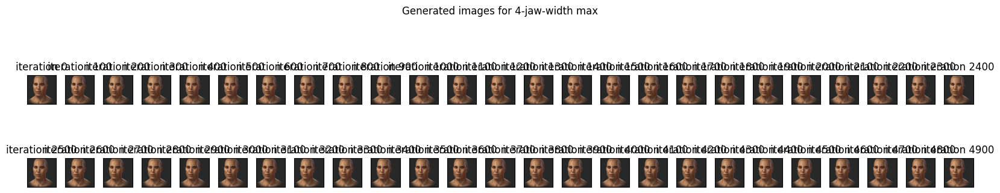

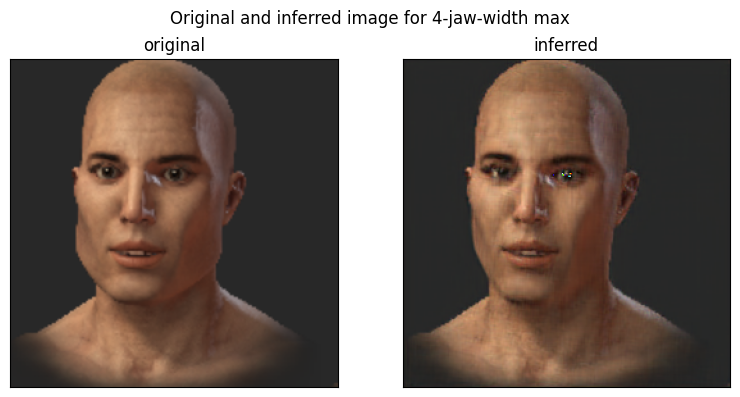

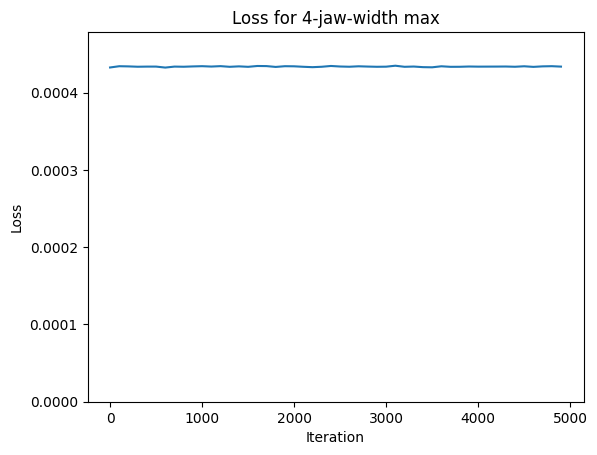

-----------------------------------
Parameter: 5-jaw-height min
Searching for z...
Iteration: 0, loss: 1.01E-03
Iteration: 100, loss: 1.01E-03
Iteration: 200, loss: 1.01E-03
Iteration: 300, loss: 1.01E-03
Iteration: 400, loss: 1.01E-03
Iteration: 500, loss: 1.01E-03
Iteration: 600, loss: 1.01E-03
Iteration: 700, loss: 1.01E-03
Iteration: 800, loss: 1.01E-03
Iteration: 900, loss: 1.01E-03
Iteration: 1000, loss: 1.01E-03
Iteration: 1100, loss: 1.01E-03
Iteration: 1200, loss: 1.01E-03
Iteration: 1300, loss: 1.01E-03
Iteration: 1400, loss: 1.01E-03
Iteration: 1500, loss: 1.01E-03
Iteration: 1600, loss: 1.01E-03
Iteration: 1700, loss: 1.01E-03
Iteration: 1800, loss: 1.01E-03
Iteration: 1900, loss: 1.01E-03
Iteration: 2000, loss: 1.01E-03
Iteration: 2100, loss: 1.01E-03
Iteration: 2200, loss: 1.01E-03
Iteration: 2300, loss: 1.01E-03
Iteration: 2400, loss: 1.01E-03
Iteration: 2500, loss: 1.01E-03
Iteration: 2600, loss: 1.01E-03
Iteration: 2700, loss: 1.01E-03
Iteration: 2800, loss: 1.01E-03
I

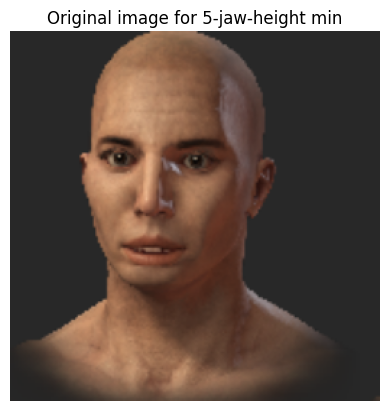

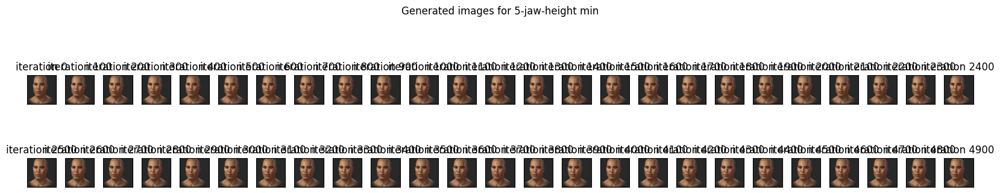

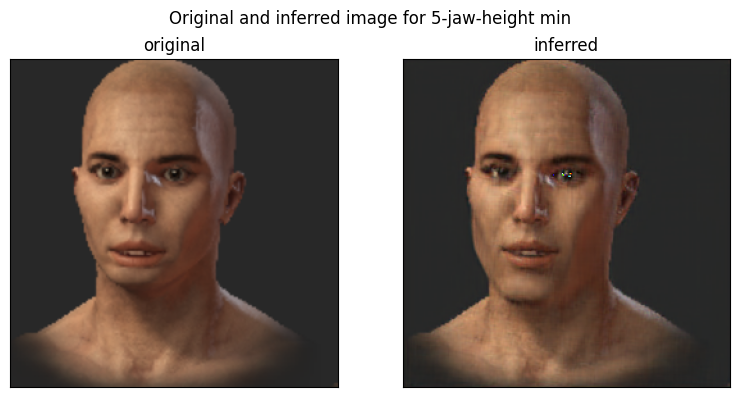

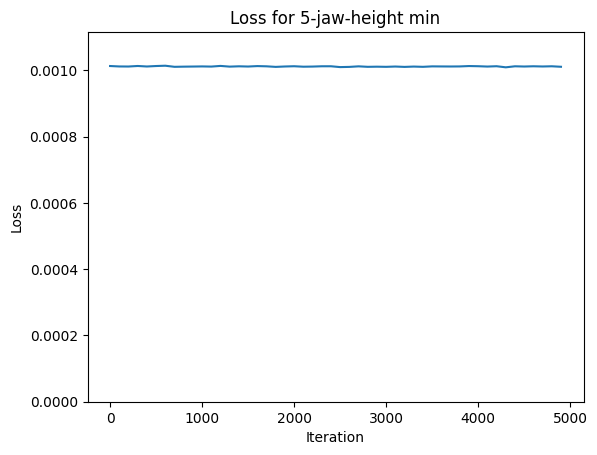

-----------------------------------
Parameter: 5-jaw-height max
Searching for z...
Iteration: 0, loss: 5.73E-04
Iteration: 100, loss: 5.74E-04
Iteration: 200, loss: 5.75E-04
Iteration: 300, loss: 5.74E-04
Iteration: 400, loss: 5.73E-04
Iteration: 500, loss: 5.77E-04
Iteration: 600, loss: 5.73E-04
Iteration: 700, loss: 5.75E-04
Iteration: 800, loss: 5.71E-04
Iteration: 900, loss: 5.74E-04
Iteration: 1000, loss: 5.72E-04
Iteration: 1100, loss: 5.72E-04
Iteration: 1200, loss: 5.73E-04
Iteration: 1300, loss: 5.73E-04
Iteration: 1400, loss: 5.72E-04
Iteration: 1500, loss: 5.74E-04
Iteration: 1600, loss: 5.73E-04
Iteration: 1700, loss: 5.75E-04
Iteration: 1800, loss: 5.73E-04
Iteration: 1900, loss: 5.75E-04
Iteration: 2000, loss: 5.74E-04
Iteration: 2100, loss: 5.73E-04
Iteration: 2200, loss: 5.72E-04
Iteration: 2300, loss: 5.70E-04
Iteration: 2400, loss: 5.74E-04
Iteration: 2500, loss: 5.75E-04
Iteration: 2600, loss: 5.74E-04
Iteration: 2700, loss: 5.72E-04
Iteration: 2800, loss: 5.72E-04
I

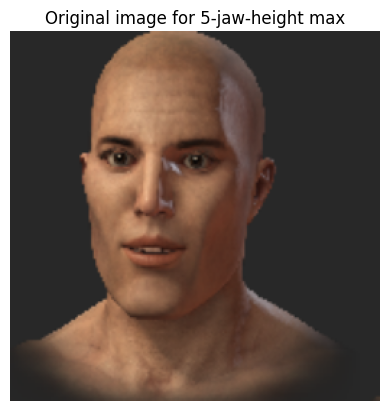

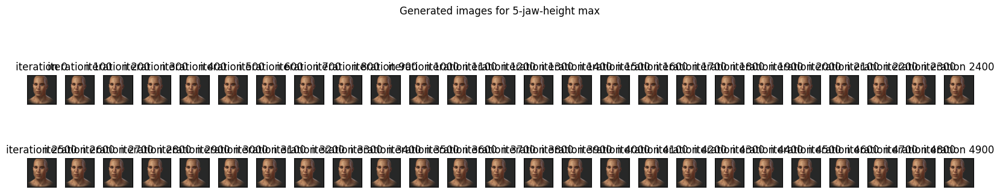

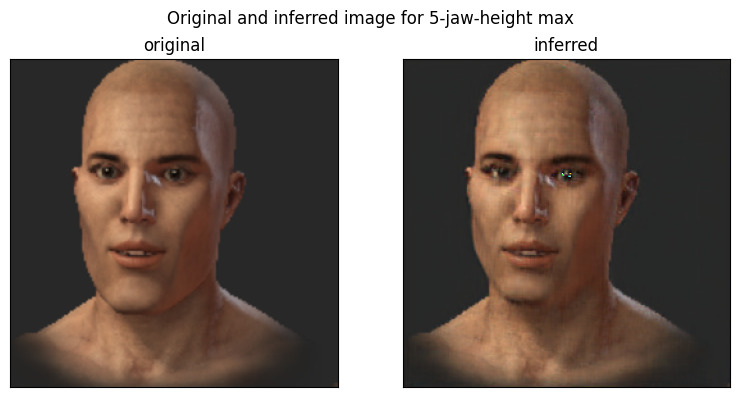

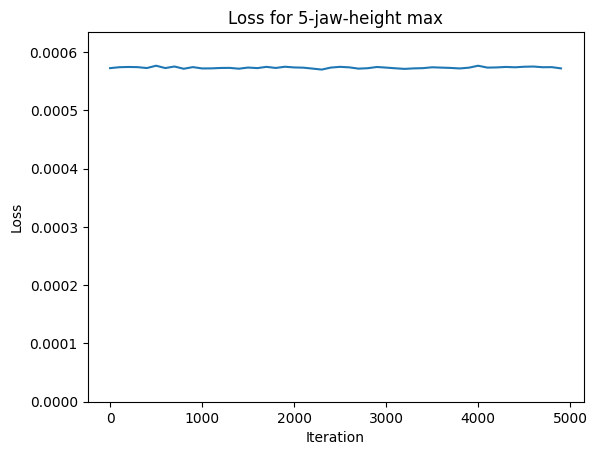

-----------------------------------


In [ ]:
for param_name, real_image_tensor in zip(param_names, min_and_max_image_tensors):
    prepare_plots_per_param(param_name, real_image_tensor, generator=generator_9000, z_init=z_init, lr=0.01, iterations=5000)

### Test na pierdolniczek

In [ ]:
def generate_intermediate_vectors(a_vec, b_vec, n):
    step_vec = (b_vec - a_vec - 1)/n
    return [ a_vec + i * step_vec for i in range(n+2)]

generate_intermediate_vectors(np.array([2,3,4]), np.array([5,6,7]), 2)

[array([2., 3., 4.]),
 array([3., 4., 5.]),
 array([4., 5., 6.]),
 array([5., 6., 7.])]

In [ ]:
def pierdolniczek_test(param_name, generator, n, iterations=500):
    PATH = Path("img/from_dataset/parameters")
    min_image_path = PATH / param_name / "min.png"
    max_image_path = PATH / param_name / "max.png"
    min_image, max_image = prep_image(min_image_path), prep_image(max_image_path)
    
    a_vec = find_z(min_image, generator, iterations=iterations, lr=1, checkpoint_step=100)[0]
    b_vec = find_z(max_image, generator, iterations=iterations, lr=1, checkpoint_step=100)[0]
    # a_vec, b_vec = np.array([[2] for _ in range(256)]).T, np.array([[5] for _ in range(256)]).T
    intermediate_vectors = generate_intermediate_vectors(a_vec, b_vec, n)
    
    images = [prep_tensor_to_show(generator(z)[0]) for z in intermediate_vectors]
    labels = list(range(1, n+2))
    plot_images(images, labels, nrows=1, ncols=n+1, title=f"Generated images for {param_name}", figsize=[8, 4])

Iteration: 0, loss: 7.04E-04
Iteration: 100, loss: 6.04E-04
Iteration: 200, loss: 5.70E-04
Iteration: 0, loss: 9.07E-04
Iteration: 100, loss: 8.16E-04
Iteration: 200, loss: 6.98E-04


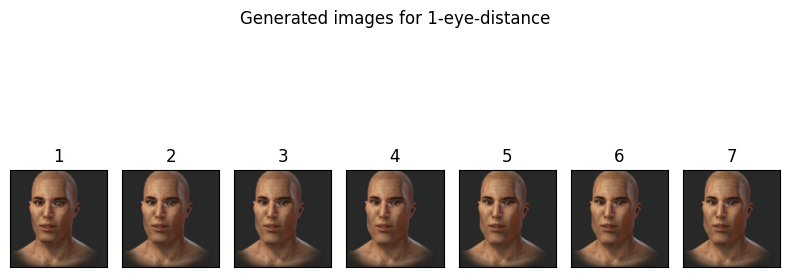

In [ ]:
pierdolniczek_test("1-eye-distance", generator=generator_9000, n=6)

Iteration: 0, loss: 1.18E-03
Iteration: 100, loss: 3.73E-04
Iteration: 200, loss: 3.28E-04
Iteration: 0, loss: 1.34E-03
Iteration: 100, loss: 7.70E-04
Iteration: 200, loss: 6.07E-04


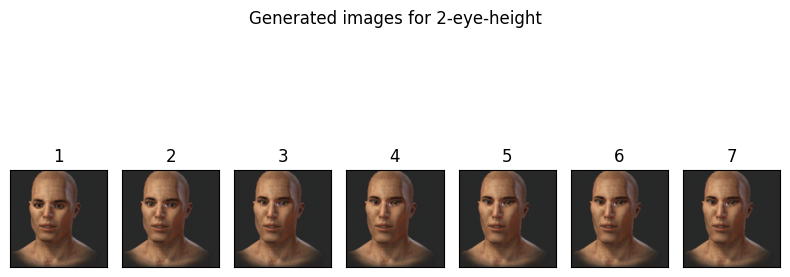

In [ ]:
pierdolniczek_test("2-eye-height", generator=generator_9000, n=6)

Iteration: 0, loss: 1.05E-03
Iteration: 100, loss: 6.37E-04
Iteration: 200, loss: 6.26E-04
Iteration: 0, loss: 1.10E-03
Iteration: 100, loss: 1.08E-03
Iteration: 200, loss: 1.07E-03


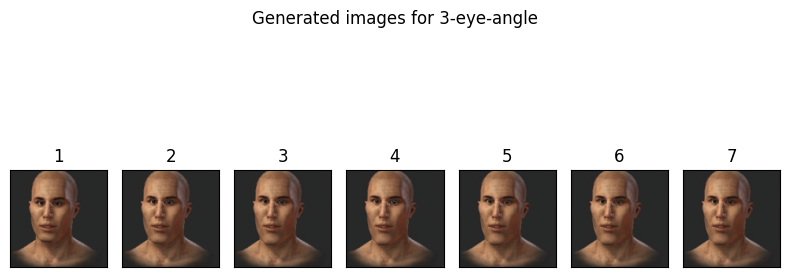

In [ ]:
pierdolniczek_test("3-eye-angle", generator=generator_9000, n=6)

Iteration: 0, loss: 1.10E-03
Iteration: 100, loss: 1.07E-03
Iteration: 200, loss: 1.04E-03
Iteration: 300, loss: 1.00E-03
Iteration: 400, loss: 9.73E-04
Iteration: 0, loss: 3.94E-04
Iteration: 100, loss: 3.46E-04
Iteration: 200, loss: 3.06E-04
Iteration: 300, loss: 2.81E-04
Iteration: 400, loss: 2.76E-04


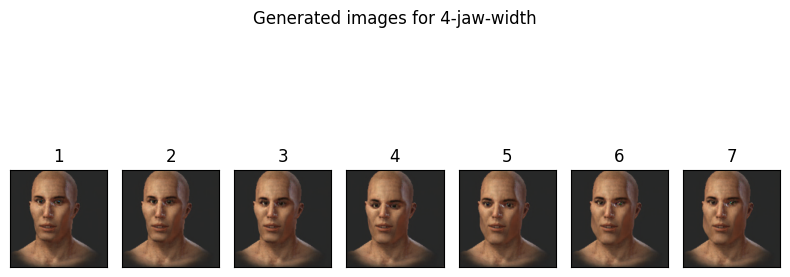

In [ ]:
pierdolniczek_test("4-jaw-width", generator=generator_9000, n=6)

Iteration: 0, loss: 1.58E-03
Iteration: 100, loss: 6.78E-04
Iteration: 200, loss: 5.92E-04
Iteration: 0, loss: 1.36E-03
Iteration: 100, loss: 7.29E-04
Iteration: 200, loss: 7.14E-04


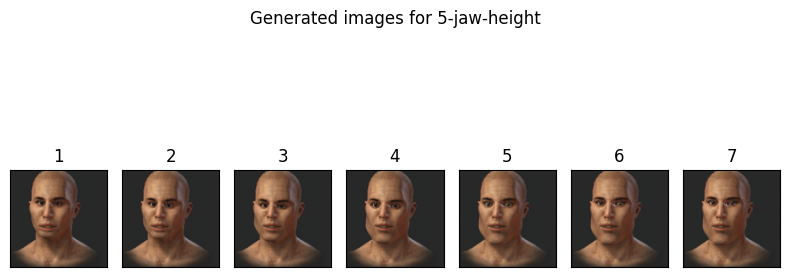

In [ ]:
pierdolniczek_test("5-jaw-height", generator=generator_9000, n=6)